# **Section A** - Environment Building and Database Processing

**A.1** Building Environment

In [ ]:
# Check nvcc version
!nvcc -V
# Check GCC version
!gcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:33:58_PDT_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0
gcc (Ubuntu 9.4.0-1ubuntu1~20.04.1) 9.4.0
Copyright (C) 2019 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [ ]:
%pwd

'/content'

In [ ]:
%cd sample_data/

/content/sample_data


In [ ]:
import sys
sys.path.append('/usr/local/lib/python3.7/site-packages/')



In [ ]:
##loading more powerful GPU
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Sun Jul  2 16:31:54 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   50C    P8     9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
!pip install ipython
!pip install ipython_genutils
!pip install matplotlib
!pip install matplotlib-base
!pip install notebook
!pip install numpy
!pip install pandas
!pip install pillow
!pip install plotly
!pip install scikit-learn
!pip install seaborn
!pip install tornado
!pip install tqdm
!pip install optuna
!pip install opencv
!pip install kornia
!pip install torchvision
!pip install torchviz

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 10.0 MB/s eta 0:00:00
ERROR: Could not find a version that satisfies the requirement matplotlib-base (from versions: none)
ERROR: No matching distribution found for matplotlib-base
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 390.6/390.6 kB 8.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.5/224.5 kB 21.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.7/78.7 kB 9.8 MB/s eta 0:00:00
ERROR: Could not find a version that satisfies the requirement opencv (from versions: none)
ERROR: No matching distribution found for opencv
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 653.4/653.4 kB 8.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for torchviz: filename=torchviz-0.0.2-py3-none-any.whl size=4131 sha256=d034d789b59e6463227332bbe0827dd604a022e89cf455f93216d76caec0ad9f
  Stored in directory: /root/.cache/pip/wheels/4c/97/88/a02973217949e0db0c9f4346d154085f4725f99c4f15a870

In [ ]:
# !pip install pytorch
!pip install scipy==1.5.2
# !pip install opencv

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 25.4/25.4 MB 48.4 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × pip subprocess to install build dependencies did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Installing build dependencies ... error
error: subprocess-exited-with-error

× pip subprocess to install build dependencies did not run successfully.
│ exit code: 1
╰─> See above for output.

note: This error originates from a subprocess, and is likely not a problem with pip.


In [ ]:
from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9

In [ ]:
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('Not using a high-RAM runtime')
else:
  print('You are using a high-RAM runtime!')

Your runtime has 13.6 gigabytes of available RAM

Not using a high-RAM runtime


In [ ]:
import torch
# Set the device to be used for evaluation
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

**A.2** Dowloading Data

In [ ]:
%pwd

'/content/sample_data'

In [ ]:
##Before you run this section you will have to upload the kaggle.jason doc into the directory path shown in the previous code line (%pwd)

! pip install kaggle

! mkdir ~/.kaggle

! cp kaggle.json ~/.kaggle/

! chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!pip install terminaltables

In [ ]:
!kaggle datasets download -d lantian773030/pokemonclassification

 99% 415M/417M [00:23<00:00, 22.7MB/s]
100% 417M/417M [00:23<00:00, 18.5MB/s]


In [ ]:
%pwd

'/content/sample_data'

In [ ]:
!unzip /content/sample_data/pokemonclassification.zip

Streaming output truncated to the last 5000 lines.
  inflating: PokemonData/Golbat/78bb8cd2828f40158fc0dcd4c0366a57.jpg  
  inflating: PokemonData/Golbat/7b7a064d3a1b4c53a9be936d4e4e3bab.jpg  
  inflating: PokemonData/Golbat/7d07fd6776fb40e9986a1a0f62233325.jpg  
  inflating: PokemonData/Golbat/815b279060b94e12a6b35d434a5250c2.jpg  
  inflating: PokemonData/Golbat/818014085ff04885b31eb5e8737012f2.jpg  
  inflating: PokemonData/Golbat/87529331a47b4a5cb5d10a6b3ea46d84.jpg  
  inflating: PokemonData/Golbat/914fab74d32e49a98940d5ba7f674fa6.jpg  
  inflating: PokemonData/Golbat/949a05bd0ad44be993e5fd89a8f582df.jpg  
  inflating: PokemonData/Golbat/9a4c793b9b0042a99ebd540897f9f898.jpg  
  inflating: PokemonData/Golbat/a35b4e8e603c485cb197520af30e1208.jpg  
  inflating: PokemonData/Golbat/a45a14a67a7348bba57c06467bb73cde.jpg  
  inflating: PokemonData/Golbat/acc2b44eada74a25a64c041b2e80c453.jpg  
  inflating: PokemonData/Golbat/af30483e382240d38890dec39e083b08.jpg  
  inflating: PokemonData/G

**A.3** Pre Processing Data

In [ ]:
# imports for the practice (you can add more if you need)
import os
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import TensorDataset, DataLoader
import torchvision
import matplotlib.pyplot as plt
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
import torchvision.transforms as transforms
# %matplotlib notebook
%matplotlib inline

seed = 211
np.random.seed(seed)
torch.manual_seed(seed)

In [ ]:
!pip install tensorflow

In [ ]:
%pwd

'/content/sample_data'

In [ ]:
##in this code we will split the data downloaded to PokemonData directory into 3 sub directories: train,test,split

import os
import random
from torchvision.datasets import ImageFolder
from torchvision.transforms import ToTensor
import shutil
from pathlib import Path

# Set the path to your dataset
data_dir = './PokemonData'
valid_image = ['.jpg', '.jpeg', '.png', '.ppm', '.bmp', '.pgm', '.tif', '.tiff', '.webp']

# Set the ratios for splitting the dataset (e.g., 70% train, 15% validation, 15% test)
train_ratio = 0.7
val_ratio = 0.15

# Create new directories to store the split datasets
train_dir = os.path.join(data_dir, "train")
val_dir = os.path.join(data_dir, "val")
test_dir = os.path.join(data_dir, "test")
os.makedirs(train_dir, exist_ok=True)
os.makedirs(val_dir, exist_ok=True)
os.makedirs(test_dir, exist_ok=True)

# Loop over each class folder in the original dataset and split the images
for class_folder in os.listdir(data_dir):
    class_folder_path = os.path.join(data_dir, class_folder)
    if os.path.isdir(class_folder_path):
        images = os.listdir(class_folder_path)
        random.shuffle(images)
        num_images = len(images)

        train_split = int(num_images * train_ratio)
        val_split = int(num_images * (train_ratio + val_ratio))

        # Create subdirectories within the train, validation, and test splits
        train_class_dir = os.path.join(train_dir, class_folder)
        val_class_dir = os.path.join(val_dir, class_folder)
        test_class_dir = os.path.join(test_dir, class_folder)
        os.makedirs(train_class_dir, exist_ok=True)
        os.makedirs(val_class_dir, exist_ok=True)
        os.makedirs(test_class_dir, exist_ok=True)

        # Move or copy images to the respective split subdirectories
        for i, image in enumerate(images):
          ext = os.path.splitext(image)[1]
          if ext.lower() not in valid_image:
            continue
          image_path = os.path.join(class_folder_path, image)
          if i < train_split:
              dest_dir = train_class_dir
          elif i < val_split:
              dest_dir = val_class_dir
          else:
              dest_dir = test_class_dir

          if os.path.isfile(image_path):
              shutil.copy(image_path, dest_dir)

In [ ]:
##remove unnecessary directories
%rm -rf './PokemonData/train/train'
%rm -rf './PokemonData/train/test'
%rm -rf './PokemonData/train/val'
%rm -rf './PokemonData/val/train'
%rm -rf './PokemonData/val/test'
%rm -rf './PokemonData/val/val'
%rm -rf './PokemonData/test/train'
%rm -rf './PokemonData/test/test'
%rm -rf './PokemonData/test/val'

In [ ]:
!mkdir checkpoints

# **Section B** - Self Supervised Approach

In this section we will offer 2 main approaches for the model architecture:
1. Pre training of - Self Supervied learning model and then transfer learning and training model.
2. transfer learning using SOTA VGG pre trained model and training it on our data.

**B.1** Building environment for using Self Supervised Learning approach

In [ ]:
!pip install lightly

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 619.7/619.7 kB 10.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 19.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 137.6/137.6 kB 17.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 721.2/721.2 kB 32.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 9.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 14.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 519.2/519.2 kB 46.9 MB/s eta 0:00:00
  Created wheel for antlr4-python3-runtime: filename=antlr4_python3_runtime-4.9.3-py3-none-any.whl size=144554 sha256=406dc4760e224a7d564ef79669c25f042b50ffe22f4b9d0cb514822e975cbd97
  Stored in directory: /root/.cache/pip/wheels/12/93/dd/1f6a127edc45659556564c5730f6d4e300888f4bca2d4c5a88
Successfully built antlr4-python3-runtime


**B.2** using BYOL as the self surpised model

BYOL

In [ ]:
# BYOL example
# https://docs.lightly.ai/self-supervised-learning/examples/byol.html
import copy

import torch
import torchvision
from torch import nn
import time

from lightly.loss import NegativeCosineSimilarity
from lightly.models.modules import BYOLPredictionHead, BYOLProjectionHead
from lightly.models.utils import deactivate_requires_grad, update_momentum
from lightly.transforms.simclr_transform import SimCLRTransform
from lightly.utils.scheduler import cosine_schedule

class BYOL(nn.Module):
    def __init__(self, backbone):
        super().__init__()

        self.backbone = backbone  # e.g., resnet
        self.projection_head = BYOLProjectionHead(512, 1024, 256)
        self.prediction_head = BYOLPredictionHead(256, 1024, 256)

        self.backbone_momentum = copy.deepcopy(self.backbone)
        self.projection_head_momentum = copy.deepcopy(self.projection_head)

        deactivate_requires_grad(self.backbone_momentum)
        deactivate_requires_grad(self.projection_head_momentum)

    def forward(self, x):
        y = self.backbone(x).flatten(start_dim=1)
        z = self.projection_head(y)
        p = self.prediction_head(z)
        return p

    def forward_momentum(self, x):
        y = self.backbone_momentum(x).flatten(start_dim=1)
        z = self.projection_head_momentum(y)
        z = z.detach()
        return z

# initialization example
resnet = torchvision.models.resnet18()
backbone = nn.Sequential(*list(resnet.children())[:-1])
model = BYOL(backbone)

device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)

transform = SimCLRTransform(input_size=32)

batch_size = 256
data_dir = './PokemonData'
image_dataset = {x: ImageFolder(os.path.join(data_dir, x),transform=transform) for x in ['train', 'val']}
dataloader = {x: DataLoader(image_dataset[x], batch_size=batch_size,
                             shuffle=True, num_workers=2, drop_last=True, ) for x in ['train', 'val']}
dataset_size = {x: len(image_dataset[x]) for x in ['train', 'val']}
class_name = image_dataset['train'].classes

In [ ]:
# calculating the loss example
criterion = NegativeCosineSimilarity()  # can also be MSE as in the original paper
optimizer = torch.optim.SGD(model.parameters(), lr=0.06)

since = time.time()

num_epochs = 500
for epoch in range(num_epochs):
    total_loss = 0
    # correct0 = 0
    # correct1 = 0
    print('Epoch {}/{}'.format(epoch, num_epochs - 1))
    momentum_val = cosine_schedule(epoch, num_epochs, 0.996, 1)
    for phase in ['train', 'val']:
      if phase == 'train':
          model.train()  # Set model to training mode
      else:
          model.eval()   # Set model to evaluate mode
      for batch,labels in dataloader[phase]:
        x0, x1 = batch
        true_labels = labels.to(device)
        # call to EMA updater
        update_momentum(model.backbone, model.backbone_momentum, m=momentum_val)
        update_momentum(model.projection_head, model.projection_head_momentum, m=momentum_val)
        x0 = x0.to(device)
        x1 = x1.to(device)
        # with torch.set_grad_enabled(phase == 'train'):
        p0 = model(x0)
        z0 = model.forward_momentum(x0)
        p1 = model(x1)
        z1 = model.forward_momentum(x1)
        loss = 0.5 * (criterion(p0, z1) + criterion(p1, z0))
        total_loss += loss.detach()

        # if phase == 'train':
        loss.backward()
        optimizer.step()
        optimizer.zero_grad()

        # Calculate accuracy
      #   predicted_labels0 = p0.argmax(dim=1)  # Assuming the model predicts class labels
      #   predicted_labels1 = p1.argmax(dim=1)
      #   correct0 += torch.sum(predicted_labels0 == true_labels.data)
      #   correct1 += torch.sum(predicted_labels1 == true_labels.data)
      #   # print(correct0+correct1)
      #   tot = len(dataloader[phase].dataset)

      # accuracy = (correct0.double() + correct1.double()) / tot

      avg_loss = total_loss / len(dataloader)
      print('{} Loss: {:.4f}'.format(phase, avg_loss))
    # save model
    if epoch % 100 == 0 or epoch ==499:
        print('==> Saving model ...')
        state = {
            'net': model.state_dict(),
            'epoch': epoch,
        }
        if not os.path.isdir('checkpoints'):
            os.mkdir('checkpoints')
        torch.save(state, './checkpoints/BYOL_ckpt.pth')


time_elapsed = time.time() - since
print('Training complete in {:.0f}m {:.0f}s'.format(time_elapsed // 60, time_elapsed % 60))
print('==> Finished Training ...')

Epoch 0/499
train Loss: -3.0368
val Loss: -3.8334
==> Saving model ...
Epoch 1/499
train Loss: -4.5066
val Loss: -5.2892
Epoch 2/499
train Loss: -4.7090
val Loss: -5.5132
Epoch 3/499
train Loss: -4.8055
val Loss: -5.6148
Epoch 4/499
train Loss: -4.8799
val Loss: -5.7048
Epoch 5/499
train Loss: -4.9151
val Loss: -5.7396
Epoch 6/499
train Loss: -4.9364
val Loss: -5.7686
Epoch 7/499
train Loss: -4.9682
val Loss: -5.8077
Epoch 8/499
train Loss: -4.9806
val Loss: -5.8199
Epoch 9/499
train Loss: -5.0037
val Loss: -5.8431
Epoch 10/499
train Loss: -5.0077
val Loss: -5.8523
Epoch 11/499
train Loss: -5.0198
val Loss: -5.8732
Epoch 12/499
train Loss: -5.0462
val Loss: -5.8900
Epoch 13/499
train Loss: -5.0510
val Loss: -5.8993
Epoch 14/499
train Loss: -5.0708
val Loss: -5.9415
Epoch 15/499
train Loss: -5.0929
val Loss: -5.9605
Epoch 16/499
train Loss: -5.1149
val Loss: -5.9832
Epoch 17/499
train Loss: -5.1307
val Loss: -6.0066
Epoch 18/499
train Loss: -5.1599
val Loss: -6.0349
Epoch 19/499
train L

**B.3** using DINO as the self surpised model

DINO

In [ ]:
# Note: The model and training settings do not follow the reference settings
# from the paper. The settings are chosen such that the example can easily be
# run on a small dataset with a single GPU.

import copy

import torch
import torchvision
from torch import nn
import time

from lightly.loss import DINOLoss
from lightly.models.modules import DINOProjectionHead
from lightly.models.utils import deactivate_requires_grad, update_momentum
from lightly.transforms.dino_transform import DINOTransform
from lightly.utils.scheduler import cosine_schedule


class DINO(torch.nn.Module):
    def __init__(self, backbone, input_dim):
        super().__init__()
        self.student_backbone = backbone
        self.student_head = DINOProjectionHead(
            input_dim, 512, 64, 2048, freeze_last_layer=1
        )
        self.teacher_backbone = copy.deepcopy(backbone)
        self.teacher_head = DINOProjectionHead(input_dim, 512, 64, 2048)
        deactivate_requires_grad(self.teacher_backbone)
        deactivate_requires_grad(self.teacher_head)

    def forward(self, x):
        y = self.student_backbone(x).flatten(start_dim=1)
        z = self.student_head(y)
        return z

    def forward_teacher(self, x):
        y = self.teacher_backbone(x).flatten(start_dim=1)
        z = self.teacher_head(y)
        return z


resnet = torchvision.models.resnet18()
backbone = nn.Sequential(*list(resnet.children())[:-1])
input_dim = 512
# instead of a resnet you can also use a vision transformer backbone as in the
# original paper (you might have to reduce the batch size in this case):
# backbone = torch.hub.load('facebookresearch/dino:main', 'dino_vits16', pretrained=False)
# input_dim = backbone.embed_dim

model = DINO(backbone, input_dim)

device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)

transform = DINOTransform()
# we ignore object detection annotations by setting target_transform to return 0
batch_size = 8
data_dir = './PokemonData'
image_dataset = {x: ImageFolder(os.path.join(data_dir, x),transform=transform,target_transform=lambda t: 0) for x in ['train', 'val']}
dataloader = {x: DataLoader(image_dataset[x], batch_size=batch_size,
                             shuffle=True, num_workers=4, drop_last=True, ) for x in ['train', 'val']}

In [ ]:
criterion = DINOLoss(
    output_dim=2048,
    warmup_teacher_temp_epochs=5,
)
# move loss to correct device because it also contains parameters
criterion = criterion.to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

epochs = 300

since = time.time()

print("Starting Training")
for epoch in range(epochs):
    total_loss = 0
    print('Epoch {}/{}'.format(epoch, epochs - 1))
    momentum_val = cosine_schedule(epoch, epochs, 0.996, 1)
    for phase in ['train', 'val']:
      # running_corrects = 0
      for batch in dataloader[phase]:
          views = batch[0]
          update_momentum(model.student_backbone, model.teacher_backbone, m=momentum_val)
          update_momentum(model.student_head, model.teacher_head, m=momentum_val)
          views = [view.to(device) for view in views]
          global_views = views[:2]
          teacher_out = [model.forward_teacher(view) for view in global_views]
          student_out = [model.forward(view) for view in views]
          loss = criterion(teacher_out, student_out, epoch=epoch)
          total_loss += loss.detach()
          loss.backward()
          # We only cancel gradients of student head.
          model.student_head.cancel_last_layer_gradients(current_epoch=epoch)
          optimizer.step()
          optimizer.zero_grad()
          # running_corrects += np.sum(teacher_out == student_out)

          # epoch_acc = running_corrects / len(dataloader[phase].dataset)

      avg_loss = total_loss / len(dataloader)
      print('{} Loss: {:.4f}'.format(phase, avg_loss))
    # save model
    if epoch % 100 == 0 or epoch ==299 :
        print('==> Saving model ...')
        state = {
            'net': model.state_dict(),
            'epoch': epoch,
        }
        if not os.path.isdir('checkpoints'):
            os.mkdir('checkpoints')
        torch.save(state, './checkpoints/DINO_ckpt.pth')

    print()

time_elapsed = time.time() - since
print('Training complete in {:.0f}m {:.0f}s'.format(time_elapsed // 60, time_elapsed % 60))
print('==> Finished Training ...')

Starting Training
Epoch 0/299
train Loss: 2005.2039


KeyboardInterrupt: ignored

**B.4** using SimCLR as the self surpised model

SimCLR

In [ ]:
# Note: The model and training settings do not follow the reference settings
# from the paper. The settings are chosen such that the example can easily be
# run on a small dataset with a single GPU.

import torch
import torchvision
from torch import nn
import time
from lightly.loss import NTXentLoss
from lightly.models.modules import SimCLRProjectionHead
from lightly.transforms.simclr_transform import SimCLRTransform


class SimCLR(nn.Module):
    def __init__(self, backbone):
        super().__init__()
        self.backbone = backbone
        self.projection_head = SimCLRProjectionHead(512, 512, 128)

    def forward(self, x):
        x = self.backbone(x).flatten(start_dim=1)
        z = self.projection_head(x)
        return z


resnet = torchvision.models.resnet18()
backbone = nn.Sequential(*list(resnet.children())[:-1])
model = SimCLR(backbone)

device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)

transform = SimCLRTransform(input_size=32, gaussian_blur=0.0)
batch_size = 256
data_dir = './PokemonData'
image_dataset = {x: ImageFolder(os.path.join(data_dir, x),transform=transform) for x in ['train', 'val']}
dataloader = {x: DataLoader(image_dataset[x], batch_size=batch_size,
                             shuffle=True, num_workers=2, drop_last=True, ) for x in ['train', 'val']}
dataset_size = {x: len(image_dataset[x]) for x in ['train', 'val']}
class_name = image_dataset['train'].classes

In [ ]:
criterion = NTXentLoss()
optimizer = torch.optim.SGD(model.parameters(), lr=0.06)

since = time.time()

epochs = 400
print("Starting Training")
for epoch in range(epochs):
    total_loss = 0
    print('Epoch {}/{}'.format(epoch, epochs - 1))
    for phase in ['train', 'val']:
      # # correct = 0
      # if phase == 'train':
      #     model.train()  # Set model to training mode
      # else:
      #     model.eval()   # Set model to evaluate mode
      # running_corrects = 0
      for batch in dataloader[phase]:
        x0, x1 = batch[0]
        x0 = x0.to(device)
        x1 = x1.to(device)
        true_labels = batch[1].to(device)
        # with torch.set_grad_enabled(phase == 'train'):
        z0 = model(x0)
        z1 = model(x1)
        _, preds0 = torch.max(z0, 1)
        _, preds1 = torch.max(z1, 1)
        loss = criterion(z0, z1)
        total_loss += loss.detach()
        # if phase == 'train':
        loss.backward()
        optimizer.step()
        optimizer.zero_grad()

        # correct += torch.sum(preds0 == true_labels.data)
        # print(correct)

      # tot = len(true_labels.data)
      # print(tot)
      # accuracy = correct.double() / tot

      avg_loss = total_loss / len(dataloader)
      print('{} Loss: {:.4f} '.format(phase, avg_loss))
    # save model
    if epoch % 100 == 0 or epoch ==399 :
        print('==> Saving model ...')
        state = {
            'net': model.state_dict(),
            'epoch': epoch,
        }
        if not os.path.isdir('checkpoints'):
            os.mkdir('checkpoints')
        torch.save(state, './checkpoints/SimCLR_ckpt.pth')


time_elapsed = time.time() - since
print('Training complete in {:.0f}m {:.0f}s'.format(time_elapsed // 60, time_elapsed % 60))
print('==> Finished Training ...')

Starting Training
Epoch 0/399
train Loss: 55.1106 
val Loss: 64.1138 
==> Saving model ...
Epoch 1/399
train Loss: 53.5127 
val Loss: 62.4245 
Epoch 2/399
train Loss: 52.8382 
val Loss: 61.6469 
Epoch 3/399
train Loss: 52.4850 
val Loss: 61.2324 
Epoch 4/399
train Loss: 52.1387 
val Loss: 60.8359 
Epoch 5/399
train Loss: 51.9087 
val Loss: 60.5267 
Epoch 6/399
train Loss: 51.6764 
val Loss: 60.2566 
Epoch 7/399
train Loss: 51.6165 
val Loss: 60.2673 
Epoch 8/399
train Loss: 51.3492 
val Loss: 59.8520 
Epoch 9/399
train Loss: 51.3267 
val Loss: 59.8941 
Epoch 10/399
train Loss: 51.2833 
val Loss: 59.8410 
Epoch 11/399
train Loss: 51.1572 
val Loss: 59.6608 
Epoch 12/399
train Loss: 51.0672 
val Loss: 59.5629 
Epoch 13/399
train Loss: 50.9162 
val Loss: 59.3690 
Epoch 14/399
train Loss: 50.7221 
val Loss: 59.2163 
Epoch 15/399
train Loss: 50.6855 
val Loss: 59.1319 
Epoch 16/399
train Loss: 50.7178 
val Loss: 59.1709 
Epoch 17/399
train Loss: 50.5745 
val Loss: 59.0188 
Epoch 18/399
trai

**B.5** using Sim Siam as the self surpised model

Sim Siam

In [ ]:
import torch
import torchvision
from torch import nn
import time
from lightly.loss import NegativeCosineSimilarity
from lightly.models.modules import SimSiamPredictionHead, SimSiamProjectionHead
from lightly.transforms import SimSiamTransform


class SimSiam(nn.Module):
    def __init__(self, backbone):
        super().__init__()
        self.backbone = backbone
        self.projection_head = SimSiamProjectionHead(512, 512, 128)
        self.prediction_head = SimSiamPredictionHead(128, 64, 128)

    def forward(self, x):
        f = self.backbone(x).flatten(start_dim=1)
        z = self.projection_head(f)
        p = self.prediction_head(z)
        z = z.detach()
        return z, p


resnet = torchvision.models.resnet18()
backbone = nn.Sequential(*list(resnet.children())[:-1])
model = SimSiam(backbone)

device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)

transform = SimSiamTransform(input_size=32)
batch_size = 256
data_dir = './PokemonData'
image_dataset = {x: ImageFolder(os.path.join(data_dir, x),transform=transform) for x in ['train', 'val']}
dataloader = {x: DataLoader(image_dataset[x], batch_size=batch_size,
                             shuffle=True, num_workers=2, drop_last=True, ) for x in ['train', 'val']}
dataset_size = {x: len(image_dataset[x]) for x in ['train', 'val']}
class_name = image_dataset['train'].classes

In [ ]:
criterion = NegativeCosineSimilarity()
optimizer = torch.optim.Adam(model.parameters(), lr=0.005)

since = time.time()
epochs = 400
print("Starting Training")
for epoch in range(epochs):
    total_loss = 0
    print('Epoch {}/{}'.format(epoch, epochs - 1))
    for phase in ['train', 'val']:
      for batch in dataloader[phase]:
        x0, x1 = batch[0]
        x0 = x0.to(device)
        x1 = x1.to(device)
        z0, p0 = model(x0)
        z1, p1 = model(x1)
        loss = 0.5 * (criterion(z0, p1) + criterion(z1, p0))
        total_loss += loss.detach()
        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
      avg_loss = total_loss / len(dataloader)
      print('{} Loss: {:.4f} '.format(phase, avg_loss))

    # save model
    if epoch % 100 == 0 or epoch ==399 :
        print('==> Saving model ...')
        state = {
            'net': model.state_dict(),
            'epoch': epoch,
        }
        if not os.path.isdir('checkpoints'):
            os.mkdir('checkpoints')
        torch.save(state, './checkpoints/SimSiam_ckpt.pth')


time_elapsed = time.time() - since
print('Training complete in {:.0f}m {:.0f}s'.format(time_elapsed // 60, time_elapsed % 60))
print('==> Finished Training ...')

Starting Training
Epoch 0/399
train Loss: -4.4645 
val Loss: -5.5666 
==> Saving model ...
Epoch 1/399
train Loss: -6.9137 
val Loss: -8.0975 
Epoch 2/399
train Loss: -7.4242 
val Loss: -8.7306 
Epoch 3/399
train Loss: -7.6195 
val Loss: -8.8892 
Epoch 4/399
train Loss: -7.6300 
val Loss: -8.9176 
Epoch 5/399
train Loss: -7.7092 
val Loss: -9.0121 
Epoch 6/399
train Loss: -7.7587 
val Loss: -9.0562 
Epoch 7/399
train Loss: -7.7787 
val Loss: -9.0946 
Epoch 8/399
train Loss: -7.9058 
val Loss: -9.1876 
Epoch 9/399
train Loss: -7.5518 
val Loss: -8.7972 
Epoch 10/399
train Loss: -7.6326 
val Loss: -8.9363 
Epoch 11/399
train Loss: -7.4599 
val Loss: -8.7534 
Epoch 12/399
train Loss: -7.6477 
val Loss: -8.8951 
Epoch 13/399
train Loss: -7.5452 
val Loss: -8.6863 
Epoch 14/399
train Loss: -6.9841 
val Loss: -8.1214 
Epoch 15/399
train Loss: -7.2454 
val Loss: -8.4739 
Epoch 16/399
train Loss: -7.1744 
val Loss: -8.2614 
Epoch 17/399
train Loss: -7.0468 
val Loss: -8.2991 
Epoch 18/399
trai

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.1848 
val Loss: -9.5313 
Epoch 325/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.1476 
val Loss: -9.5363 
Epoch 326/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.2080 
val Loss: -9.5749 
Epoch 327/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.2633 
val Loss: -9.6754 
Epoch 328/399
train Loss: -8.2514 
val Loss: -9.6429 
Epoch 329/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.1370 
val Loss: -9.4940 
Epoch 330/399
train Loss: -8.2547 
val Loss: -9.6295 
Epoch 331/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.2315 
val Loss: -9.6332 
Epoch 332/399
train Loss: -8.1131 
val Loss: -9.4625 
Epoch 333/399
train Loss: -8.1452 
val Loss: -9.5303 
Epoch 334/399
train Loss: -8.2143 
val Loss: -9.5917 
Epoch 335/399
train Loss: -8.1400 
val Loss: -9.5266 
Epoch 336/399
train Loss: -8.2085 
val Loss: -9.5886 
Epoch 337/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -7.9954 
val Loss: -9.3109 
Epoch 338/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -7.9987 
val Loss: -9.3456 
Epoch 339/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.1886 
val Loss: -9.5468 
Epoch 340/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.1946 
val Loss: -9.5531 
Epoch 341/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.2304 
val Loss: -9.5977 
Epoch 342/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.1067 
val Loss: -9.4682 
Epoch 343/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.1671 
val Loss: -9.5696 
Epoch 344/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.2164 
val Loss: -9.6283 
Epoch 345/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.1841 
val Loss: -9.5630 
Epoch 346/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.0990 
val Loss: -9.4958 
Epoch 347/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.1948 
val Loss: -9.5906 
Epoch 348/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.2137 
val Loss: -9.6053 
Epoch 349/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.2480 
val Loss: -9.6744 
Epoch 350/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.1594 
val Loss: -9.5316 
Epoch 351/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.1572 
val Loss: -9.5026 
Epoch 352/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.1545 
val Loss: -9.5210 
Epoch 353/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.0706 
val Loss: -9.4141 
Epoch 354/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.0809 
val Loss: -9.4112 
Epoch 355/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -7.9553 
val Loss: -9.2608 
Epoch 356/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.0149 
val Loss: -9.3565 
Epoch 357/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -7.9602 
val Loss: -9.2680 
Epoch 358/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>

Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Traceback (most recent call last):
      File "/usr/local/lib/python3.10/dist-packages/tor

train Loss: -8.0298 
val Loss: -9.3685 
Epoch 359/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.0470 
val Loss: -9.4240 
Epoch 360/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.1804 
val Loss: -9.5075 
Epoch 361/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.1853 
val Loss: -9.5366 
Epoch 362/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.2591 
val Loss: -9.6238 
Epoch 363/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.2273 
val Loss: -9.5822 
Epoch 364/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.2157 


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

val Loss: -9.6032 
Epoch 365/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.2794 


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    
self._shutdown_workers()  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

val Loss: -9.6212 
Epoch 366/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.0937 


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

val Loss: -9.4477 
Epoch 367/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.2187 


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

val Loss: -9.5786 
Epoch 368/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
    assert self._

train Loss: -8.1343 


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

val Loss: -9.4925 
Epoch 369/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>    self._shutdown_workers()
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__

      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError:     can only test a child process
Exception ignored in: if w.is_aliv

train Loss: -8.1181 


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

val Loss: -9.4812 
Epoch 370/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    Exception ignored in: self._shutdown_workers()
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    if w.is_alive():
      File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
self._shutdown_workers()
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
assert self._parent_pid == os.getpid(), 'can only test a child process'    if w.is_alive():
AssertionError
:   File "/usr/lib/python3.10/multiprocessing/pro

train Loss: -8.1962 


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

val Loss: -9.5206 
Epoch 371/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>

  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
Traceback (most recent call last):
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
assert self._parent_pid == os.getpid(), 'can only test a child process'    self._shutdown_workers()

AssertionError:   File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
can only test a child process    
if w.is_alive():
Exception ignored

train Loss: -8.1912 


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

val Loss: -9.5424 
Epoch 372/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.2055 


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

val Loss: -9.5391 
Epoch 373/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
Exception ignored in:     if w.is_alive():
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
assert self._parent_pid == os.getpid(), 'can only test a child process'
    AssertionErrorself._shutdown_workers(): 
can only test a child process  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers

    if w.is_alive():Exception ignored 

train Loss: -8.1711 


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

val Loss: -9.5595 
Epoch 374/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.2360 


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

val Loss: -9.5827 
Epoch 375/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
Exception ignored in: AssertionError<function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
:   File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    can only test a child processself._shutdown_workers()

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
Exception ignored in:     <function _M

train Loss: -8.2677 


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

val Loss: -9.6532 
Epoch 376/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.2494 


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

val Loss: -9.5970 
Epoch 377/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionErrorException ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>: 
can only test a child process
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train Loss: -8.2075 


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/u

val Loss: -9.5662 
Epoch 378/399


Exception ignored in: Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__

Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
        self._shutdown_workers()
if w.is_alive():  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers

  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
        assert self._parent_pid == os.getpid(), 'can only test a child process'
if w.is_alive():AssertionError: 
can only test a child process  File "/usr/lib/p

train Loss: -8.2115 


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>Exception ignored in: 
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
      File "/usr/local/lib/python3.10/dist-packages/tor

val Loss: -9.6206 
Epoch 379/399


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    Exception ignored in: self._shutdown_workers()<function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>

Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
        self._shutdown_workers()if w.is_alive():

  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
        assert self._parent_pid == os.getpid(), 'can only test a child process'if w.is_alive():

AssertionError: can only test a child process
  File "/usr/lib/

train Loss: -8.2585 


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f11970044c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

val Loss: -9.6303 
Epoch 380/399
train Loss: -8.2177 
val Loss: -9.5813 
Epoch 381/399
train Loss: -8.3220 
val Loss: -9.7012 
Epoch 382/399
train Loss: -8.2918 
val Loss: -9.6486 
Epoch 383/399
train Loss: -8.1920 
val Loss: -9.5633 
Epoch 384/399
train Loss: -8.2082 
val Loss: -9.5509 
Epoch 385/399
train Loss: -8.1625 
val Loss: -9.5186 
Epoch 386/399
train Loss: -8.1808 
val Loss: -9.5236 
Epoch 387/399
train Loss: -8.2318 
val Loss: -9.6032 
Epoch 388/399
train Loss: -8.1501 
val Loss: -9.5157 
Epoch 389/399
train Loss: -8.1794 
val Loss: -9.5589 
Epoch 390/399
train Loss: -8.1726 
val Loss: -9.5724 
Epoch 391/399
train Loss: -8.2404 
val Loss: -9.5711 
Epoch 392/399
train Loss: -8.2860 
val Loss: -9.6690 
Epoch 393/399
train Loss: -8.1905 
val Loss: -9.5734 
Epoch 394/399
train Loss: -8.1252 
val Loss: -9.5150 
Epoch 395/399
train Loss: -8.2332 
val Loss: -9.6073 
Epoch 396/399
train Loss: -8.1483 
val Loss: -9.5169 
Epoch 397/399
train Loss: -8.2678 
val Loss: -9.6651 
Epoch 398

# **Section C** - Training Techniqe Functions (***Mandatory***)

*This section is mandatory for every approach you chose*

**C.1** Functions need to be loaded before training the model

In [ ]:
import os
import imageio
import numpy as np
import tensorflow as tf
from sklearn.model_selection import train_test_split
from torch.utils.data import DataLoader, Dataset
from torchvision.datasets import ImageFolder
from torchvision import models, transforms

# Data augmentation and normalization for training
# Just normalization for validation
data_transforms = {
    'train': transforms.Compose([
        transforms.RandomResizedCrop(224),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
    'val': transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
}


In [ ]:
batch_size = 256
data_dir = './PokemonData'
image_datasets = {x: ImageFolder(os.path.join(data_dir, x), data_transforms[x]) for x in ['train', 'val']}
dataloaders = {x: DataLoader(image_datasets[x], batch_size=batch_size,
 shuffle=True, num_workers=4) for x in ['train', 'val']}
dataset_sizes = {x: len(image_datasets[x]) for x in ['train', 'val']}
class_name = image_datasets['train'].classes
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


In [ ]:
def set_parameter_requires_grad(model, feature_extracting=False):
    # approach 1
    if feature_extracting:
        # frozen model
        model.requires_grad_(False)
    else:
        # fine-tuning
        model.requires_grad_(True)

    # approach 2
    if feature_extracting:
        # frozen model
        for param in model.parameters():
            param.requires_grad = False
    else:
        # fine-tuning
        for param in model.parameters():
            param.requires_grad = True
    # note: you can also mix between frozen layers and trainable layers, but you'll need a custom
    # function that loops over the model's layers and you specify which layers are frozen.

In [ ]:
def initialize_model(model_name, num_classes, feature_extract, use_pretrained=True):
    # Initialize these variables which will be set in this if statement. Each of these
    #   variables is model specific.
    model_ft = None
    input_size = 0  # image size, e.g. (3, 224, 224)
    # new method from torchvision >= 0.13
    weigths = 'DEFAULT' if use_pretrained else None
    # to use other checkpoints than the default ones, check the model's available chekpoints here:
    # https://pytorch.org/vision/stable/models.html
    if model_name == "resnet":
        """ Resnet18
        """
        # new method from torchvision >= 0.13
        model_ft = models.resnet18(weights=weigths)
        # old method for toechvision < 0.13
        # model_ft = models.resnet18(pretrained=use_pretrained)

        set_parameter_requires_grad(model_ft, feature_extract)
        num_ftrs = model_ft.fc.in_features
        model_ft.fc = nn.Linear(num_ftrs, num_classes) # replace the last FC layer
        input_size = 614

    elif model_name == "alexnet":
        """ Alexnet
        """
        # new method from torchvision >= 0.13
        model_ft = models.alexnet(weights=weigths)
        # old method for toechvision < 0.13
        # model_ft = models.alexnet(pretrained=use_pretrained)

        set_parameter_requires_grad(model_ft, feature_extract)
        num_ftrs = model_ft.classifier[6].in_features
        model_ft.classifier[6] = nn.Linear(num_ftrs, num_classes)
        input_size = 614

    elif model_name == "vgg":
        """ VGG16
        """
        # new method from torchvision >= 0.13
        # model_ft = models.vgg16(weights=weigths)
        # old method for toechvision < 0.13
        model_ft = models.vgg16(pretrained=use_pretrained)

        set_parameter_requires_grad(model_ft, feature_extract)
        num_ftrs = model_ft.classifier[6].in_features
        model_ft.classifier[6] = nn.Linear(num_ftrs, num_classes)
        input_size = 614

    elif model_name == "squeezenet":
        """ Squeezenet
        """
        # new method from torchvision >= 0.13
        model_ft = models.squeezenet1_0(weights=weigths)
        # old method for toechvision < 0.13
        # model_ft = models.squeezenet1_0(pretrained=use_pretrained)

        set_parameter_requires_grad(model_ft, feature_extract)
        model_ft.classifier[1] = nn.Conv2d(512, num_classes, kernel_size=(1,1), stride=(1,1))
        model_ft.num_classes = num_classes
        input_size = 614

    elif model_name == "densenet":
        """ Densenet
        """
        # new method from torchvision >= 0.13
        model_ft = models.densenet121(weights=weigths)
        # old method for toechvision < 0.13
        # model_ft = models.densenet121(pretrained=use_pretrained)

        set_parameter_requires_grad(model_ft, feature_extract)
        num_ftrs = model_ft.classifier.in_features
        model_ft.classifier = nn.Linear(num_ftrs, num_classes)
        input_size = 614

    elif model_name == "byol":
        """ BYOL
        """
        # new method from torchvision >= 0.13
        # model_ft = models.vgg16(weights=weigths)
        # old method for toechvision < 0.13
        # model_ft = models.vgg16(pretrained=use_pretrained)

        resnet = torchvision.models.resnet18()
        backbone = nn.Sequential(*list(resnet.children())[:-1])
        model_ft = BYOL(backbone)

        state = torch.load('./checkpoints/BYOL_ckpt.pth', map_location=device)
        model_ft.load_state_dict(state['net'])

        set_parameter_requires_grad(model_ft, feature_extract)
        num_ftrs = model_ft.projection_head_momentum.layers[3].in_features
        model_ft.projection_head_momentum.layers[3] = nn.Linear(num_ftrs, num_classes)
        input_size = 614

    elif model_name == "dino":
        """ DINO
        """
        # new method from torchvision >= 0.13
        # model_ft = models.vgg16(weights=weigths)
        # old method for toechvision < 0.13
        # model_ft = models.vgg16(pretrained=use_pretrained)

        resnet = torchvision.models.resnet18()
        backbone = nn.Sequential(*list(resnet.children())[:-1])
        input_dim = 512
        model_ft = DINO(backbone, input_dim)

        state = torch.load('./checkpoints/DINO_ckpt.pth', map_location=device)
        model_ft.load_state_dict(state['net'])

        set_parameter_requires_grad(model_ft, feature_extract)
        num_ftrs = model_ft.classifier[6].in_features
        model_ft.classifier[6] = nn.Linear(num_ftrs, num_classes)
        input_size = 614

    elif model_name == "simclr":
        """ SimCLR
        """
        # new method from torchvision >= 0.13
        # model_ft = models.vgg16(weights=weigths)
        # old method for toechvision < 0.13
        # model_ft = models.vgg16(pretrained=use_pretrained)

        resnet = torchvision.models.resnet18()
        backbone = nn.Sequential(*list(resnet.children())[:-1])
        model_ft = SimCLR(backbone)

        state = torch.load('./checkpoints/SimCLR_ckpt.pth', map_location=device)
        model_ft.load_state_dict(state['net'])

        set_parameter_requires_grad(model_ft, feature_extract)
        num_ftrs = model_ft.projection_head.layers[3].in_features
        model_ft.projection_head.layers[3] = nn.Linear(num_ftrs, num_classes)
        model_ft.projection_head.layers[4] = nn.BatchNorm1d(150, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        input_size = 614

    elif model_name == "simsiam":
        """ SimSiam
        """
        # new method from torchvision >= 0.13
        # model_ft = models.vgg16(weights=weigths)
        # old method for toechvision < 0.13
        # model_ft = models.vgg16(pretrained=use_pretrained)

        resnet = torchvision.models.resnet18()
        backbone = nn.Sequential(*list(resnet.children())[:-1])
        model_ft = SimSiam(backbone)

        state = torch.load('./checkpoints/SimSiam_ckpt.pth', map_location=device)
        model_ft.load_state_dict(state['net'])

        set_parameter_requires_grad(model_ft, feature_extract)
        num_ftrs = model_ft.prediction_head.layers[3].in_features
        model_ft.prediction_head.layers[3] = nn.Linear(num_ftrs, num_classes)
        # model_ft.projection_head.layers[6] = nn.Linear(in_features=512, out_features=128, bias=True)
        # num_ftrs2 = model_ft.projection_head.layers[6].in_features
        # model_ft.projection_head.layers[6] = nn.Linear(num_ftrs2, num_classes)
        # model_ft.projection_head.layers[7] = nn.BatchNorm1d(150, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        input_size = 614

    else:
        raise NotImplementedError

    return model_ft, input_size

# **Section D** - Self Supervised Training Phase

*Run this section only if you chose the self supervised approach*

In [ ]:
# Models to choose from [resnet, alexnet, vgg, squeezenet, densenet, simclr, simsiam, byol, dino]
model_name = "simsiam"

# Number of classes in the dataset
num_classes = len(class_name)

# Batch size for training (change depending on how much memory you have)
batch_size = 256

# Number of epochs to train for
num_epochs = 200

# Flag for feature extracting. When False, we fine-tune the whole model,
#   when True we only update the reshaped layer params
feature_extract = True

In [ ]:
# Initialize the model for this run
model_ft, input_size = initialize_model(model_name, num_classes, feature_extract, use_pretrained=True)

# Print the model we just instantiated
print(model_ft)

SimSiam(
  (backbone): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True

In [ ]:
model_ft = model_ft.to(device)

# Gather the parameters to be optimized/updated in this run. If we are
#  fine-tuning we will be updating all parameters. However, if we are
#  doing feature extract method, we will only update the parameters
#  that we have just initialized, i.e. the parameters with requires_grad
#  is True.
params_to_update = model_ft.parameters()
print("Params to learn:")
if feature_extract:
    params_to_update = []  # override the initial list definition above
    for name,param in model_ft.named_parameters():
        if param.requires_grad == True:
            params_to_update.append(param)
            print("\t",name)
else:
    for name,param in model_ft.named_parameters():
        if param.requires_grad == True:
            print("\t",name)

# Observe that all parameters are being optimized
learning_rate = 0.001
optimizer_ft = torch.optim.Adam(params_to_update, lr=learning_rate)

Params to learn:
	 prediction_head.layers.3.weight
	 prediction_head.layers.3.bias


Training Model

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import time
import os
import copy

In [ ]:
"""
Training function
"""
def train_model(model, dataloaders, criterion, optimizer, num_epochs=25):
    since = time.time()
    Overall_val_loss = []
    Overall_train_loss = []
    Overall_train_acc = []
    val_acc_history = []

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0
            running_corrects = 0

            # Iterate over data.
            for inputs, labels in dataloaders[phase]:
                inputs = inputs.to(device)
                labels = labels.to(device)

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    # Get model outputs and calculate loss
                    outputs = model(inputs)
                    loss = criterion(outputs, labels)

                    _, preds = torch.max(outputs, 1)

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        # zero the parameter gradients
                        optimizer.zero_grad()
                        loss.backward()
                        optimizer.step()

                # statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)

            epoch_loss = running_loss / len(dataloaders[phase].dataset)
            epoch_acc = running_corrects.double() / len(dataloaders[phase].dataset)

            print('{} Loss: {:.4f} Acc: {:.4f}'.format(phase, epoch_loss, epoch_acc))

            # deep copy the model
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())
            if phase == 'val':
                val_acc_history.append(epoch_acc)
                Overall_val_loss.append(epoch_loss)
            if phase == 'train':
              Overall_train_loss.append(epoch_loss)
              Overall_train_acc.append(epoch_acc)


        print()
        # save model
        if epoch % 100 == 0 or epoch ==199 :
            print('==> Saving model ...')
            state = {
                'net': model.state_dict(),
                'epoch': epoch,
            }
            if not os.path.isdir('checkpoints'):
                os.mkdir('checkpoints')
            torch.save(state, './checkpoints/model_ckpt.pth')


    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(time_elapsed // 60, time_elapsed % 60))
    print('Best val Acc: {:4f}'.format(best_acc))

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model, val_acc_history,Overall_val_loss,Overall_train_loss,Overall_train_acc

*Note: pay attention that after you Fine-tuning and re-train the model (by running the next cell code), a checkpoint will be saved to the main directorty.*

In [ ]:
# Setup the loss fn
criterion = nn.CrossEntropyLoss()

# Train and evaluate
model_ft, hist,Overall_loss,Overall_train_loss,Overall_train_acc = train_model(model_ft, dataloaders, criterion, optimizer_ft, num_epochs=num_epochs)

Epoch 0/199
----------
train Loss: 5.0998 Acc: 0.0077
val Loss: 5.0531 Acc: 0.0059

Epoch 1/199
----------
train Loss: 5.0202 Acc: 0.0070
val Loss: 5.0332 Acc: 0.0108

Epoch 2/199
----------


KeyboardInterrupt: ignored

# **Section E** - Transfer Learning Approach

*Run this section only if you chose the transfer learning using VGG approach*

Transfering VGG model without self_supervised Pre-Training

In [ ]:
# Models to choose from [resnet, alexnet, vgg, squeezenet, densenet]
model_name = "vgg"

# Number of classes in the dataset
num_classes = len(class_name)

# Batch size for training (change depending on how much memory you have)
batch_size = 8

# Number of epochs to train for
num_epochs = 200

# Flag for feature extracting. When False, we fine-tune the whole model,
#   when True we only update the reshaped layer params
feature_extract = True

In [ ]:
# Initialize the model for this run
model_ft, input_size = initialize_model(model_name, num_classes, feature_extract, use_pretrained=True)

# Print the model we just instantiated
print(model_ft)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:02<00:00, 219MB/s]


VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

In [ ]:
model_ft = model_ft.to(device)

# Gather the parameters to be optimized/updated in this run. If we are
#  fine-tuning we will be updating all parameters. However, if we are
#  doing feature extract method, we will only update the parameters
#  that we have just initialized, i.e. the parameters with requires_grad
#  is True.
params_to_update = model_ft.parameters()
print("Params to learn:")
if feature_extract:
    params_to_update = []  # override the initial list definition above
    for name,param in model_ft.named_parameters():
        if param.requires_grad == True:
            params_to_update.append(param)
            print("\t",name)
else:
    for name,param in model_ft.named_parameters():
        if param.requires_grad == True:
            print("\t",name)

# Observe that all parameters are being optimized
optimizer_ft = torch.optim.SGD(params_to_update, lr=0.001, momentum=0.9)

Params to learn:
	 classifier.6.weight
	 classifier.6.bias


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import time
import os
import copy

In [ ]:
"""
Training function
"""
def train_model(model, dataloaders, criterion, optimizer, num_epochs=25):
    since = time.time()
    Overall_val_loss = []
    Overall_train_loss = []
    Overall_train_acc = []
    val_acc_history = []

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0
            running_corrects = 0

            # Iterate over data.
            for inputs, labels in dataloaders[phase]:
                inputs = inputs.to(device)
                labels = labels.to(device)

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    # Get model outputs and calculate loss
                    outputs = model(inputs)
                    loss = criterion(outputs, labels)

                    _, preds = torch.max(outputs, 1)

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        # zero the parameter gradients
                        optimizer.zero_grad()
                        loss.backward()
                        optimizer.step()

                # statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)

            epoch_loss = running_loss / len(dataloaders[phase].dataset)
            epoch_acc = running_corrects.double() / len(dataloaders[phase].dataset)

            print('{} Loss: {:.4f} Acc: {:.4f}'.format(phase, epoch_loss, epoch_acc))

            # deep copy the model
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())
            if phase == 'val':
                val_acc_history.append(epoch_acc)
                Overall_val_loss.append(epoch_loss)
            if phase == 'train':
              Overall_train_loss.append(epoch_loss)
              Overall_train_acc.append(epoch_acc)


        print()
        # save model
        if epoch % 100 == 0 or epoch ==199 :
            print('==> Saving model ...')
            state = {
                'net': model.state_dict(),
                'epoch': epoch,
            }
            if not os.path.isdir('checkpoints'):
                os.mkdir('checkpoints')
            torch.save(state, './checkpoints/VGG_ckpt.pth')


    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(time_elapsed // 60, time_elapsed % 60))
    print('Best val Acc: {:4f}'.format(best_acc))

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model, val_acc_history,Overall_val_loss,Overall_train_loss,Overall_train_acc

*Note: pay attention that after you Fine-tuning and re-train the model (by running the next cell code), a checkpoint will be saved to the main directorty.*

In [ ]:
# Setup the loss fn
criterion = nn.CrossEntropyLoss()

# Train and evaluate
model_ft, hist,Overall_loss,Overall_train_loss,Overall_train_acc = train_model(model_ft, dataloaders, criterion, optimizer_ft, num_epochs=num_epochs)

Epoch 0/199
----------
train Loss: 5.1128 Acc: 0.0070
val Loss: 4.9595 Acc: 0.0108

==> Saving model ...
Epoch 1/199
----------
train Loss: 4.9697 Acc: 0.0189
val Loss: 4.8017 Acc: 0.0588

Epoch 2/199
----------
train Loss: 4.8173 Acc: 0.0413
val Loss: 4.6558 Acc: 0.1137

Epoch 3/199
----------
train Loss: 4.6670 Acc: 0.0668
val Loss: 4.5178 Acc: 0.1471

Epoch 4/199
----------
train Loss: 4.5447 Acc: 0.0957
val Loss: 4.3883 Acc: 0.1873

Epoch 5/199
----------
train Loss: 4.4161 Acc: 0.1289
val Loss: 4.2658 Acc: 0.2265

Epoch 6/199
----------
train Loss: 4.2824 Acc: 0.1567
val Loss: 4.1504 Acc: 0.2559

Epoch 7/199
----------
train Loss: 4.1921 Acc: 0.1759
val Loss: 4.0411 Acc: 0.2765

Epoch 8/199
----------
train Loss: 4.0760 Acc: 0.2052
val Loss: 3.9400 Acc: 0.2892

Epoch 9/199
----------
train Loss: 4.0008 Acc: 0.2195
val Loss: 3.8441 Acc: 0.3225

Epoch 10/199
----------
train Loss: 3.8866 Acc: 0.2452
val Loss: 3.7534 Acc: 0.3382

Epoch 11/199
----------
train Loss: 3.8012 Acc: 0.2588

# **Section F** - Results and Test

*In this section we will show the model results and test the model on the test dataset*

Best Model Loss and Accuracy curves

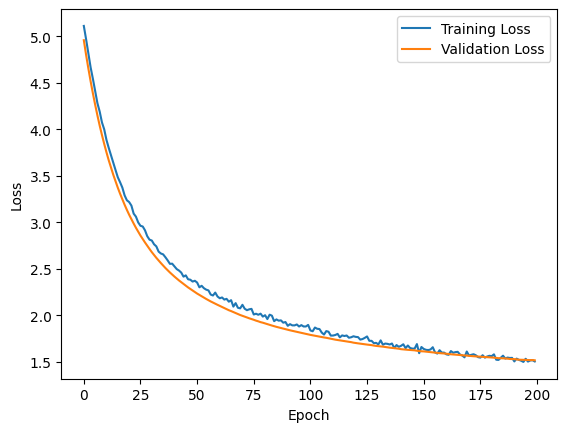

In [ ]:
plt.plot(range(num_epochs), Overall_train_loss, label='Training Loss')
plt.plot(range(num_epochs), Overall_loss, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

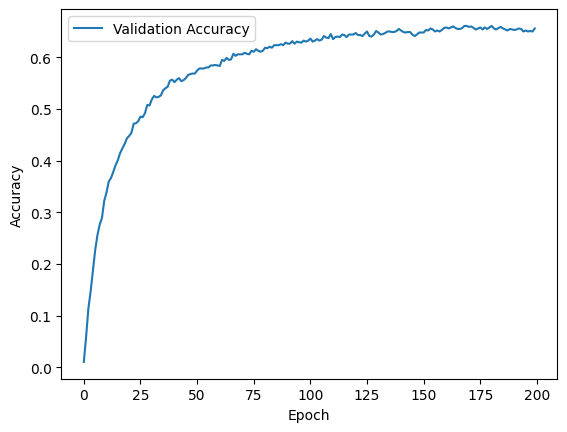

In [ ]:
stacked_tensor = torch.stack(hist)
val_acc = [tensor.cpu().numpy() for tensor in stacked_tensor]
plt.plot(range(num_epochs), val_acc, label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

Testing The Model

In [ ]:
import numpy
def imshow(inp, title=None):
    """Imshow for Tensor."""
    # inp = inp.numpy().transpose((1, 2, 0))  # Convert tensor to NumPy array
    # mean = np.array([0.485, 0.456, 0.406])
    # std = np.array([0.229, 0.224, 0.225])
    # inp = std * inp + mean  # Reverse the data normalization
    # inp = np.clip(inp, 0, 1)
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.axis('off')
    plt.show()

In [ ]:
##This code is a dataset built for providing intresting and informative information based on the precdiction of the model

Pokemon_dict = {}

Pokemon_dict['Abra'] = [['Abra, Kadabra, Alakazam'],['Psychic']]
Pokemon_dict['Alakazam'] = [['Abra, Kadabra, Alakazam'],['Psychic']]
Pokemon_dict['Kadabra'] = [['Abra, Kadabra, Alakazam'],['Psychic']]
Pokemon_dict['Aerodactyl'] = [['Aerodactyl'],['Flying ,Rock']]
Pokemon_dict['Alolan Sandslash'] = [['Sanslash, Alolan Sandslash'],['Ice, Steel']]
Pokemon_dict['Sanslash'] = [['Sanslash, Alolan Sandslash'],['Ice, Steel']]
Pokemon_dict['Arbok'] = [['Arbok, Ekans'],['Poison']]
Pokemon_dict['Ekans'] = [['Arbok, Ekans'],['Poison']]
Pokemon_dict['Arcanine'] = [['Arcanine, Growlithe'],['Fire, Rock']]
Pokemon_dict['Growlithe'] = [['Arcanine, Growlithe'],['Fire, Rock']]
Pokemon_dict['Articuno'] = [['Arcanine'],['Ice, Flying']]
Pokemon_dict['Blastoise'] = [['Squirtle, Blastoise, Wartortle'],['Water']]
Pokemon_dict['Wartortle'] = [['Squirtle, Blastoise, Wartortle'],['Water']]
Pokemon_dict['Squirtle'] = [['Squirtle, Blastoise, Wartortle'],['Water']]
Pokemon_dict['Bulbasaur'] = [['Bulbasaur, Ivysaur, Venusaur'],['Grass, Poison']]
Pokemon_dict['Ivysaur'] = [['Bulbasaur, Ivysaur, Venusaur'],['Grass, Poison']]
Pokemon_dict['Venusaur'] = [['Bulbasaur, Ivysaur, Venusaur'],['Grass, Poison']]
Pokemon_dict['Butterfree'] = [['Butterfree, Caterpie, Metapod'],['Bug, Flying']]
Pokemon_dict['Caterpie'] = [['Butterfree, Caterpie, Metapod'],['Bug, Flying']]
Pokemon_dict['Metapod'] = [['Butterfree, Caterpie, Metapod'],['Bug, Flying']]
Pokemon_dict['Chansey'] = [['Chansey, Happiny'],['Normal']]
Pokemon_dict['Happiny'] = [['Chansey, Happiny'],['Normal']]
Pokemon_dict['Charizard'] = [['Charizard, Charmander, Charmeleon'],['Fire, Dragon']]
Pokemon_dict['Charmander'] = [['Charizard, Charmander, Charmeleon'],['Fire, Dragon']]
Pokemon_dict['Charmeleon'] = [['Charizard, Charmander, Charmeleon'],['Fire, Dragon']]
Pokemon_dict['Clefable'] = [['Clefable, Clefairy'],['Fairy']]
Pokemon_dict['Clefairy'] = [['Clefable, Clefairy'],['Fairy']]
Pokemon_dict['Cloyster'] = [['Cloyster, Shellder'],['Water, Ice']]
Pokemon_dict['Shellder'] = [['Cloyster, Shellder'],['Water, Ice']]
Pokemon_dict['Cubone'] = [['Cubone, Marowak'],['Ground']]
Pokemon_dict['Marowak'] = [['Cubone, Marowak'],['Ground']]
Pokemon_dict['Dewgong'] = [['Dewgong, Seel'],['Water, Ice']]
Pokemon_dict['Seel'] = [['Dewgong, Seel'],['Water, Ice']]
Pokemon_dict['Diglett'] = [['Diglett, Dugtrio'],['Ground, Steel']]
Pokemon_dict['Dugtrio'] = [['Diglett, Dugtrio'],['Ground, Steel']]
Pokemon_dict['Ditto'] = [['Ditto'],['Normal']]
Pokemon_dict['Dodrio'] = [['Dodrio, Doduo'],['Normal, Flying']]
Pokemon_dict['Doduo'] = [['Dodrio, Doduo'],['Normal, Flying']]
Pokemon_dict['Dragonair'] = [['Dragonair, Dratini, Dragonite'],['Dragon']]
Pokemon_dict['Dratini'] = [['Dragonair, Dratini, Dragonite'],['Dragon']]
Pokemon_dict['Dragonite'] = [['Dragonair, Dratini, Dragonite'],['Dragon']]
Pokemon_dict['Drowzee'] = [['Drowzee, Hypno'],['Psychic']]
Pokemon_dict['Hypno'] = [['Drowzee, Hypno'],['Psychic']]
Pokemon_dict['Electabuzz'] = [['Electabuzz'],['Electric']]
Pokemon_dict['Exeggcute'] = [['Exeggcute, Exeggutor'],['Grass, Psychic']]
Pokemon_dict['Exeggutor'] = [['Exeggcute, Exeggutor'],['Grass, Psychic']]
Pokemon_dict['Farfetchd'] = [['Farfetchd'],['Normal, Flying']]
Pokemon_dict['Gastly'] = [['Gastly, Haunter, Gengar'],['Ghost, Poison']]
Pokemon_dict['Haunter'] = [['Gastly, Haunter, Gengar'],['Ghost, Poison']]
Pokemon_dict['Gengar'] = [['Gengar, Haunter, Gengar'],['Ghost, Poison']]
Pokemon_dict['Geodude'] = [['Geodude, Graveler, Golem'],['Rock, Ground']]
Pokemon_dict['Graveler'] = [['Geodude, Graveler, Golem'],['Rock, Ground']]
Pokemon_dict['Golem'] = [['Geodude, Graveler, Golem'],['Rock, Ground']]
Pokemon_dict['Golduck'] = [['Golduck, Psyduck'],['Water']]
Pokemon_dict['Psyduck'] = [['Golduck, Psyduck'],['Water']]
Pokemon_dict['Grimer'] = [['Grimer , Muk'],['Poison']]
Pokemon_dict['Muk'] = [['Grimer , Muk'],['Poison']]
Pokemon_dict['Gyarados'] = [['Gyarados , Magikarp'],['Water, Flying']]
Pokemon_dict['Magikarp'] = [['Gyarados , Magikarp'],['Water, Flying']]
Pokemon_dict['Hitmonchan'] = [['Hitmonchan, Hitmonlee'],['Fighting']]
Pokemon_dict['Hitmonlee'] = [['Hitmonchan, Hitmonlee'],['Fighting']]
Pokemon_dict['Jynx'] = [['Jynx, Smoochum, Rougella'],['Ice, Psychic']]
Pokemon_dict['Kabuto'] = [['Kabuto, Kabutops'],['Rock, Water']]
Pokemon_dict['Kabutops'] = [['Kabuto, Kabutops'],['Rock, Water']]
Pokemon_dict['Kangaskhan'] = [['Kangaskhan'],['Normal']]
Pokemon_dict['Kingler'] = [['Kingler, Krabby'],['Water']]
Pokemon_dict['Krabby'] = [['Kingler, Krabby'],['Water']]
Pokemon_dict['Lapras'] = [['Lapras'],['Water, Ice']]
Pokemon_dict['Lickitung'] = [['Lickitung'],['Normal']]
Pokemon_dict['Machamp'] = [['Machamp, Machop, Machoke'],['Fighting']]
Pokemon_dict['Machop'] = [['Machamp, Machop, Machoke'],['Fighting']]
Pokemon_dict['Machoke'] = [['Machamp, Machop, Machoke'],['Fighting']]
Pokemon_dict['Magmar'] = [['Magmar'],['Fire']]
Pokemon_dict['Magnemite'] = [['Magnemite, Magneton'],['Electric, Stell']]
Pokemon_dict['Magneton'] = [['Magnemite, Magneton'],['Electric, Stell']]
Pokemon_dict['Mankey'] = [['Mankey'],['Fighting']]

Pokemon_dict['Zubat'] = [['Zubat, Golbat, Crobat'],['Psychic']]
Pokemon_dict['Golbat'] = [['Zubat, Golbat, Crobat'],['Psychic']]
Pokemon_dict['Crobat'] = [['Zubat, Golbat, Crobat'],['Psychic']]

Pokemon_dict['Zapdos'] = [['Zapdos'],['Flying']]

Pokemon_dict['Wigglytuff'] = [['Igglybuff, Jigglypuff, Wigglytuff'],['Fairy']]
Pokemon_dict['Igglybuff'] = [['Igglybuff, Jigglypuff, Wigglytuff'],['Fairy']]
Pokemon_dict['Jigglypuff'] = [['Igglybuff, Jigglypuff, Wigglytuff'],['Fairy']]


Pokemon_dict['Weezing'] = [['Koffing, Weezing'],['Poison']]
Pokemon_dict['Koffing'] = [['Koffing, Weezing'],['Poison']]


Pokemon_dict['Weepinbell'] = [['Bellsprout, Weepinbell, Victreebel'],['Grass, Poison']]
Pokemon_dict['Bellsprout'] = [['Bellsprout, Weepinbell, Victreebel'],['Grass, Poison']]
Pokemon_dict['Victreebel'] = [['Bellsprout, Weepinbell, Victreebel'],['Grass, Poison']]


Pokemon_dict['Weedle'] = [['Weedle, Kakuna, Beedrill'],['Bug, Poison']]
Pokemon_dict['Kakuna'] = [['Weedle, Kakuna, Beedrill'],['Bug, Poison']]
Pokemon_dict['Beedrill'] = [['Weedle, Kakuna, Beedrill'],['Bug, Poison']]



Pokemon_dict['Vulpix'] = [['Vulpix, Ninetales'],['Fire']]
Pokemon_dict['Ninetales'] = [['Vulpix, Ninetales'],['Fire']]


Pokemon_dict['Voltorb'] = [['Voltorb, Electrode'],['Electric']]
Pokemon_dict['Electrode'] = [['Voltorb, Electrode'],['Electric']]

Pokemon_dict['Vileplume'] = [['Vileplume, Gloom, Oddish'],['Grass']]
Pokemon_dict['Gloom'] = [['Vileplume, Gloom, Oddish'],['Grass']]
Pokemon_dict['Oddish'] = [['Vileplume, Gloom, Oddish'],['Grass']]

Pokemon_dict['Venonat'] = [['Venonat, Venomoth'],['Bug, Poison']]
Pokemon_dict['Venomoth'] = [['Voltorb, Venomoth'],['Bug, Poison']]

Pokemon_dict['Vaporeon'] = [['Eevee, Vaporeon'],['Water']]
Pokemon_dict['Jolteon'] = [['Eevee, Jolteon'],['Electric']]
Pokemon_dict['Flareon'] = [['Eevee, Flareon'],['Fire']]
Pokemon_dict['Eevee'] = [['Eevee, Vaporeon, Jolteon, Flareon'],['Normal']]

Pokemon_dict['Tentacool'] = [['Tentacool, Tentacruel'],['Water']]
Pokemon_dict['Tentacruel'] = [['Tentacool, Tentacruel'],['Water']]

Pokemon_dict['Tauros'] = [['Tauros'],['Normal']]

Pokemon_dict['Tangela'] = [['Tangela, Tangrowth'],['Grass']]
Pokemon_dict['Tangrowth'] = [['Tangela, Tangrowth'],['Grass']]

Pokemon_dict['Staryu'] = [['Staryu, Starmie'],['Water']]
Pokemon_dict['Starmie'] = [['Staryu, Starmie'],['Water, Psychic']]

Pokemon_dict['Spearow'] = [['Spearow, Fearow'],['Normal, Flying']]
Pokemon_dict['Fearow'] = [['Spearow, Fearow'],['Normal, Flying']]

Pokemon_dict['Munchlax'] = [['Munchlax, Snorlax'],['Normal']]
Pokemon_dict['Snorlax'] = [['Munchlax, Snorlax'],['Normal']]

Pokemon_dict['Slowpoke'] = [['Slowpoke, Slowbro'],['Water, Psychic']]
Pokemon_dict['Slowbro'] = [['Slowpoke, Slowbro'],['Water, Psychic']]
Pokemon_dict['Slowking'] = [['Slowpoke, Slowking'],['Water, Psychic']]

Pokemon_dict['Goldeen'] = [['Goldeen, Seaking'],['Water']]
Pokemon_dict['Seaking'] = [['Goldeen, Seaking'],['Water']]

Pokemon_dict['Seadra'] = [['Horsea, Seadra, Kingdra'],['Water']]
Pokemon_dict['Horsea'] = [['Horsea, Seadra, Kingdra'],['Water']]
Pokemon_dict['Kingdra'] = [['Horsea, Seadra, Kingdra'],['Water, Dragon']]

Pokemon_dict['Scyther'] = [['Scyther, Scizor, Kleavor'],['Bug, Flying']]
Pokemon_dict['Scizor'] = [['Scyther, Scizor'],['Bug, Steel']]
Pokemon_dict['Kleavor'] = [['Scyther, Kleavor'],['Bug, Rock']]

Pokemon_dict['Sandshrew'] = [['Sandshrew, Sandslash'],['Ground']]
Pokemon_dict['Sandslash'] = [['Sandshrew, Sandslash'],['Ground']]

Pokemon_dict['Rhyhorn'] = [['Rhyhorn, Rhydon, Rhyperior'],['Ground, Rock']]
Pokemon_dict['Rhydon'] = [['Rhyhorn, Rhydon, Rhyperior'],['Ground, Rock']]
Pokemon_dict['Rhyperior'] = [['Rhyhorn, Rhydon, Rhyperior'],['Ground, Rock']]

Pokemon_dict['Rattata'] = [['Rattata, Raticate'],['Normal']]
Pokemon_dict['Raticate'] = [['Rattata, Raticate'],['Normal']]

Pokemon_dict['Rapidash'] = [['Ponyta, Rapidash'],['Fire']]
Pokemon_dict['Ponyta'] = [['Ponyta, Rapidash'],['Fire']]

Pokemon_dict['Raichu'] = [['Pichu, Pikachu, Raichu'],['Electric']]
Pokemon_dict['Pikachu'] = [['Pichu, Pikachu, Raichu'],['Electric']]
Pokemon_dict['Pichu'] = [['Pichu, Pikachu, Raichu'],['Electric']]

Pokemon_dict['Primeape'] = [['Mankey, Primeape'],['Fighting']]
Pokemon_dict['Mankey'] = [['Mankey, Primeape'],['Fighting']]

Pokemon_dict['Porygon'] = [['Porygon, Porygon2, Porygon-Z'],['Normal']]
Pokemon_dict['Porygon2'] = [['Porygon, Porygon2, Porygon-Z'],['Normal']]
Pokemon_dict['Porygon-Z'] = [['Porygon, Porygon2, Porygon-Z'],['Normal']]

Pokemon_dict['Poliwag'] = [['Poliwag, Poliwhirl, Poliwrath'],['Water']]
Pokemon_dict['Poliwhirl'] = [['Poliwag, Poliwhirl, Poliwrath'],['Water']]
Pokemon_dict['Poliwrath'] = [['Poliwag, Poliwhirl, Poliwrath'],['Water, Fighting']]

Pokemon_dict['Pinsir'] = [['Pinsir'],['Bug']]

Pokemon_dict['Pidgey'] = [['Pidgey, Pidgeotto, Pidgeot'],['Normal, Flying']]
Pokemon_dict['Pidgeotto'] = [['Pidgey, Pidgeotto, Pidgeot'],['Normal, Flying']]
Pokemon_dict['Pidgeot'] = [['Pidgey, Pidgeotto, Pidgeot'],['Normal, Flying']]

Pokemon_dict['Persian'] = [['Meowth, Persian'],['Normal']]
Pokemon_dict['Meowth'] = [['Meowth, Persian'],['Normal']]

Pokemon_dict['Paras'] = [['Paras, Parasect'],['Bug, Grass']]
Pokemon_dict['Parasect'] = [['Paras, Parasect'],['Bug, Grass']]

Pokemon_dict['Onix'] = [['Onix, Steelix'],['Rock, Ground']]
Pokemon_dict['Steelix'] = [['Onix, Steelix'],['Rock, Ground']]

Pokemon_dict['Omanyte'] = [['Omanyte, Omastar'],['Rock, Water']]
Pokemon_dict['Omastar'] = [['Omanyte, Omastar'],['Rock, Water']]

Pokemon_dict['Nidoran'] = [['Nidoran, Nidorino, Nidoking'],['Poison']]
Pokemon_dict['Nidorino'] = [['Nidoran, Nidorino, Nidoking'],['Poison']]
Pokemon_dict['Nidoking'] = [['Nidoran, Nidorino, Nidoking'],['Poison']]

Pokemon_dict['Nidorina'] = [['Nidorina, Nidoqueen'],['Poison']]
Pokemon_dict['Nidoqueen'] = [['Nidorina, Nidoqueen'],['Poison']]

Pokemon_dict['Mime Jr.'] = [['Mime Jr., MrMime'],['Psychic, Fairy']]
Pokemon_dict['MrMime'] = [['Nidorina, Nidoqueen'],['Psychic, Fairy']]

Pokemon_dict['Moltres'] = [['Moltres'],['Fire, Flying']]

Pokemon_dict['Mewtwo'] = [['Mewtwo'],['Psychic']]

Pokemon_dict['Mew'] = [['Mew'],['Psychic']]

The Pokemon Evolution is:  ['Arcanine, Growlithe']
The Pokemon Type is:  ['Fire, Rock']
Predicted class: Arcanine


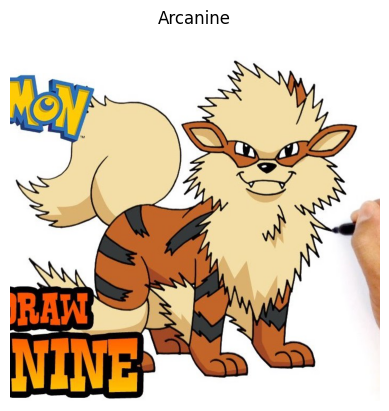


----------
The Pokemon Evolution is:  ['Dodrio, Doduo']
The Pokemon Type is:  ['Normal, Flying']
Predicted class: Dodrio


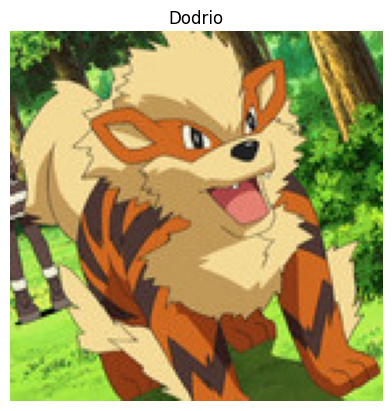


----------
The Pokemon Evolution is:  ['Arcanine, Growlithe']
The Pokemon Type is:  ['Fire, Rock']
Predicted class: Arcanine


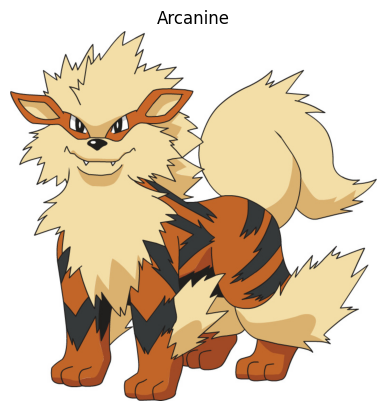


----------
The Pokemon Evolution is:  ['Arcanine, Growlithe']
The Pokemon Type is:  ['Fire, Rock']
Predicted class: Arcanine


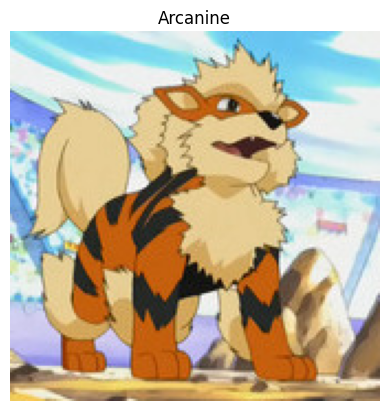


----------
The Pokemon Evolution is:  ['Mankey, Primeape']
The Pokemon Type is:  ['Fighting']
Predicted class: Primeape


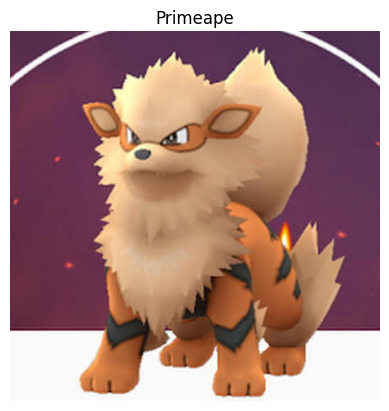


----------
The Pokemon Evolution is:  ['Arcanine, Growlithe']
The Pokemon Type is:  ['Fire, Rock']
Predicted class: Arcanine


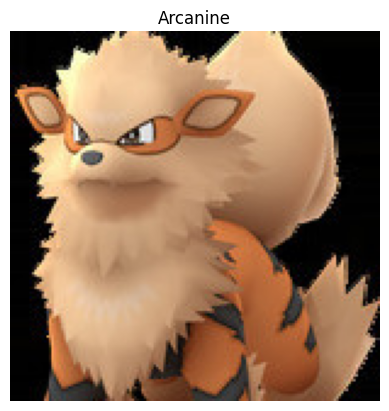


----------
The Pokemon Evolution is:  ['Arcanine, Growlithe']
The Pokemon Type is:  ['Fire, Rock']
Predicted class: Arcanine


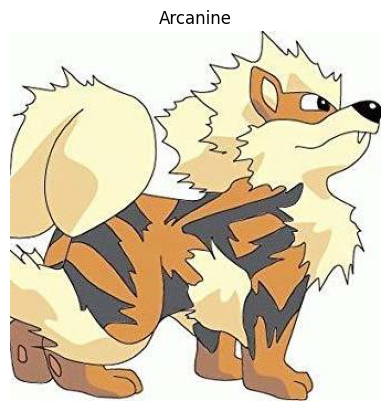


----------
The Pokemon Evolution is:  ['Pidgey, Pidgeotto, Pidgeot']
The Pokemon Type is:  ['Normal, Flying']
Predicted class: Pidgey


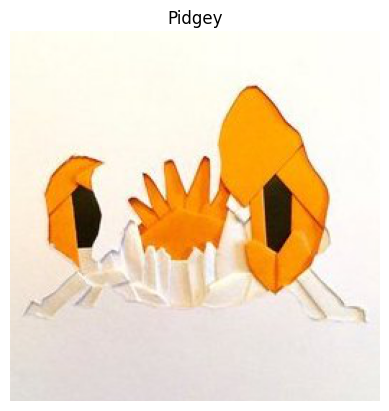


----------
The Pokemon Evolution is:  ['Kingler, Krabby']
The Pokemon Type is:  ['Water']
Predicted class: Kingler


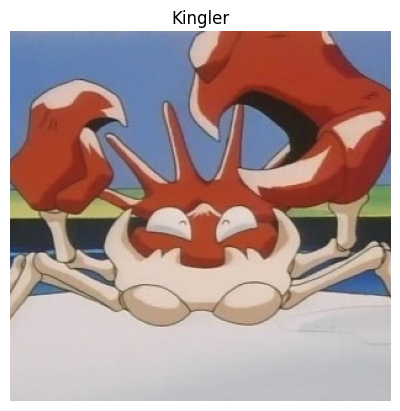


----------
The Pokemon Evolution is:  ['Kingler, Krabby']
The Pokemon Type is:  ['Water']
Predicted class: Kingler


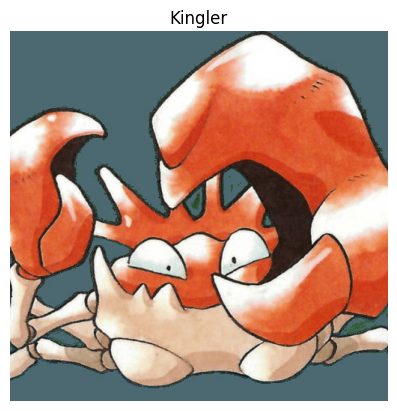


----------
The Pokemon Evolution is:  ['Abra, Kadabra, Alakazam']
The Pokemon Type is:  ['Psychic']
Predicted class: Kadabra


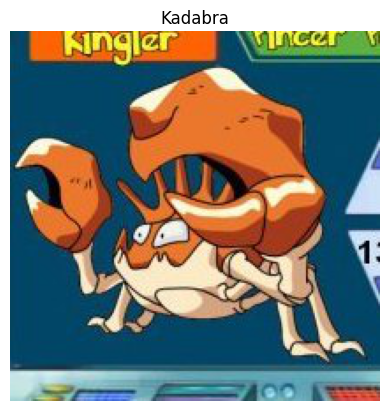


----------
The Pokemon Evolution is:  ['Kingler, Krabby']
The Pokemon Type is:  ['Water']
Predicted class: Kingler


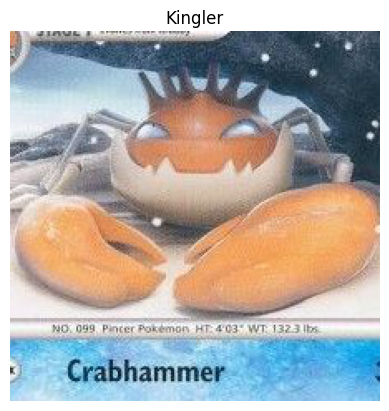


----------
The Pokemon Evolution is:  ['Mewtwo']
The Pokemon Type is:  ['Psychic']
Predicted class: Mewtwo


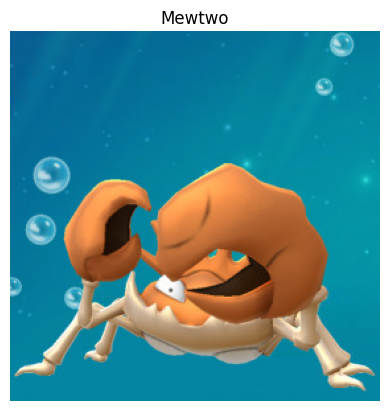


----------
The Pokemon Evolution is:  ['Magmar']
The Pokemon Type is:  ['Fire']
Predicted class: Magmar


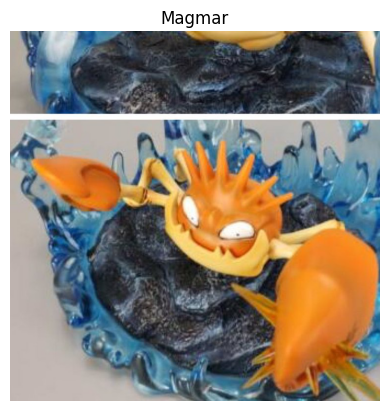


----------
The Pokemon Evolution is:  ['Omanyte, Omastar']
The Pokemon Type is:  ['Rock, Water']
Predicted class: Omastar


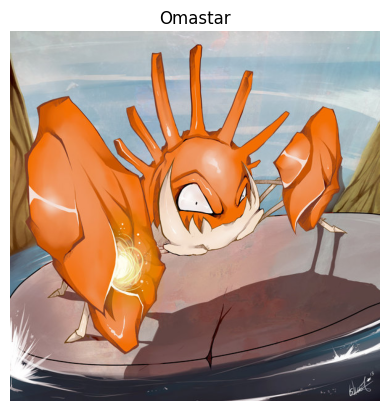


----------
The Pokemon Evolution is:  ['Pinsir']
The Pokemon Type is:  ['Bug']
Predicted class: Pinsir


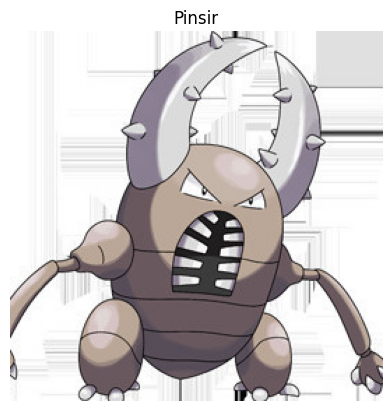


----------
The Pokemon Evolution is:  ['Machamp, Machop, Machoke']
The Pokemon Type is:  ['Fighting']
Predicted class: Machamp


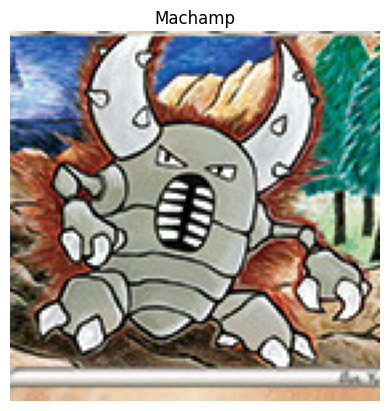


----------
The Pokemon Evolution is:  ['Ponyta, Rapidash']
The Pokemon Type is:  ['Fire']
Predicted class: Rapidash


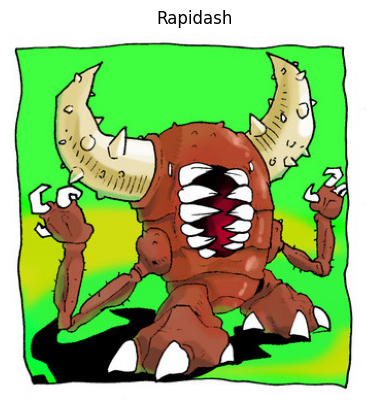


----------
The Pokemon Evolution is:  ['Pinsir']
The Pokemon Type is:  ['Bug']
Predicted class: Pinsir


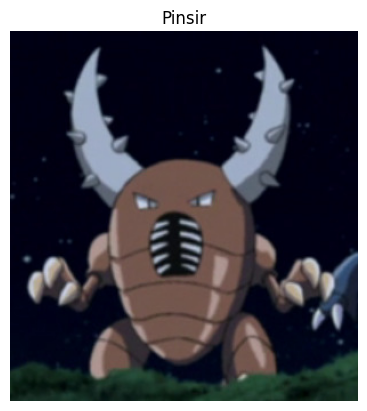


----------
The Pokemon Evolution is:  ['Pinsir']
The Pokemon Type is:  ['Bug']
Predicted class: Pinsir


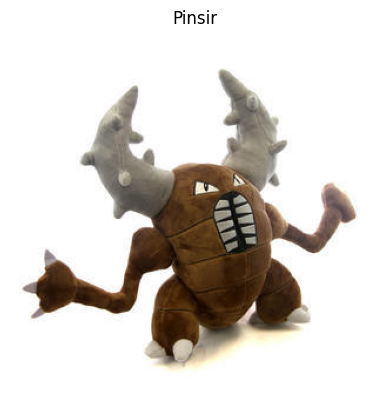


----------
The Pokemon Evolution is:  ['Pinsir']
The Pokemon Type is:  ['Bug']
Predicted class: Pinsir


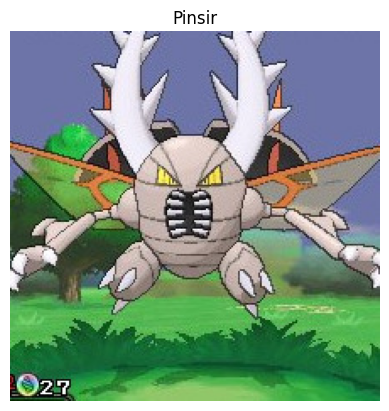


----------
The Pokemon Evolution is:  ['Hitmonchan, Hitmonlee']
The Pokemon Type is:  ['Fighting']
Predicted class: Hitmonchan


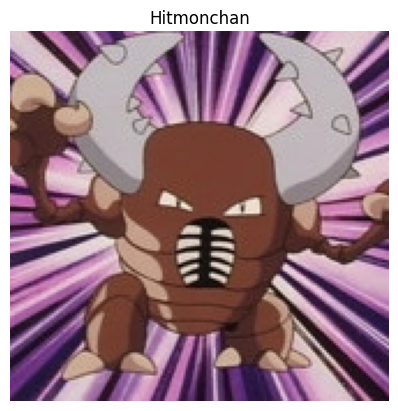


----------
The Pokemon Evolution is:  ['Abra, Kadabra, Alakazam']
The Pokemon Type is:  ['Psychic']
Predicted class: Abra


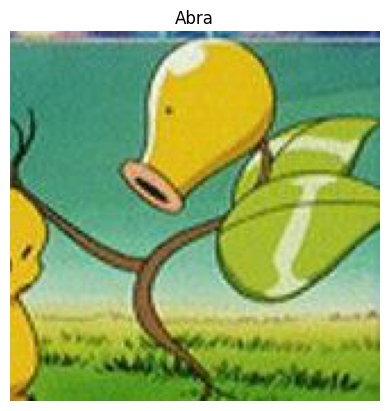


----------
The Pokemon Evolution is:  ['Bellsprout, Weepinbell, Victreebel']
The Pokemon Type is:  ['Grass, Poison']
Predicted class: Bellsprout


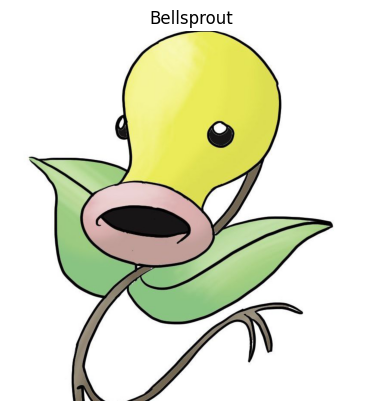


----------
The Pokemon Evolution is:  ['Butterfree, Caterpie, Metapod']
The Pokemon Type is:  ['Bug, Flying']
Predicted class: Metapod


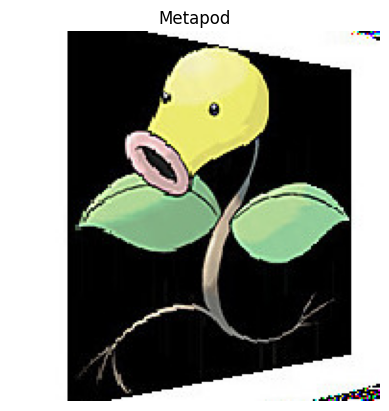


----------
The Pokemon Evolution is:  ['Bellsprout, Weepinbell, Victreebel']
The Pokemon Type is:  ['Grass, Poison']
Predicted class: Bellsprout


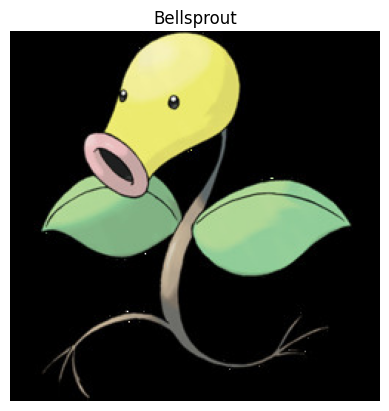


----------
The Pokemon Evolution is:  ['Bellsprout, Weepinbell, Victreebel']
The Pokemon Type is:  ['Grass, Poison']
Predicted class: Bellsprout


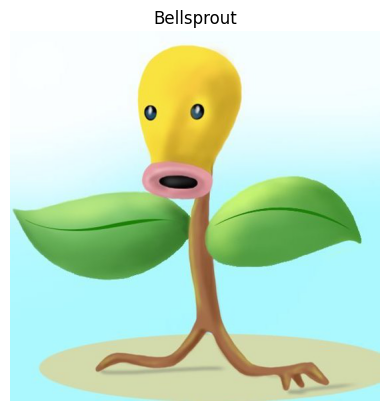


----------
The Pokemon Evolution is:  ['Bellsprout, Weepinbell, Victreebel']
The Pokemon Type is:  ['Grass, Poison']
Predicted class: Bellsprout


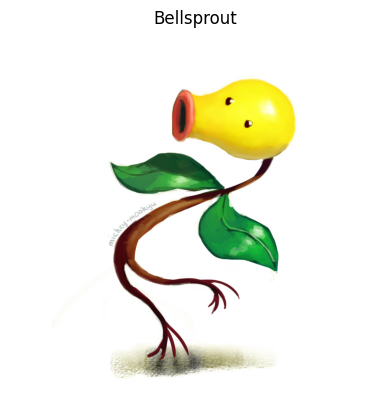


----------
The Pokemon Evolution is:  ['Nidoran, Nidorino, Nidoking']
The Pokemon Type is:  ['Poison']
Predicted class: Nidoking


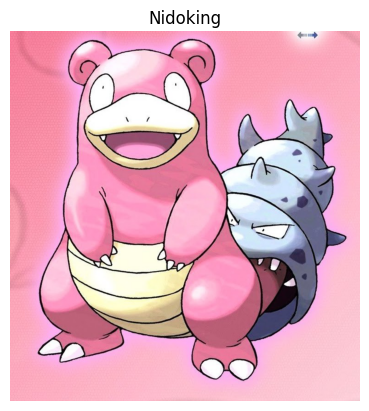


----------
The Pokemon Evolution is:  ['Lickitung']
The Pokemon Type is:  ['Normal']
Predicted class: Lickitung


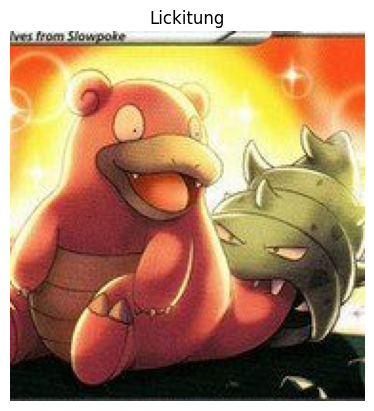


----------
The Pokemon Evolution is:  ['Ponyta, Rapidash']
The Pokemon Type is:  ['Fire']
Predicted class: Ponyta


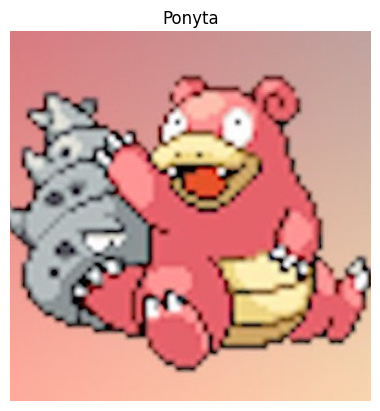


----------
The Pokemon Evolution is:  ['Tangela, Tangrowth']
The Pokemon Type is:  ['Grass']
Predicted class: Tangela


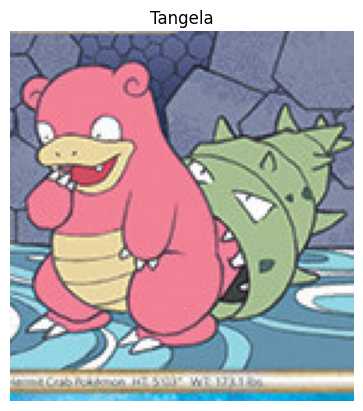


----------
The Pokemon Evolution is:  ['Slowpoke, Slowbro']
The Pokemon Type is:  ['Water, Psychic']
Predicted class: Slowbro


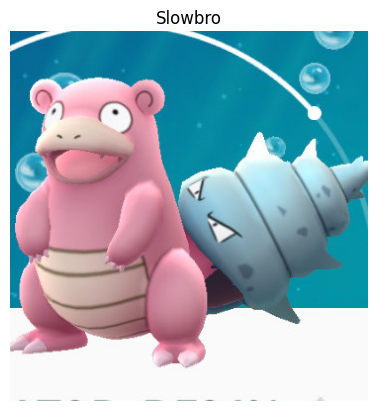


----------
The Pokemon Evolution is:  ['Squirtle, Blastoise, Wartortle']
The Pokemon Type is:  ['Water']
Predicted class: Squirtle


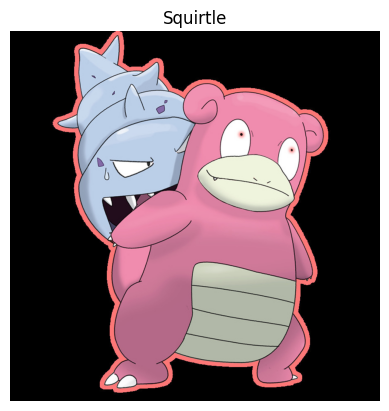


----------
The Pokemon Evolution is:  ['Rattata, Raticate']
The Pokemon Type is:  ['Normal']
Predicted class: Rattata


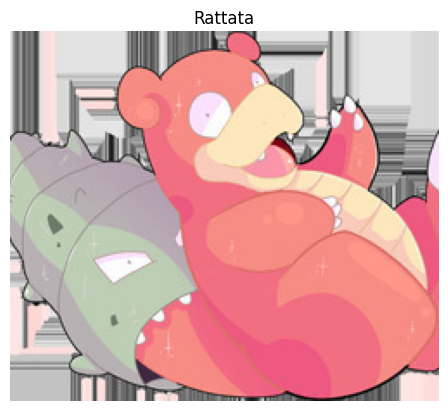


----------
The Pokemon Evolution is:  ['Cloyster, Shellder']
The Pokemon Type is:  ['Water, Ice']
Predicted class: Shellder


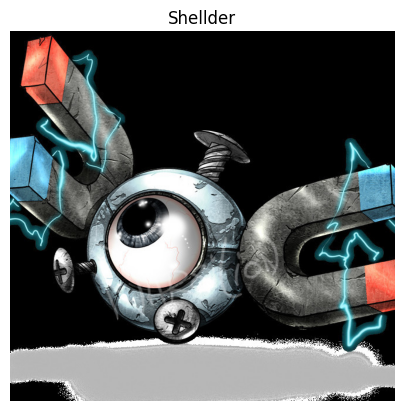


----------
The Pokemon Evolution is:  ['Magnemite, Magneton']
The Pokemon Type is:  ['Electric, Stell']
Predicted class: Magneton


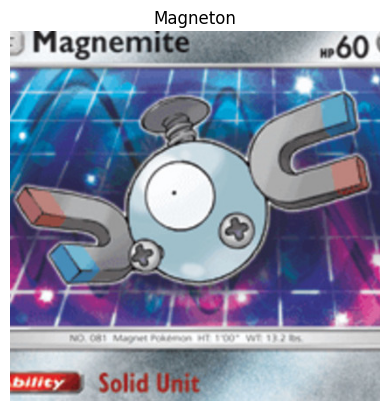


----------
The Pokemon Evolution is:  ['Magnemite, Magneton']
The Pokemon Type is:  ['Electric, Stell']
Predicted class: Magnemite


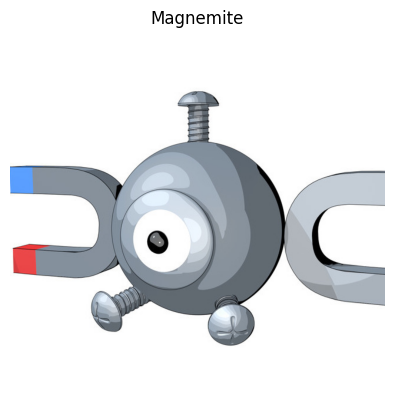


----------
The Pokemon Evolution is:  ['Magnemite, Magneton']
The Pokemon Type is:  ['Electric, Stell']
Predicted class: Magnemite


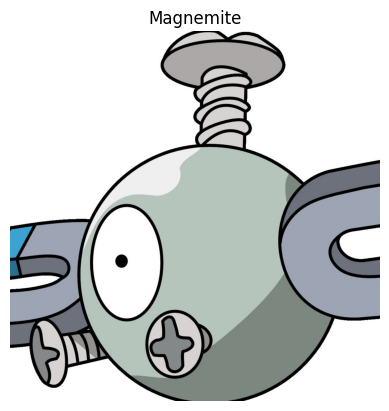


----------
The Pokemon Evolution is:  ['Magnemite, Magneton']
The Pokemon Type is:  ['Electric, Stell']
Predicted class: Magnemite


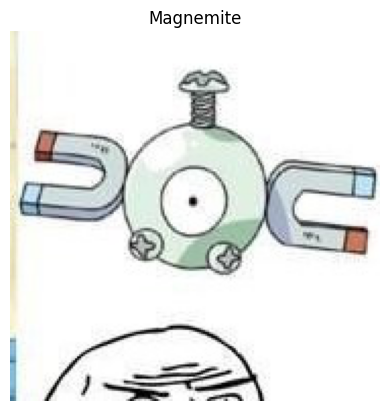


----------
The Pokemon Evolution is:  ['Magnemite, Magneton']
The Pokemon Type is:  ['Electric, Stell']
Predicted class: Magnemite


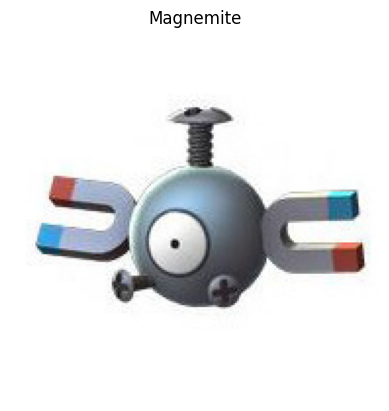


----------
The Pokemon Evolution is:  ['Onix, Steelix']
The Pokemon Type is:  ['Rock, Ground']
Predicted class: Onix


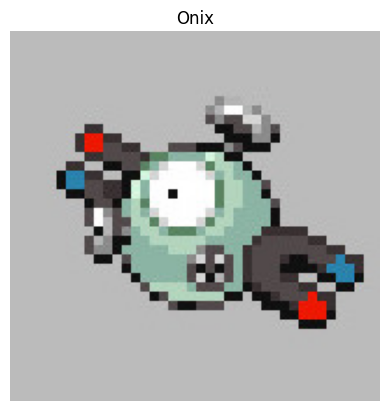


----------
The Pokemon Evolution is:  ['Nidorina, Nidoqueen']
The Pokemon Type is:  ['Poison']
Predicted class: Nidoqueen


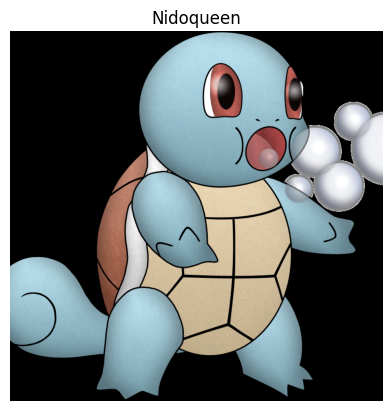


----------
The Pokemon Evolution is:  ['Squirtle, Blastoise, Wartortle']
The Pokemon Type is:  ['Water']
Predicted class: Wartortle


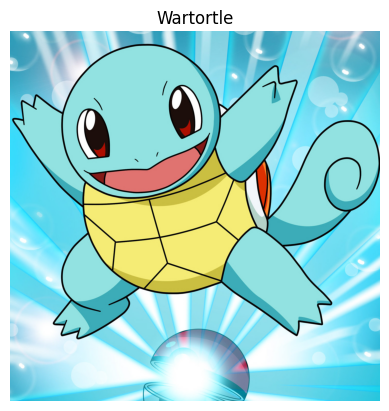


----------
The Pokemon Evolution is:  ['Squirtle, Blastoise, Wartortle']
The Pokemon Type is:  ['Water']
Predicted class: Squirtle


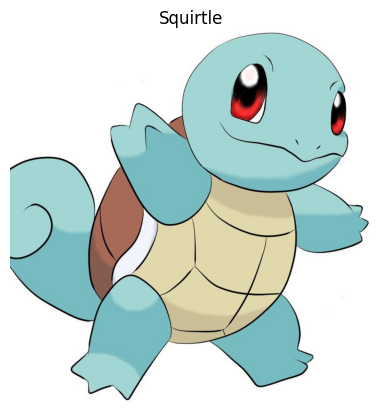


----------
The Pokemon Evolution is:  ['Squirtle, Blastoise, Wartortle']
The Pokemon Type is:  ['Water']
Predicted class: Squirtle


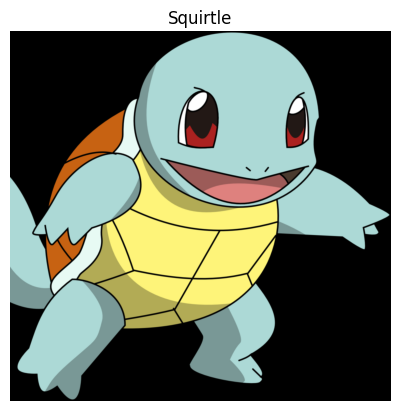


----------
The Pokemon Evolution is:  ['Squirtle, Blastoise, Wartortle']
The Pokemon Type is:  ['Water']
Predicted class: Squirtle


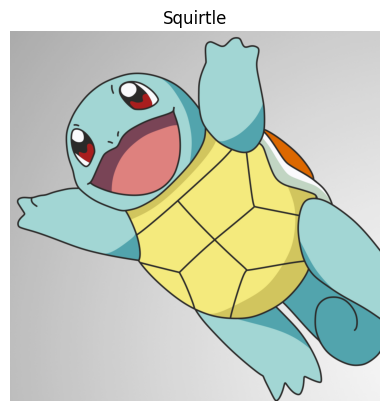


----------
The Pokemon Evolution is:  ['Squirtle, Blastoise, Wartortle']
The Pokemon Type is:  ['Water']
Predicted class: Squirtle


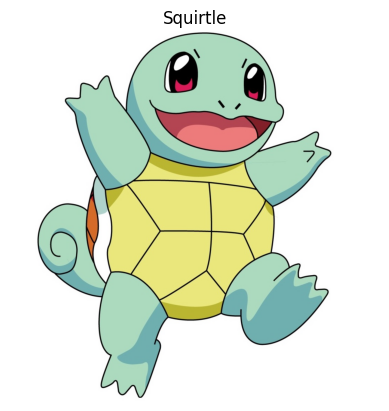


----------
The Pokemon Evolution is:  ['Squirtle, Blastoise, Wartortle']
The Pokemon Type is:  ['Water']
Predicted class: Squirtle


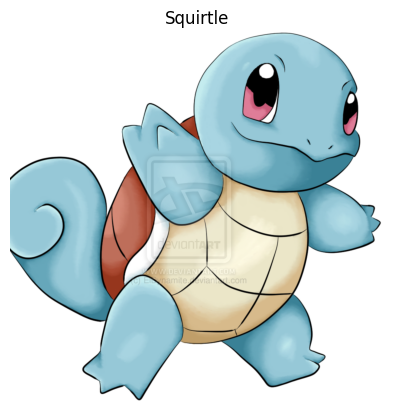


----------
The Pokemon Evolution is:  ['Squirtle, Blastoise, Wartortle']
The Pokemon Type is:  ['Water']
Predicted class: Squirtle


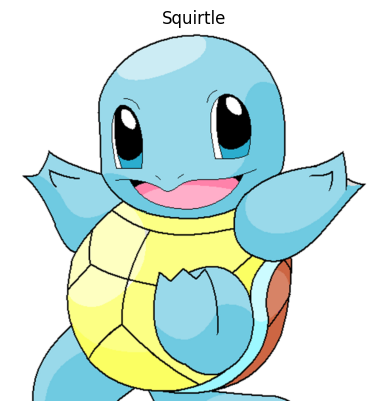


----------
The Pokemon Evolution is:  ['Lapras']
The Pokemon Type is:  ['Water, Ice']
Predicted class: Lapras


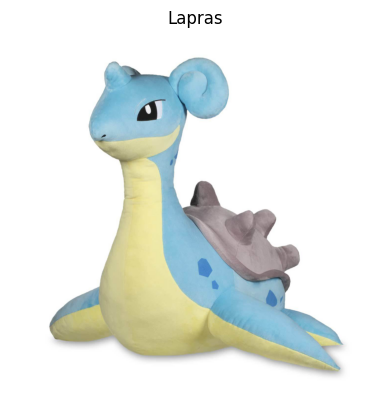


----------
The Pokemon Evolution is:  ['Lapras']
The Pokemon Type is:  ['Water, Ice']
Predicted class: Lapras


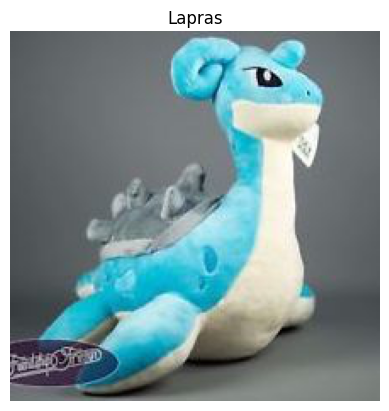


----------
The Pokemon Evolution is:  ['Lapras']
The Pokemon Type is:  ['Water, Ice']
Predicted class: Lapras


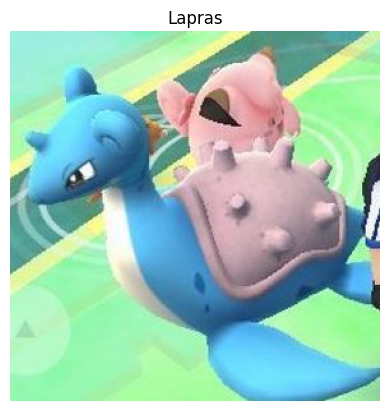


----------
The Pokemon Evolution is:  ['Dewgong, Seel']
The Pokemon Type is:  ['Water, Ice']
Predicted class: Dewgong


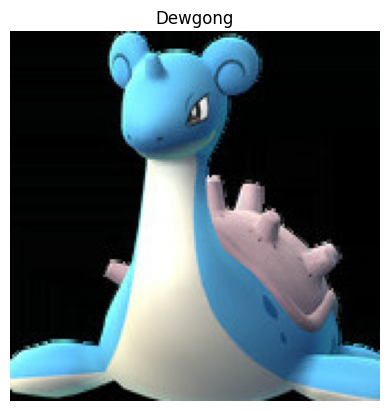


----------
The Pokemon Evolution is:  ['Lapras']
The Pokemon Type is:  ['Water, Ice']
Predicted class: Lapras


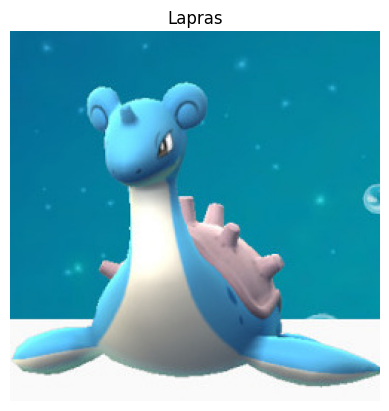


----------
The Pokemon Evolution is:  ['Squirtle, Blastoise, Wartortle']
The Pokemon Type is:  ['Water']
Predicted class: Squirtle


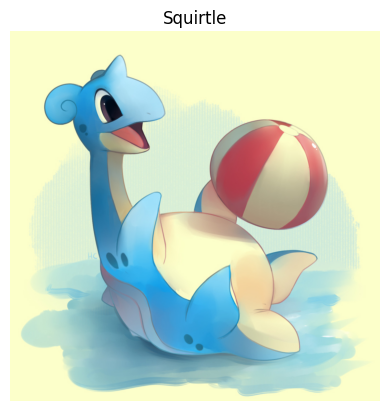


----------
The Pokemon Evolution is:  ['Lapras']
The Pokemon Type is:  ['Water, Ice']
Predicted class: Lapras


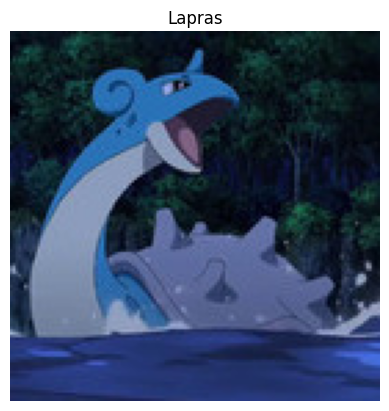


----------
The Pokemon Evolution is:  ['Dragonair, Dratini, Dragonite']
The Pokemon Type is:  ['Dragon']
Predicted class: Dratini


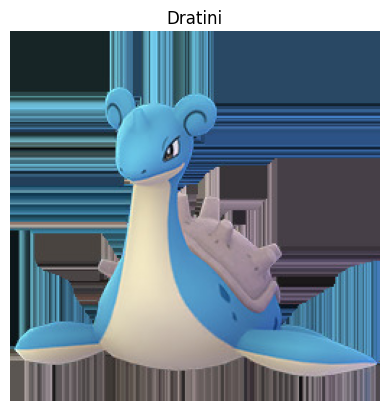


----------
The Pokemon Evolution is:  ['Golduck, Psyduck']
The Pokemon Type is:  ['Water']
Predicted class: Golduck


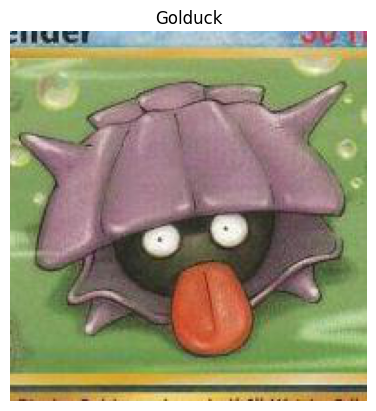


----------
The Pokemon Evolution is:  ['Nidorina, Nidoqueen']
The Pokemon Type is:  ['Psychic, Fairy']
Predicted class: MrMime


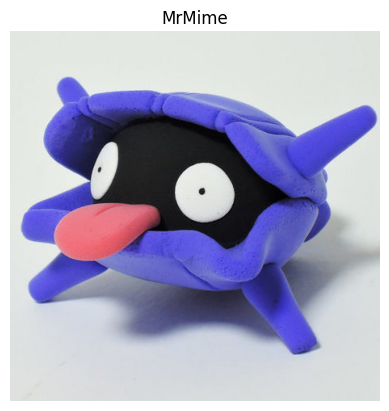


----------
The Pokemon Evolution is:  ['Nidorina, Nidoqueen']
The Pokemon Type is:  ['Poison']
Predicted class: Nidoqueen


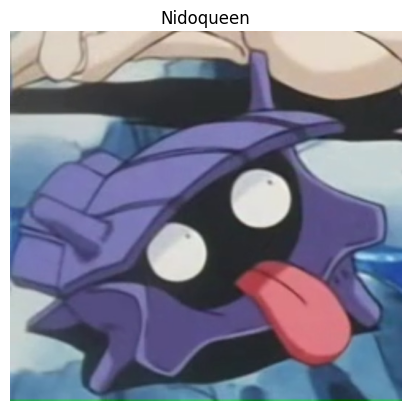


----------
The Pokemon Evolution is:  ['Cloyster, Shellder']
The Pokemon Type is:  ['Water, Ice']
Predicted class: Shellder


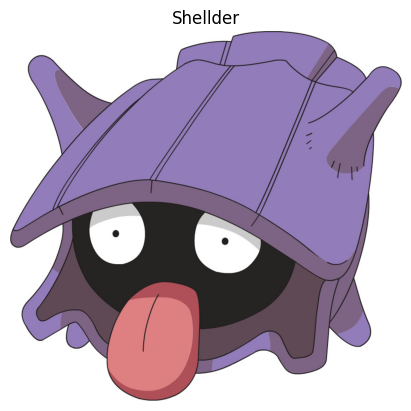


----------
The Pokemon Evolution is:  ['Rattata, Raticate']
The Pokemon Type is:  ['Normal']
Predicted class: Rattata


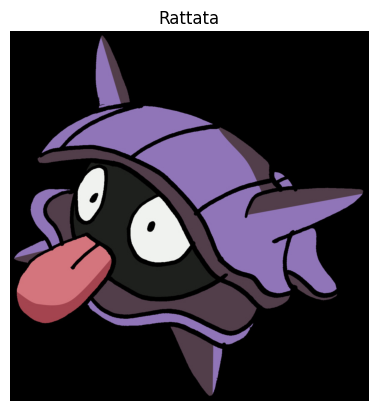


----------
The Pokemon Evolution is:  ['Koffing, Weezing']
The Pokemon Type is:  ['Poison']
Predicted class: Weezing


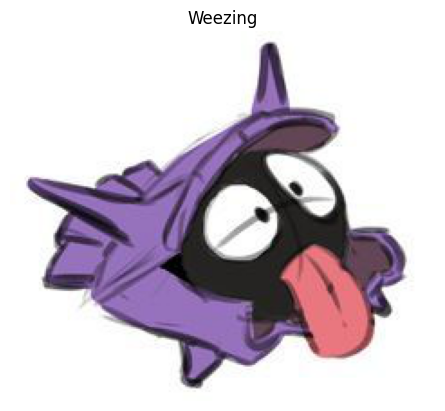


----------
The Pokemon Evolution is:  ['Cloyster, Shellder']
The Pokemon Type is:  ['Water, Ice']
Predicted class: Shellder


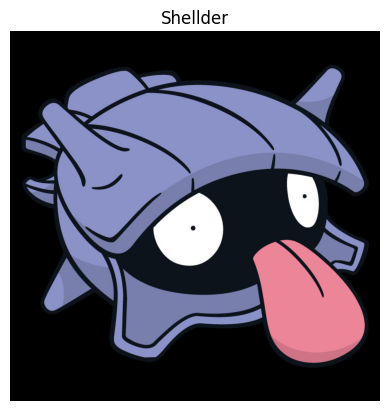


----------
The Pokemon Evolution is:  ['Magmar']
The Pokemon Type is:  ['Fire']
Predicted class: Magmar


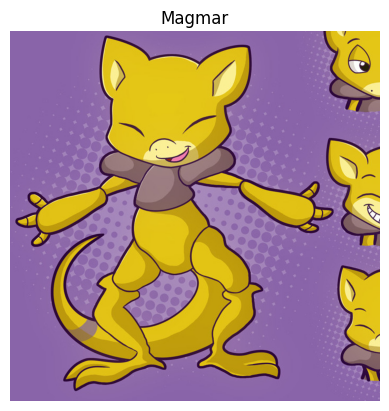


----------
The Pokemon Evolution is:  ['Abra, Kadabra, Alakazam']
The Pokemon Type is:  ['Psychic']
Predicted class: Abra


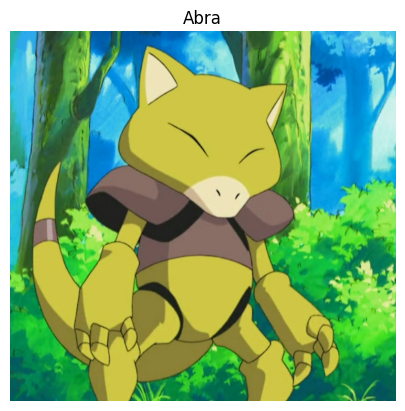


----------
The Pokemon Evolution is:  ['Abra, Kadabra, Alakazam']
The Pokemon Type is:  ['Psychic']
Predicted class: Kadabra


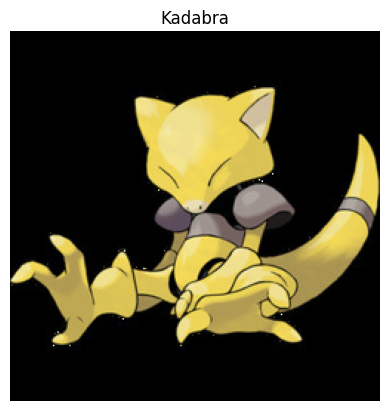


----------
The Pokemon Evolution is:  ['Abra, Kadabra, Alakazam']
The Pokemon Type is:  ['Psychic']
Predicted class: Abra


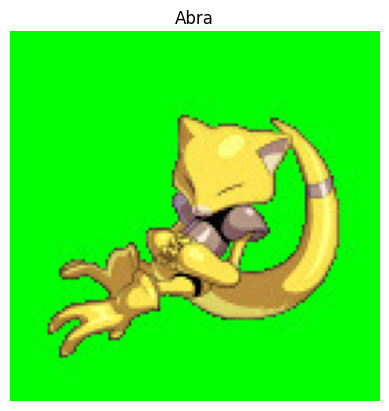


----------
The Pokemon Evolution is:  ['Abra, Kadabra, Alakazam']
The Pokemon Type is:  ['Psychic']
Predicted class: Kadabra


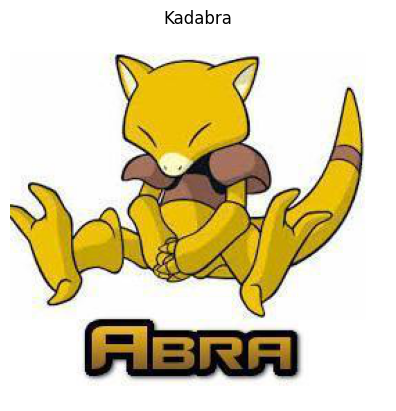


----------
The Pokemon Evolution is:  ['Ponyta, Rapidash']
The Pokemon Type is:  ['Fire']
Predicted class: Ponyta


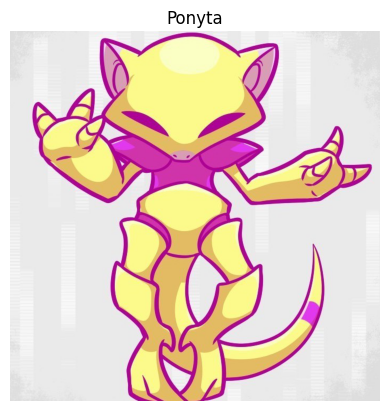


----------
The Pokemon Evolution is:  ['Magnemite, Magneton']
The Pokemon Type is:  ['Electric, Stell']
Predicted class: Magneton


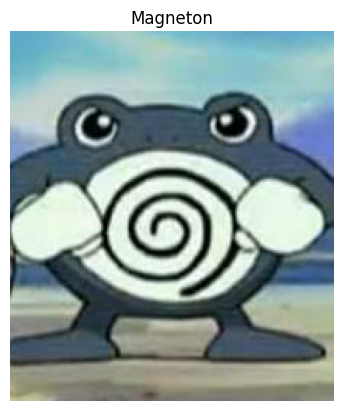


----------
The Pokemon Evolution is:  ['Poliwag, Poliwhirl, Poliwrath']
The Pokemon Type is:  ['Water']
Predicted class: Poliwhirl


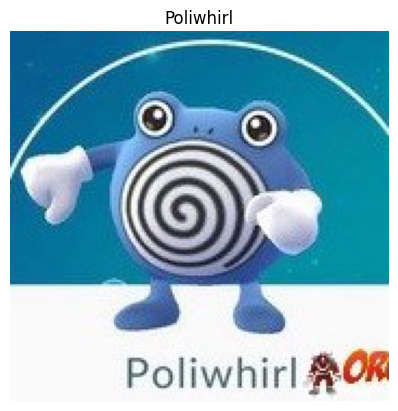


----------
The Pokemon Evolution is:  ['Poliwag, Poliwhirl, Poliwrath']
The Pokemon Type is:  ['Water']
Predicted class: Poliwhirl


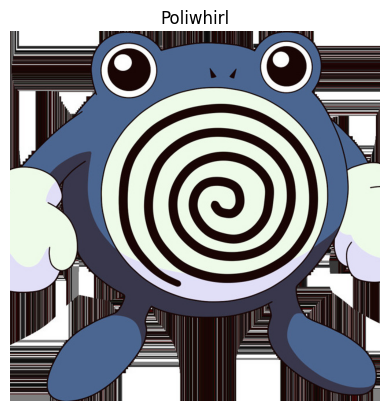


----------
The Pokemon Evolution is:  ['Poliwag, Poliwhirl, Poliwrath']
The Pokemon Type is:  ['Water']
Predicted class: Poliwhirl


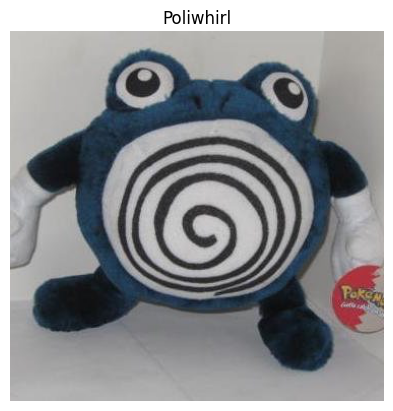


----------
The Pokemon Evolution is:  ['Poliwag, Poliwhirl, Poliwrath']
The Pokemon Type is:  ['Water, Fighting']
Predicted class: Poliwrath


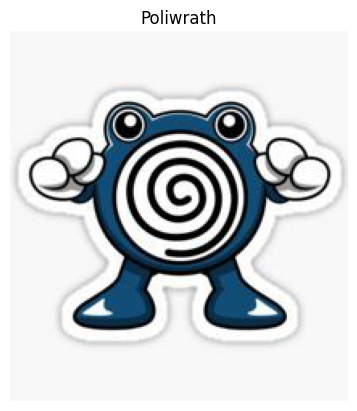


----------
The Pokemon Evolution is:  ['Poliwag, Poliwhirl, Poliwrath']
The Pokemon Type is:  ['Water']
Predicted class: Poliwhirl


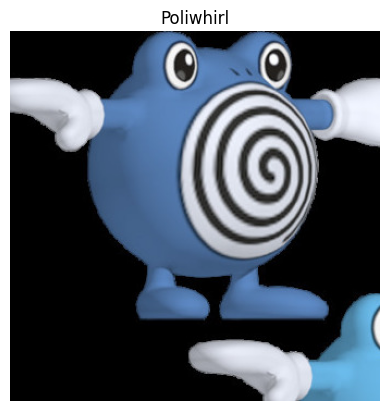


----------
The Pokemon Evolution is:  ['Poliwag, Poliwhirl, Poliwrath']
The Pokemon Type is:  ['Water']
Predicted class: Poliwhirl


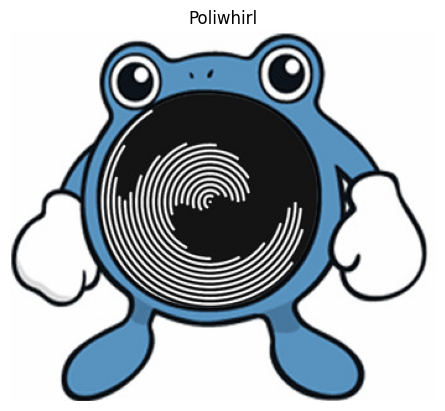


----------
The Pokemon Evolution is:  ['Poliwag, Poliwhirl, Poliwrath']
The Pokemon Type is:  ['Water']
Predicted class: Poliwhirl


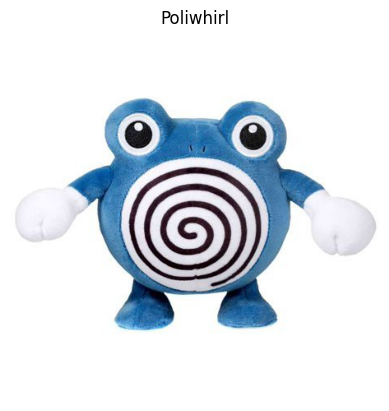


----------
The Pokemon Evolution is:  ['Gastly, Haunter, Gengar']
The Pokemon Type is:  ['Ghost, Poison']
Predicted class: Haunter


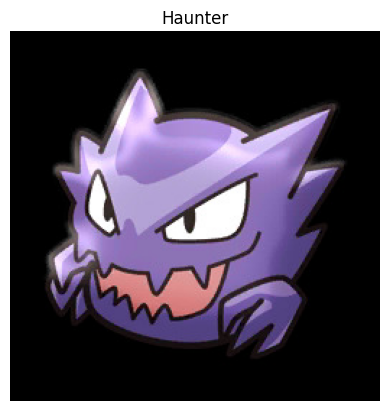


----------
The Pokemon Evolution is:  ['Gastly, Haunter, Gengar']
The Pokemon Type is:  ['Ghost, Poison']
Predicted class: Haunter


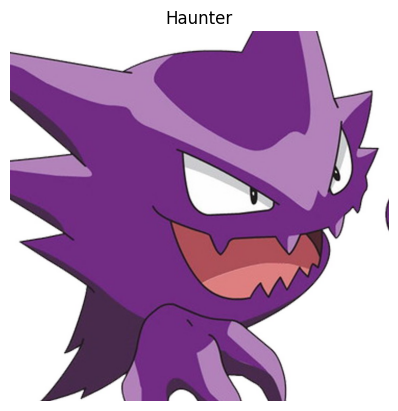


----------
The Pokemon Evolution is:  ['Gastly, Haunter, Gengar']
The Pokemon Type is:  ['Ghost, Poison']
Predicted class: Haunter


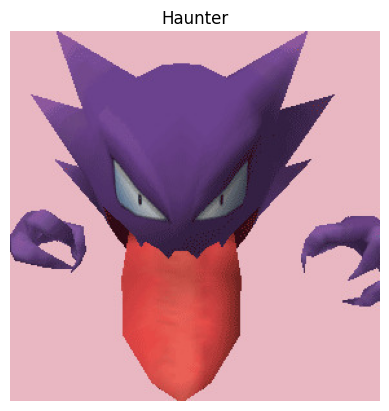


----------
The Pokemon Evolution is:  ['Gastly, Haunter, Gengar']
The Pokemon Type is:  ['Ghost, Poison']
Predicted class: Haunter


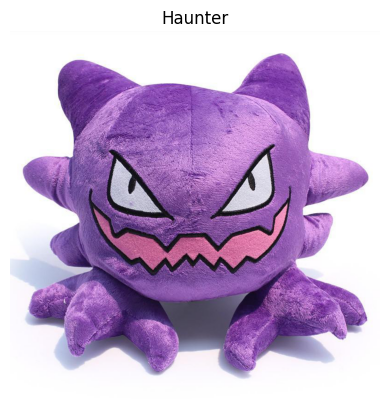


----------
The Pokemon Evolution is:  ['Onix, Steelix']
The Pokemon Type is:  ['Rock, Ground']
Predicted class: Onix


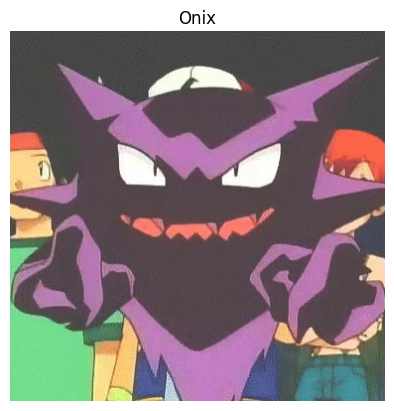


----------
The Pokemon Evolution is:  ['Gastly, Haunter, Gengar']
The Pokemon Type is:  ['Ghost, Poison']
Predicted class: Haunter


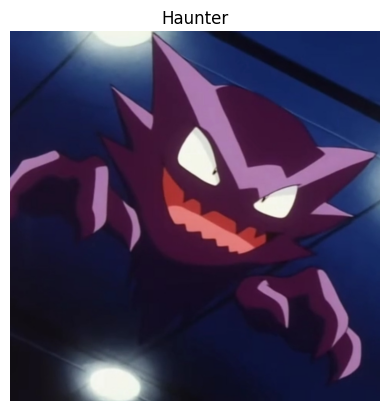


----------
The Pokemon Evolution is:  ['Gastly, Haunter, Gengar']
The Pokemon Type is:  ['Ghost, Poison']
Predicted class: Haunter


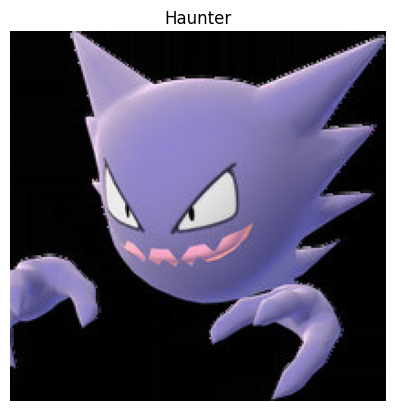


----------
The Pokemon Evolution is:  ['Omanyte, Omastar']
The Pokemon Type is:  ['Rock, Water']
Predicted class: Omastar


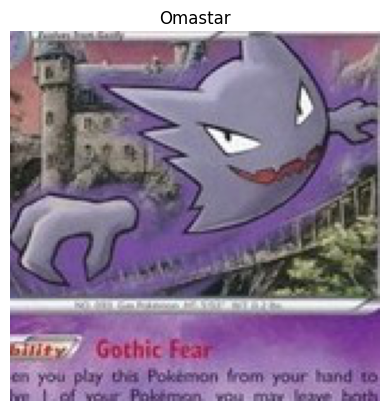


----------
The Pokemon Evolution is:  ['Nidorina, Nidoqueen']
The Pokemon Type is:  ['Poison']
Predicted class: Nidorina


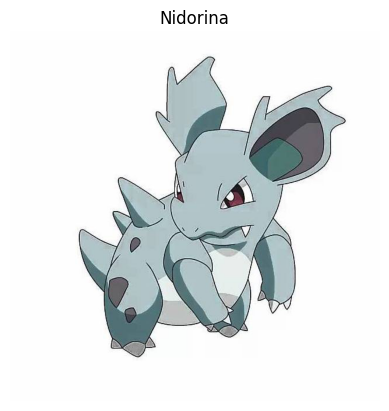


----------
The Pokemon Evolution is:  ['Nidorina, Nidoqueen']
The Pokemon Type is:  ['Poison']
Predicted class: Nidorina


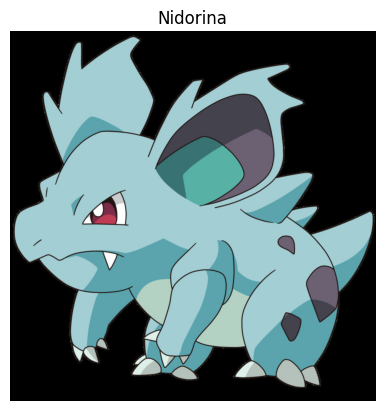


----------
The Pokemon Evolution is:  ['Nidoran, Nidorino, Nidoking']
The Pokemon Type is:  ['Poison']
Predicted class: Nidoking


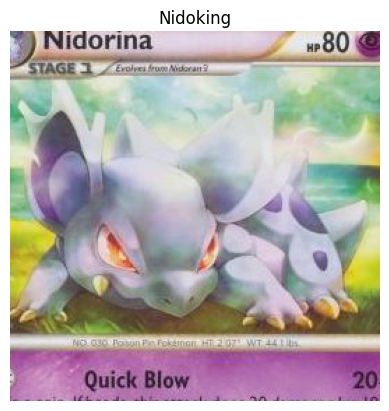


----------
The Pokemon Evolution is:  ['Eevee, Vaporeon, Jolteon, Flareon']
The Pokemon Type is:  ['Normal']
Predicted class: Eevee


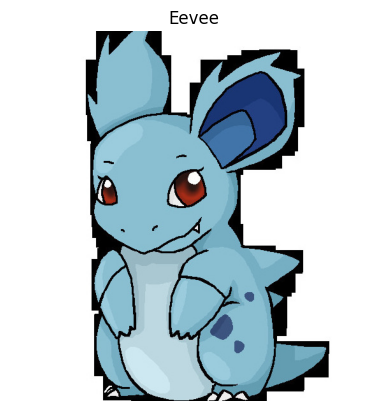


----------
The Pokemon Evolution is:  ['Geodude, Graveler, Golem']
The Pokemon Type is:  ['Rock, Ground']
Predicted class: Golem


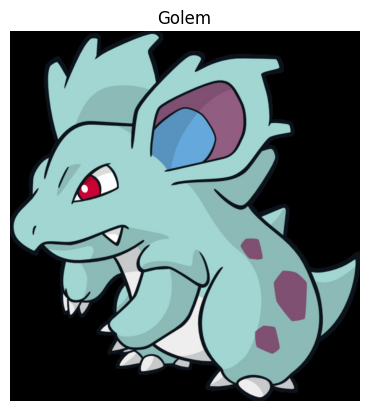


----------
The Pokemon Evolution is:  ['Nidorina, Nidoqueen']
The Pokemon Type is:  ['Poison']
Predicted class: Nidorina


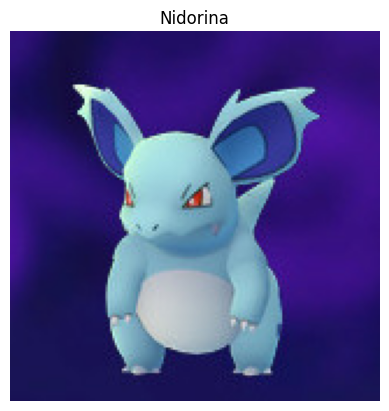


----------
The Pokemon Evolution is:  ['Staryu, Starmie']
The Pokemon Type is:  ['Water, Psychic']
Predicted class: Starmie


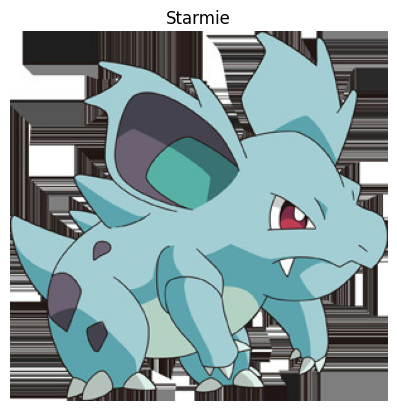


----------
The Pokemon Evolution is:  ['Eevee, Flareon']
The Pokemon Type is:  ['Fire']
Predicted class: Flareon


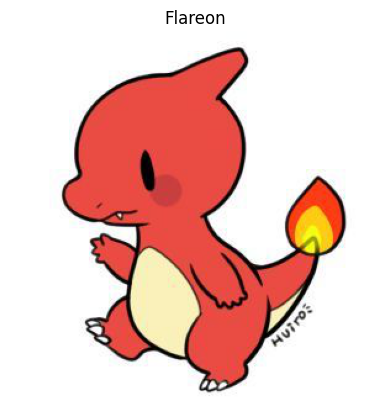


----------
The Pokemon Evolution is:  ['Charizard, Charmander, Charmeleon']
The Pokemon Type is:  ['Fire, Dragon']
Predicted class: Charmeleon


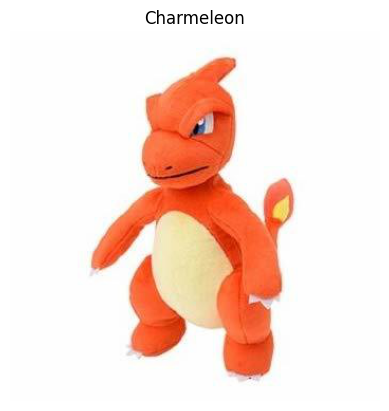


----------
The Pokemon Evolution is:  ['Charizard, Charmander, Charmeleon']
The Pokemon Type is:  ['Fire, Dragon']
Predicted class: Charmeleon


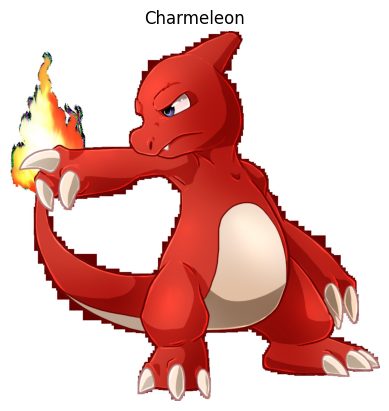


----------
The Pokemon Evolution is:  ['Charizard, Charmander, Charmeleon']
The Pokemon Type is:  ['Fire, Dragon']
Predicted class: Charmeleon


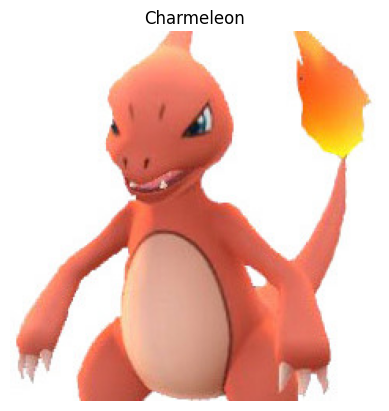


----------
The Pokemon Evolution is:  ['Arcanine, Growlithe']
The Pokemon Type is:  ['Fire, Rock']
Predicted class: Growlithe


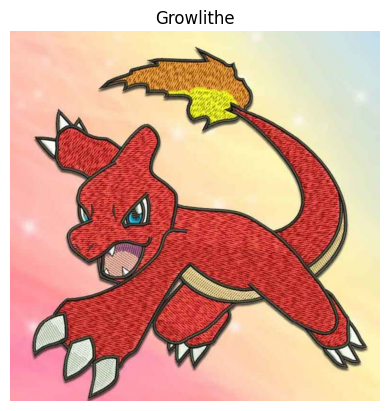


----------
The Pokemon Evolution is:  ['Charizard, Charmander, Charmeleon']
The Pokemon Type is:  ['Fire, Dragon']
Predicted class: Charmeleon


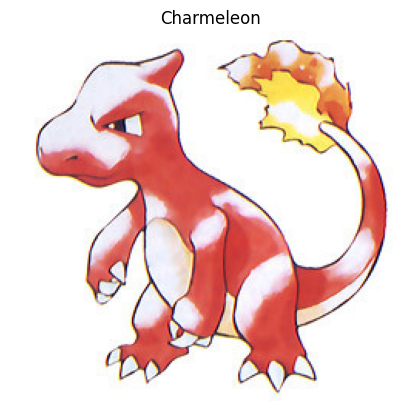


----------
The Pokemon Evolution is:  ['Magmar']
The Pokemon Type is:  ['Fire']
Predicted class: Magmar


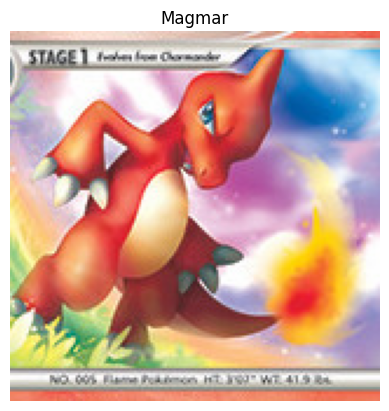


----------
The Pokemon Evolution is:  ['Igglybuff, Jigglypuff, Wigglytuff']
The Pokemon Type is:  ['Fairy']
Predicted class: Jigglypuff


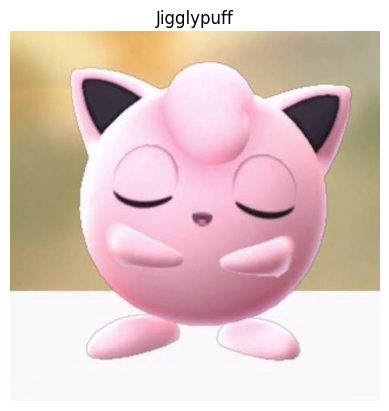


----------
The Pokemon Evolution is:  ['Igglybuff, Jigglypuff, Wigglytuff']
The Pokemon Type is:  ['Fairy']
Predicted class: Jigglypuff


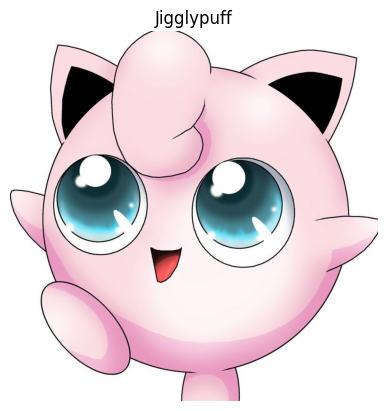


----------
The Pokemon Evolution is:  ['Igglybuff, Jigglypuff, Wigglytuff']
The Pokemon Type is:  ['Fairy']
Predicted class: Jigglypuff


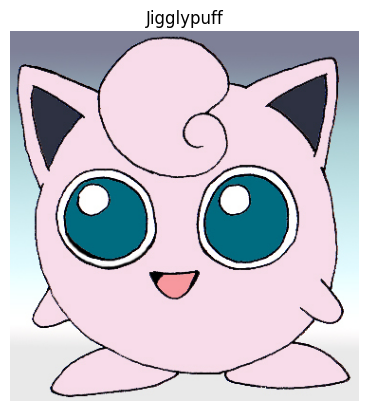


----------
The Pokemon Evolution is:  ['Igglybuff, Jigglypuff, Wigglytuff']
The Pokemon Type is:  ['Fairy']
Predicted class: Jigglypuff


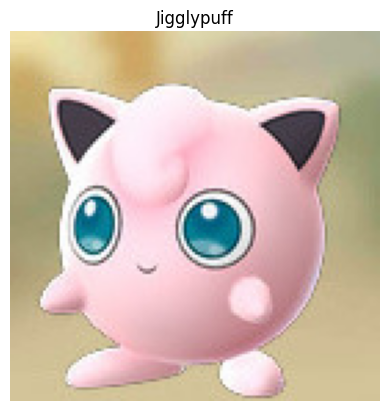


----------
The Pokemon Evolution is:  ['Bulbasaur, Ivysaur, Venusaur']
The Pokemon Type is:  ['Grass, Poison']
Predicted class: Bulbasaur


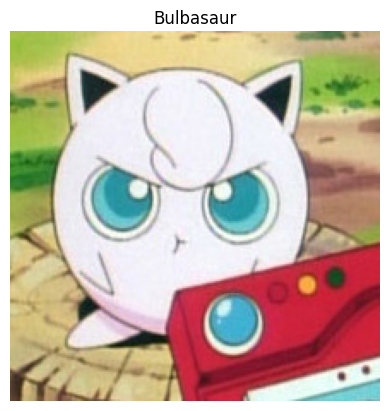


----------
The Pokemon Evolution is:  ['Igglybuff, Jigglypuff, Wigglytuff']
The Pokemon Type is:  ['Fairy']
Predicted class: Jigglypuff


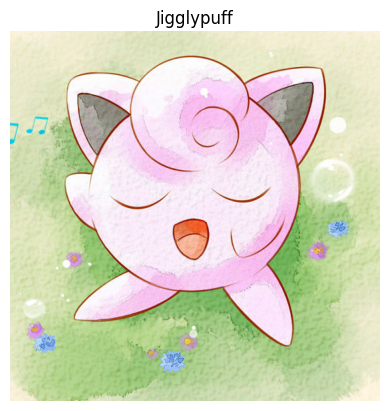


----------
The Pokemon Evolution is:  ['Igglybuff, Jigglypuff, Wigglytuff']
The Pokemon Type is:  ['Fairy']
Predicted class: Jigglypuff


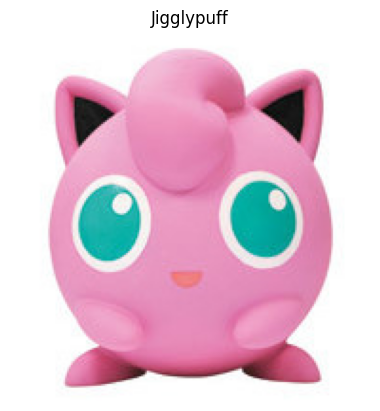


----------
The Pokemon Evolution is:  ['Ponyta, Rapidash']
The Pokemon Type is:  ['Fire']
Predicted class: Ponyta


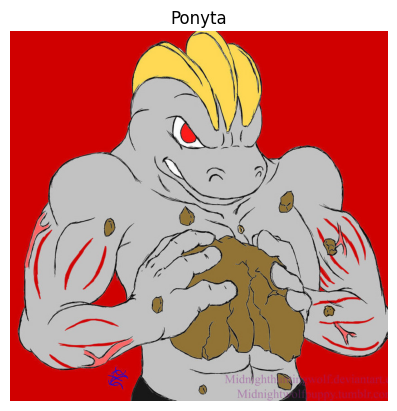


----------
The Pokemon Evolution is:  ['Farfetchd']
The Pokemon Type is:  ['Normal, Flying']
Predicted class: Farfetchd


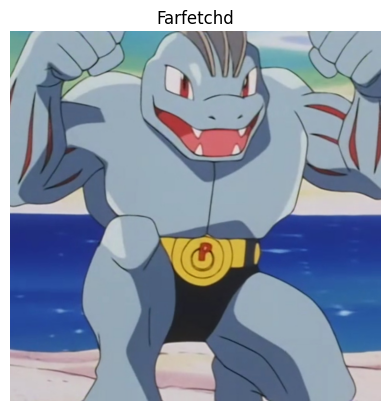


----------
The Pokemon Evolution is:  ['Machamp, Machop, Machoke']
The Pokemon Type is:  ['Fighting']
Predicted class: Machoke


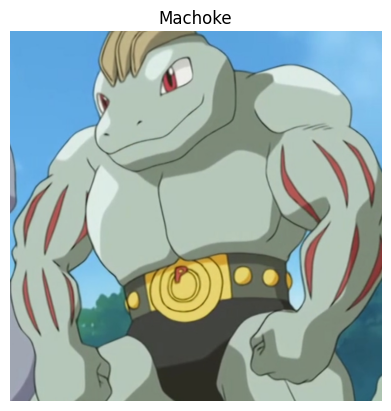


----------
The Pokemon Evolution is:  ['Nidoran, Nidorino, Nidoking']
The Pokemon Type is:  ['Poison']
Predicted class: Nidoking


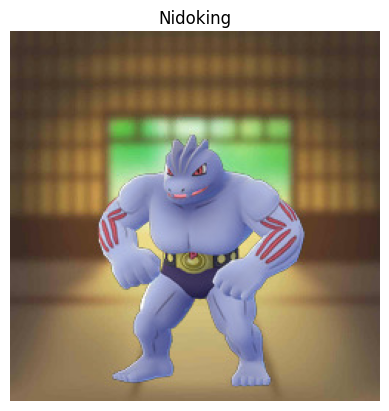


----------
The Pokemon Evolution is:  ['Machamp, Machop, Machoke']
The Pokemon Type is:  ['Fighting']
Predicted class: Machoke


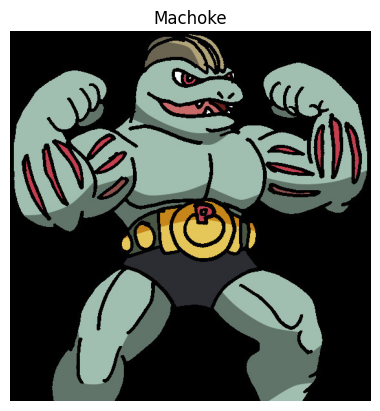


----------
The Pokemon Evolution is:  ['Machamp, Machop, Machoke']
The Pokemon Type is:  ['Fighting']
Predicted class: Machoke


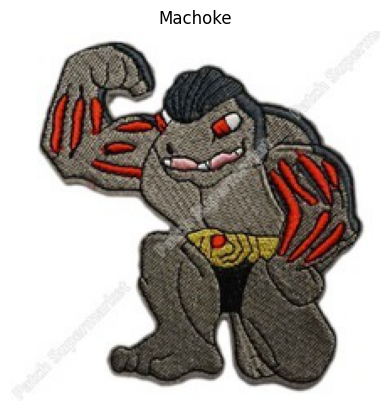


----------
The Pokemon Evolution is:  ['Machamp, Machop, Machoke']
The Pokemon Type is:  ['Fighting']
Predicted class: Machoke


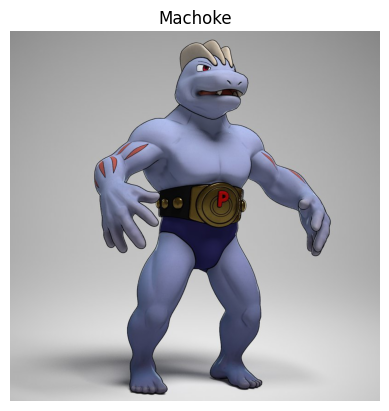


----------
The Pokemon Evolution is:  ['Grimer , Muk']
The Pokemon Type is:  ['Poison']
Predicted class: Muk


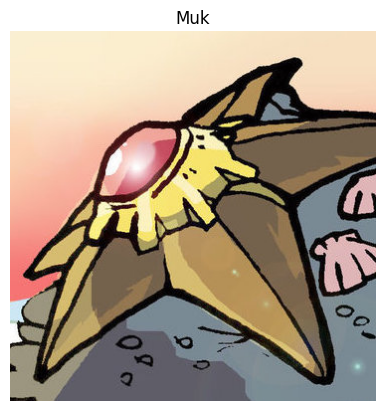


----------
The Pokemon Evolution is:  ['Staryu, Starmie']
The Pokemon Type is:  ['Water']
Predicted class: Staryu


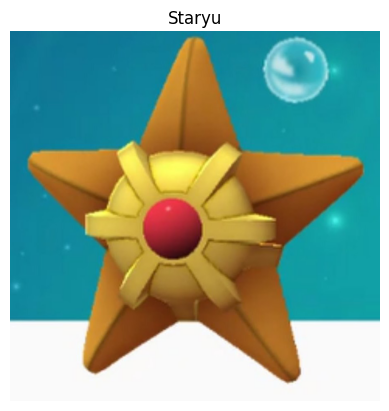


----------
The Pokemon Evolution is:  ['Staryu, Starmie']
The Pokemon Type is:  ['Water, Psychic']
Predicted class: Starmie


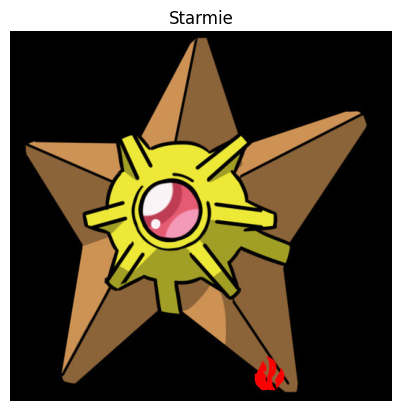


----------
The Pokemon Evolution is:  ['Staryu, Starmie']
The Pokemon Type is:  ['Water']
Predicted class: Staryu


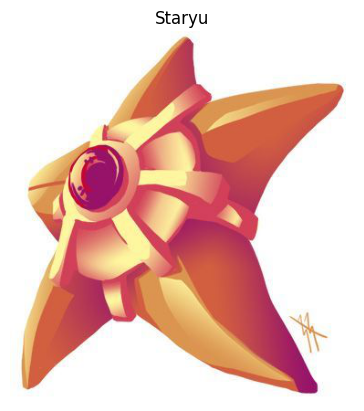


----------
The Pokemon Evolution is:  ['Staryu, Starmie']
The Pokemon Type is:  ['Water']
Predicted class: Staryu


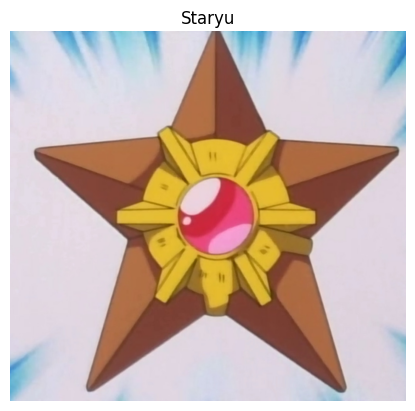


----------
The Pokemon Evolution is:  ['Pidgey, Pidgeotto, Pidgeot']
The Pokemon Type is:  ['Normal, Flying']
Predicted class: Pidgey


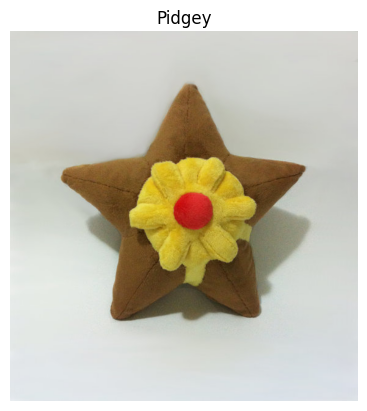


----------
The Pokemon Evolution is:  ['Staryu, Starmie']
The Pokemon Type is:  ['Water']
Predicted class: Staryu


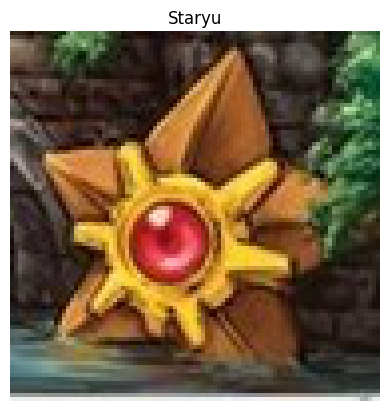


----------
The Pokemon Evolution is:  ['Staryu, Starmie']
The Pokemon Type is:  ['Water, Psychic']
Predicted class: Starmie


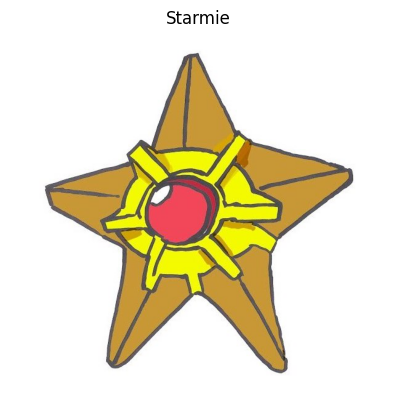


----------
The Pokemon Evolution is:  ['Arbok, Ekans']
The Pokemon Type is:  ['Poison']
Predicted class: Ekans


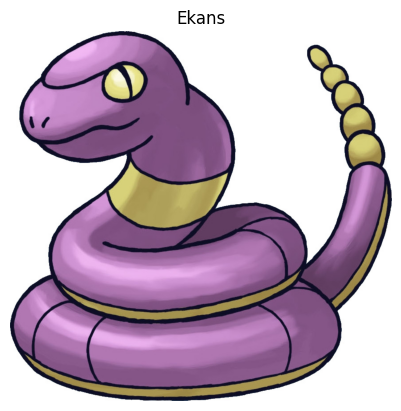


----------
The Pokemon Evolution is:  ['Poliwag, Poliwhirl, Poliwrath']
The Pokemon Type is:  ['Water']
Predicted class: Poliwag


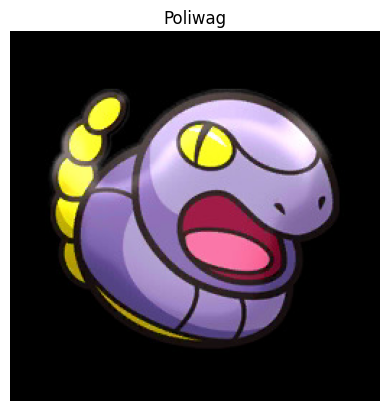


----------
The Pokemon Evolution is:  ['Arbok, Ekans']
The Pokemon Type is:  ['Poison']
Predicted class: Ekans


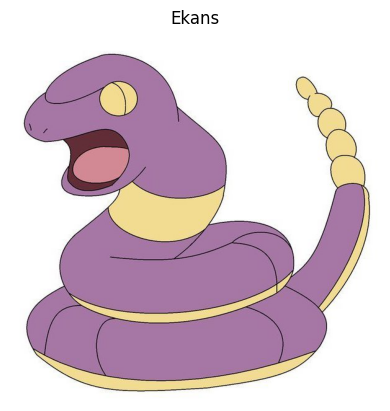


----------
The Pokemon Evolution is:  ['Arbok, Ekans']
The Pokemon Type is:  ['Poison']
Predicted class: Ekans


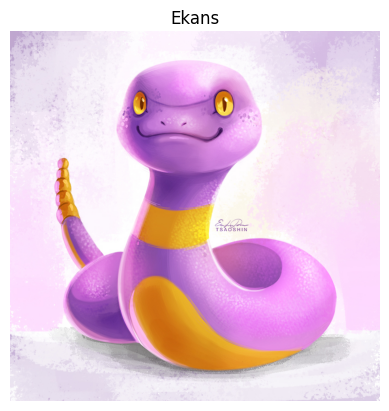


----------
The Pokemon Evolution is:  ['Weedle, Kakuna, Beedrill']
The Pokemon Type is:  ['Bug, Poison']
Predicted class: Beedrill


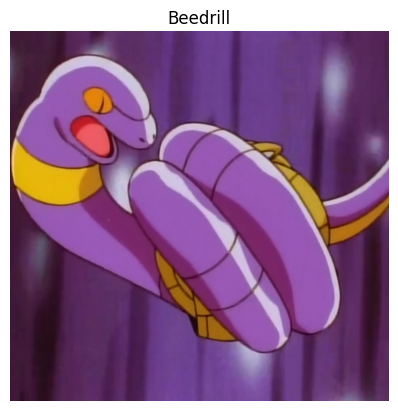


----------
The Pokemon Evolution is:  ['Zubat, Golbat, Crobat']
The Pokemon Type is:  ['Psychic']
Predicted class: Zubat


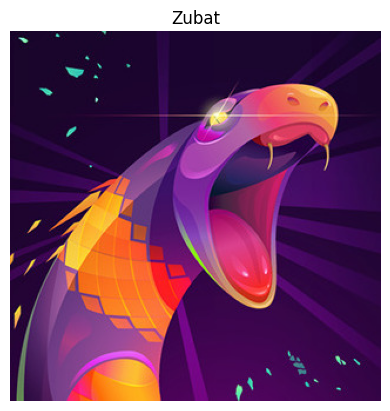


----------
The Pokemon Evolution is:  ['Abra, Kadabra, Alakazam']
The Pokemon Type is:  ['Psychic']
Predicted class: Kadabra


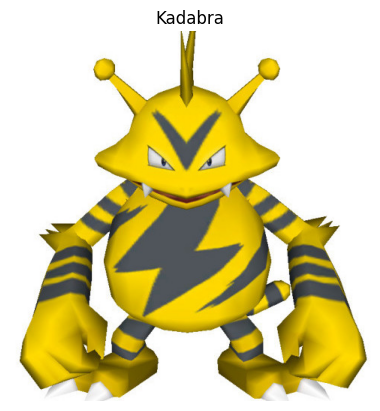


----------
The Pokemon Evolution is:  ['Electabuzz']
The Pokemon Type is:  ['Electric']
Predicted class: Electabuzz


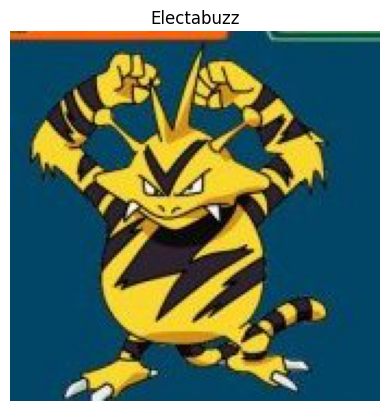


----------
The Pokemon Evolution is:  ['Abra, Kadabra, Alakazam']
The Pokemon Type is:  ['Psychic']
Predicted class: Kadabra


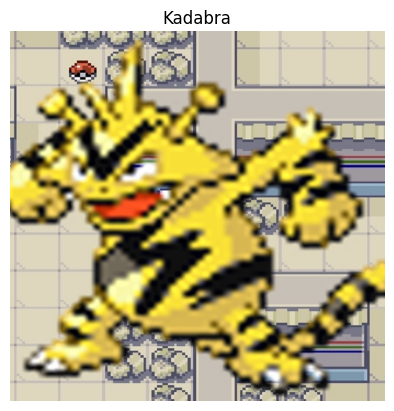


----------
The Pokemon Evolution is:  ['Abra, Kadabra, Alakazam']
The Pokemon Type is:  ['Psychic']
Predicted class: Kadabra


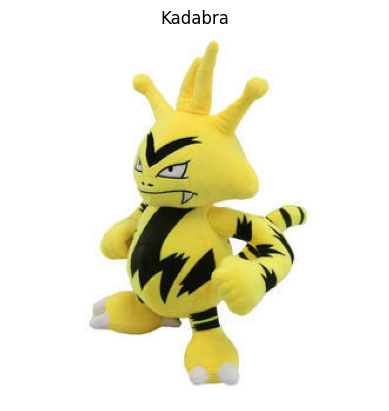


----------
The Pokemon Evolution is:  ['Electabuzz']
The Pokemon Type is:  ['Electric']
Predicted class: Electabuzz


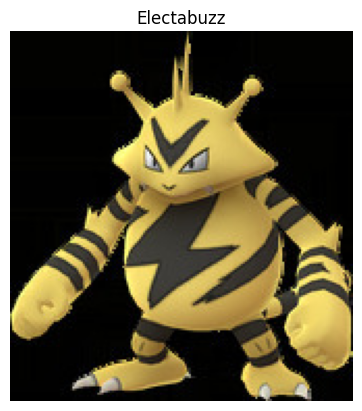


----------
The Pokemon Evolution is:  ['Electabuzz']
The Pokemon Type is:  ['Electric']
Predicted class: Electabuzz


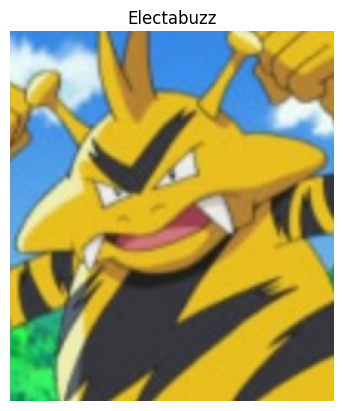


----------
The Pokemon Evolution is:  ['Electabuzz']
The Pokemon Type is:  ['Electric']
Predicted class: Electabuzz


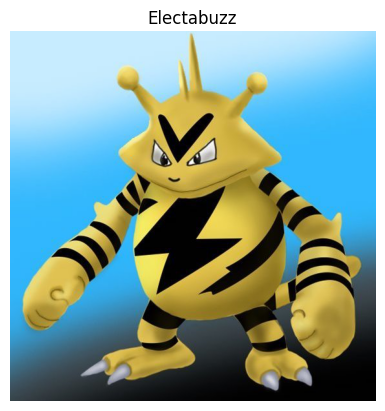


----------
The Pokemon Evolution is:  ['Arbok, Ekans']
The Pokemon Type is:  ['Poison']
Predicted class: Arbok


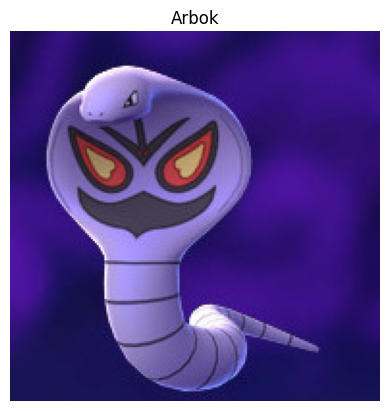


----------
The Pokemon Evolution is:  ['Arbok, Ekans']
The Pokemon Type is:  ['Poison']
Predicted class: Arbok


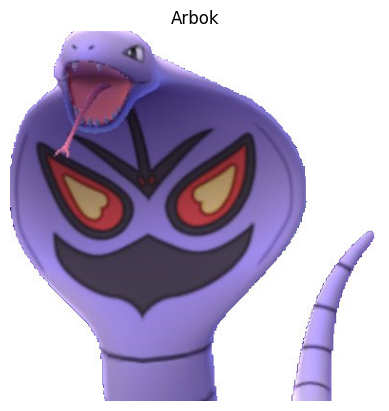


----------
The Pokemon Evolution is:  ['Hitmonchan, Hitmonlee']
The Pokemon Type is:  ['Fighting']
Predicted class: Hitmonlee


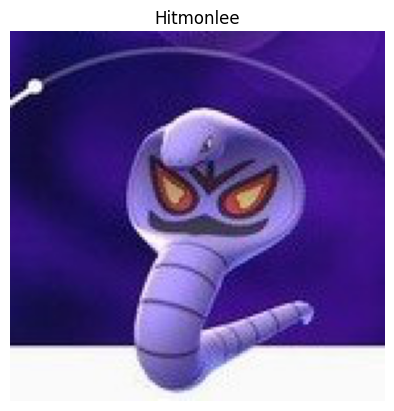


----------
The Pokemon Evolution is:  ['Arbok, Ekans']
The Pokemon Type is:  ['Poison']
Predicted class: Arbok


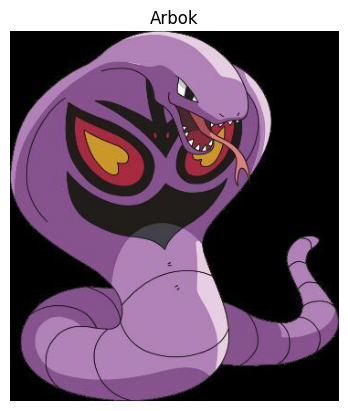


----------
The Pokemon Evolution is:  ['Arbok, Ekans']
The Pokemon Type is:  ['Poison']
Predicted class: Arbok


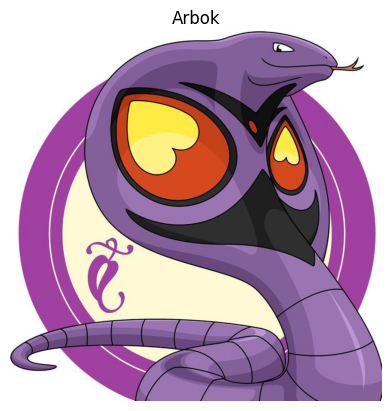


----------
The Pokemon Evolution is:  ['Arbok, Ekans']
The Pokemon Type is:  ['Poison']
Predicted class: Arbok


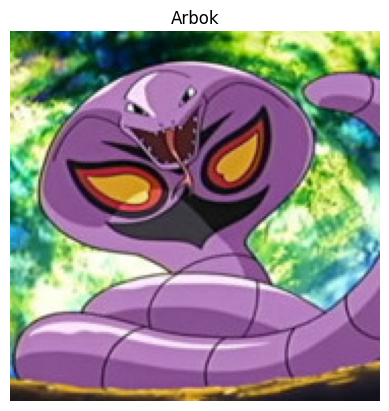


----------
The Pokemon Evolution is:  ['Rhyhorn, Rhydon, Rhyperior']
The Pokemon Type is:  ['Ground, Rock']
Predicted class: Rhydon


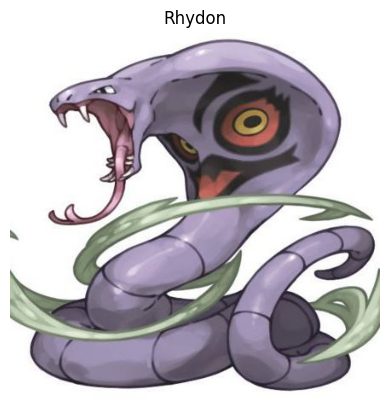


----------
The Pokemon Evolution is:  ['Squirtle, Blastoise, Wartortle']
The Pokemon Type is:  ['Water']
Predicted class: Squirtle


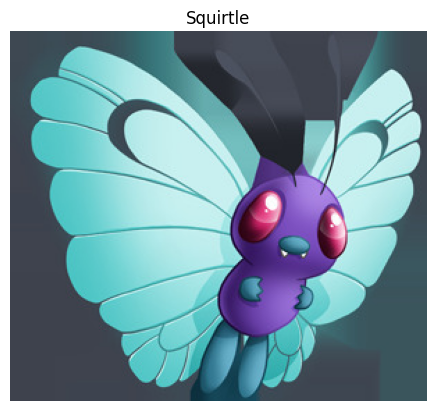


----------
The Pokemon Evolution is:  ['Butterfree, Caterpie, Metapod']
The Pokemon Type is:  ['Bug, Flying']
Predicted class: Butterfree


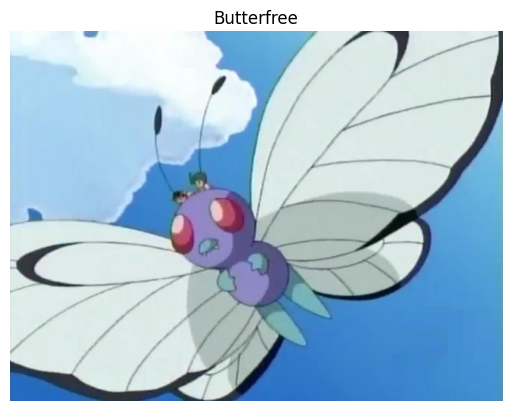


----------
The Pokemon Evolution is:  ['Butterfree, Caterpie, Metapod']
The Pokemon Type is:  ['Bug, Flying']
Predicted class: Butterfree


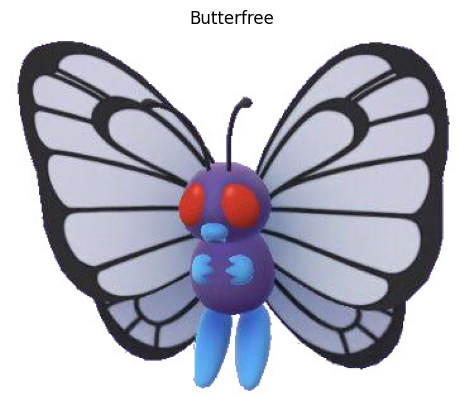


----------
The Pokemon Evolution is:  ['Butterfree, Caterpie, Metapod']
The Pokemon Type is:  ['Bug, Flying']
Predicted class: Butterfree


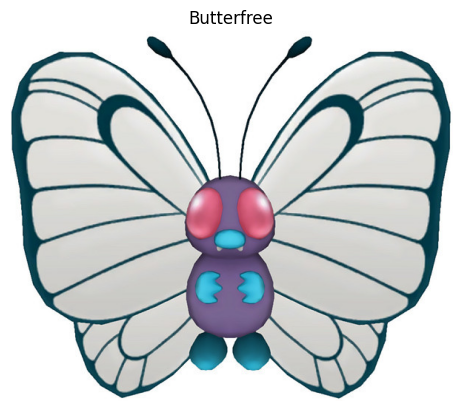


----------
The Pokemon Evolution is:  ['Butterfree, Caterpie, Metapod']
The Pokemon Type is:  ['Bug, Flying']
Predicted class: Butterfree


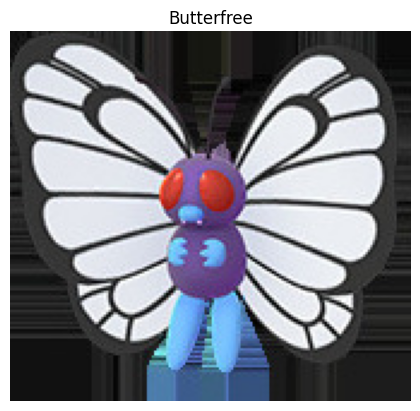


----------
The Pokemon Evolution is:  ['Geodude, Graveler, Golem']
The Pokemon Type is:  ['Rock, Ground']
Predicted class: Graveler


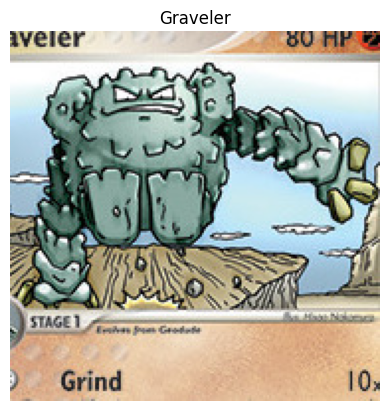


----------
The Pokemon Evolution is:  ['Goldeen, Seaking']
The Pokemon Type is:  ['Water']
Predicted class: Goldeen


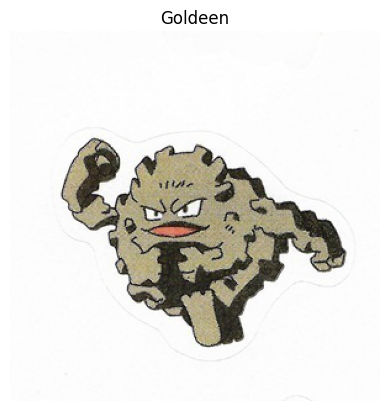


----------
The Pokemon Evolution is:  ['Geodude, Graveler, Golem']
The Pokemon Type is:  ['Rock, Ground']
Predicted class: Graveler


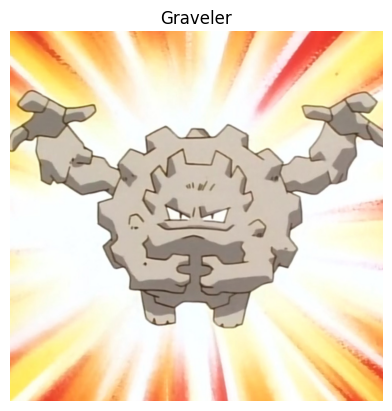


----------
The Pokemon Evolution is:  ['Geodude, Graveler, Golem']
The Pokemon Type is:  ['Rock, Ground']
Predicted class: Graveler


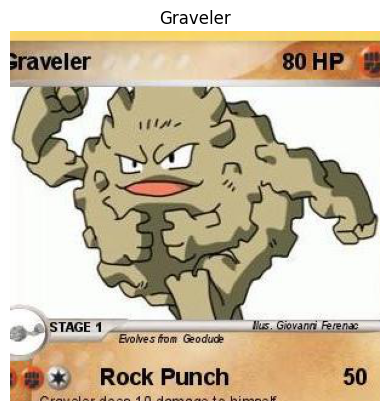


----------
The Pokemon Evolution is:  ['Geodude, Graveler, Golem']
The Pokemon Type is:  ['Rock, Ground']
Predicted class: Graveler


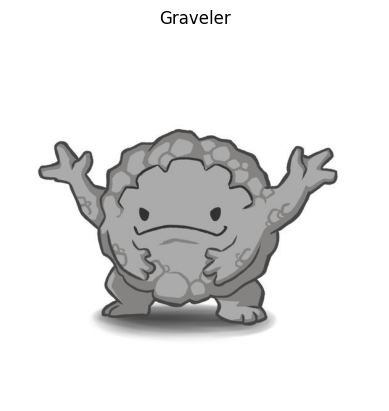


----------
The Pokemon Evolution is:  ['Voltorb, Venomoth']
The Pokemon Type is:  ['Bug, Poison']
Predicted class: Venomoth


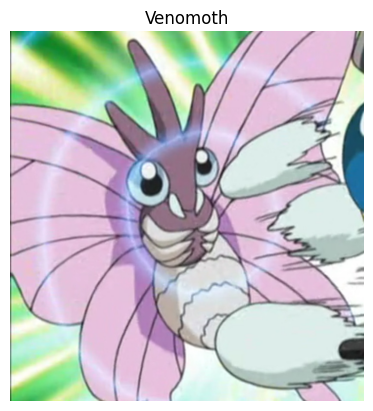


----------
The Pokemon Evolution is:  ['Voltorb, Venomoth']
The Pokemon Type is:  ['Bug, Poison']
Predicted class: Venomoth


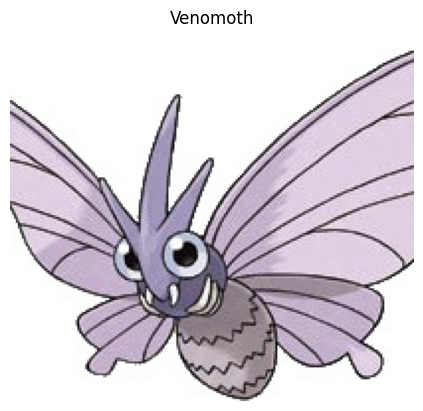


----------
The Pokemon Evolution is:  ['Voltorb, Venomoth']
The Pokemon Type is:  ['Bug, Poison']
Predicted class: Venomoth


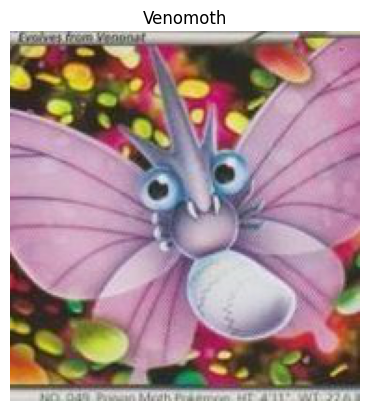


----------
The Pokemon Evolution is:  ['Voltorb, Venomoth']
The Pokemon Type is:  ['Bug, Poison']
Predicted class: Venomoth


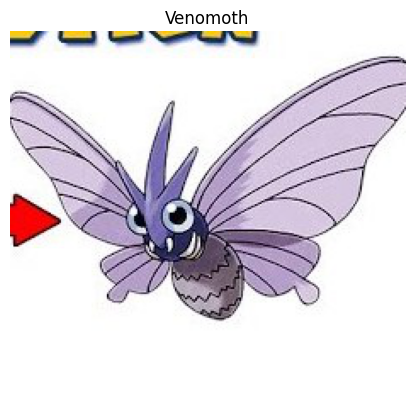


----------
The Pokemon Evolution is:  ['Voltorb, Venomoth']
The Pokemon Type is:  ['Bug, Poison']
Predicted class: Venomoth


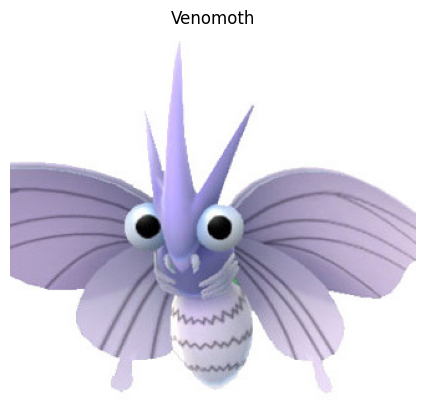


----------
The Pokemon Evolution is:  ['Scyther, Scizor, Kleavor']
The Pokemon Type is:  ['Bug, Flying']
Predicted class: Scyther


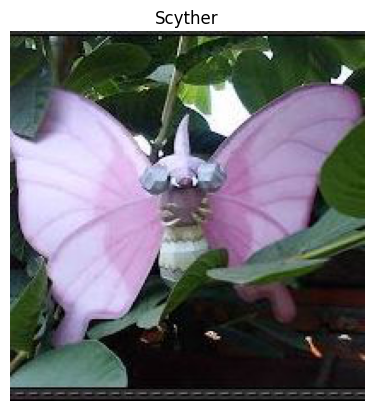


----------
The Pokemon Evolution is:  ['Voltorb, Venomoth']
The Pokemon Type is:  ['Bug, Poison']
Predicted class: Venomoth


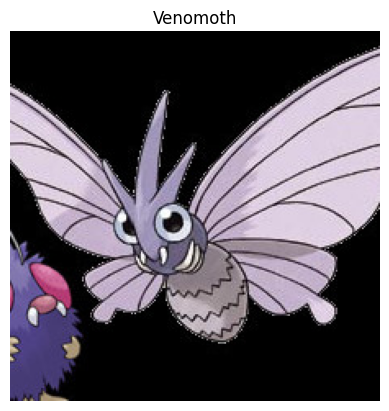


----------
The Pokemon Evolution is:  ['Voltorb, Venomoth']
The Pokemon Type is:  ['Bug, Poison']
Predicted class: Venomoth


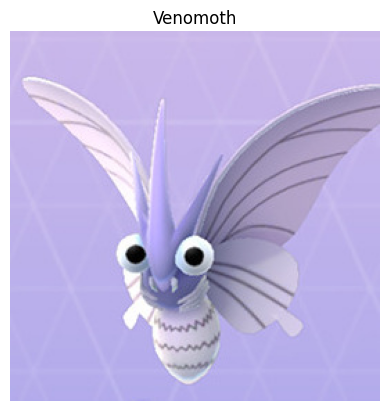


----------
The Pokemon Evolution is:  ['Mankey, Primeape']
The Pokemon Type is:  ['Fighting']
Predicted class: Mankey


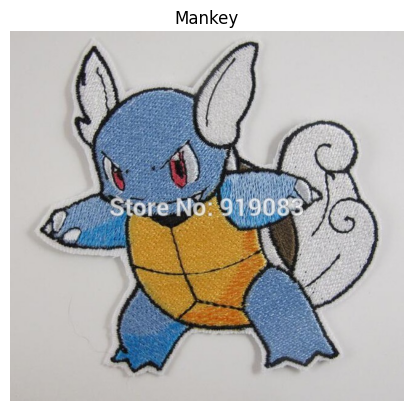


----------
The Pokemon Evolution is:  ['Squirtle, Blastoise, Wartortle']
The Pokemon Type is:  ['Water']
Predicted class: Wartortle


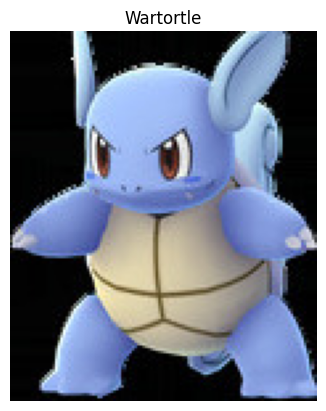


----------
The Pokemon Evolution is:  ['Squirtle, Blastoise, Wartortle']
The Pokemon Type is:  ['Water']
Predicted class: Wartortle


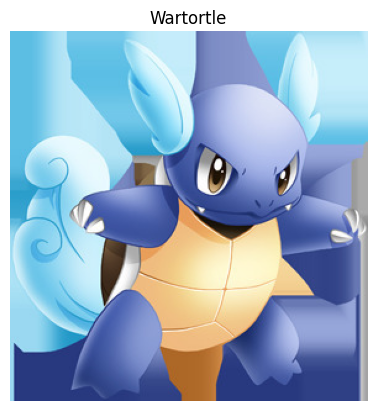


----------
The Pokemon Evolution is:  ['Squirtle, Blastoise, Wartortle']
The Pokemon Type is:  ['Water']
Predicted class: Wartortle


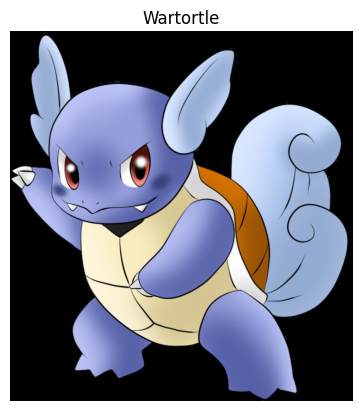


----------
The Pokemon Evolution is:  ['Squirtle, Blastoise, Wartortle']
The Pokemon Type is:  ['Water']
Predicted class: Wartortle


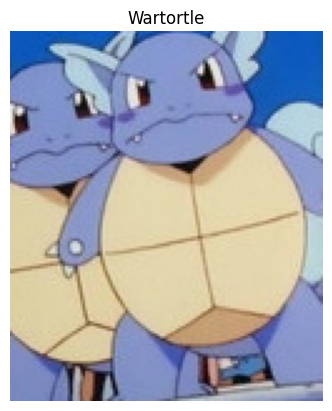


----------
The Pokemon Evolution is:  ['Nidorina, Nidoqueen']
The Pokemon Type is:  ['Poison']
Predicted class: Nidoqueen


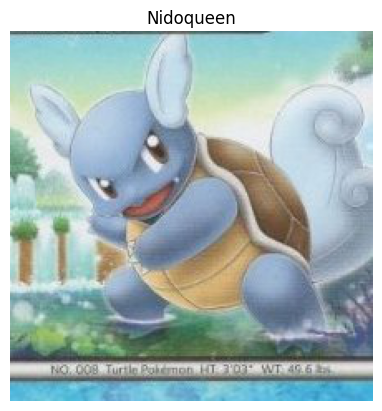


----------
The Pokemon Evolution is:  ['Arbok, Ekans']
The Pokemon Type is:  ['Poison']
Predicted class: Arbok


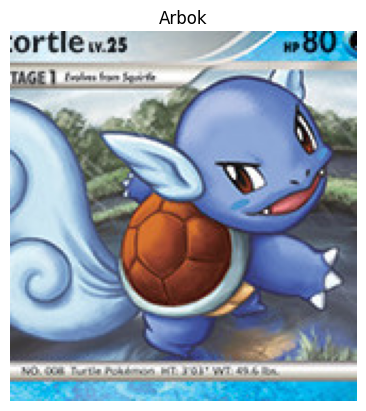


----------
The Pokemon Evolution is:  ['Weedle, Kakuna, Beedrill']
The Pokemon Type is:  ['Bug, Poison']
Predicted class: Beedrill


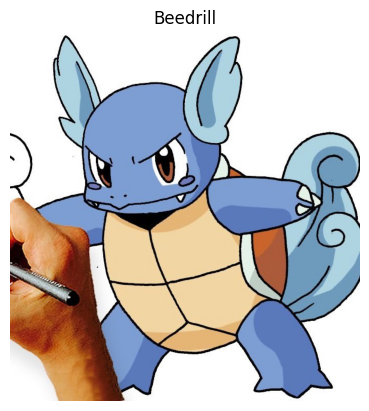


----------
The Pokemon Evolution is:  ['Clefable, Clefairy']
The Pokemon Type is:  ['Fairy']
Predicted class: Clefable


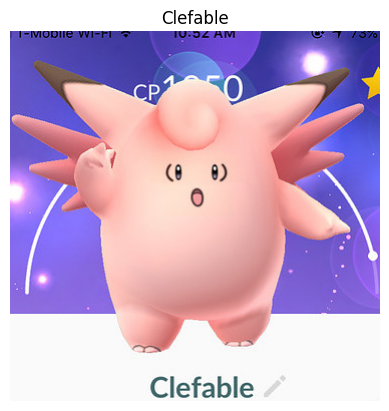


----------
The Pokemon Evolution is:  ['Clefable, Clefairy']
The Pokemon Type is:  ['Fairy']
Predicted class: Clefable


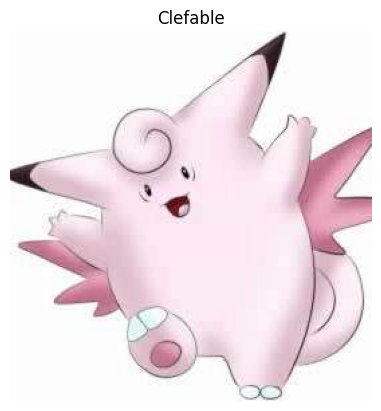


----------
The Pokemon Evolution is:  ['Clefable, Clefairy']
The Pokemon Type is:  ['Fairy']
Predicted class: Clefable


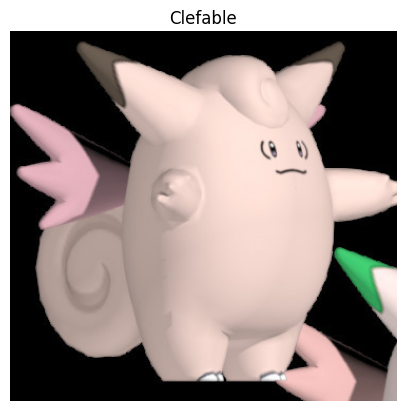


----------
The Pokemon Evolution is:  ['Igglybuff, Jigglypuff, Wigglytuff']
The Pokemon Type is:  ['Fairy']
Predicted class: Wigglytuff


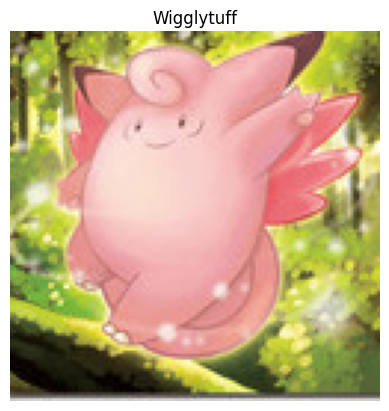


----------
The Pokemon Evolution is:  ['Clefable, Clefairy']
The Pokemon Type is:  ['Fairy']
Predicted class: Clefable


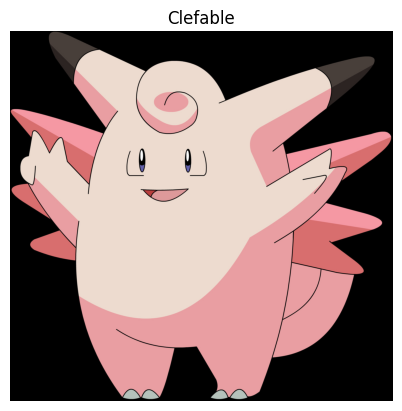


----------
The Pokemon Evolution is:  ['Clefable, Clefairy']
The Pokemon Type is:  ['Fairy']
Predicted class: Clefable


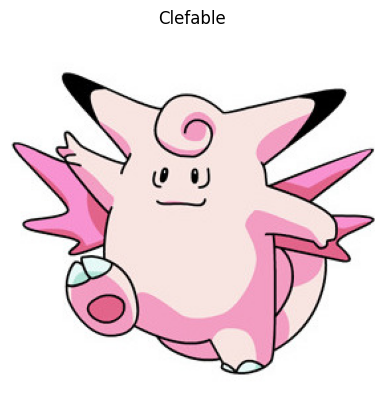


----------
The Pokemon Evolution is:  ['Magnemite, Magneton']
The Pokemon Type is:  ['Electric, Stell']
Predicted class: Magneton


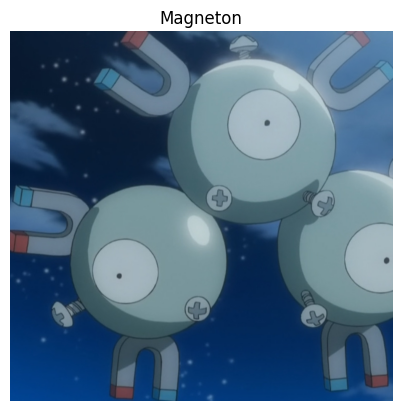


----------
The Pokemon Evolution is:  ['Machamp, Machop, Machoke']
The Pokemon Type is:  ['Fighting']
Predicted class: Machamp


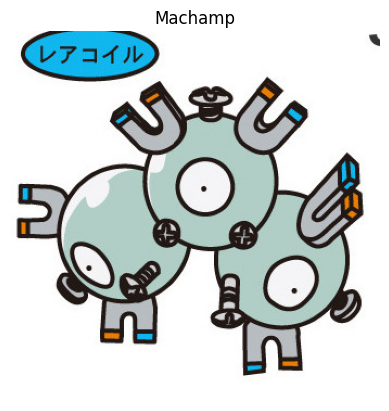


----------
The Pokemon Evolution is:  ['Magnemite, Magneton']
The Pokemon Type is:  ['Electric, Stell']
Predicted class: Magneton


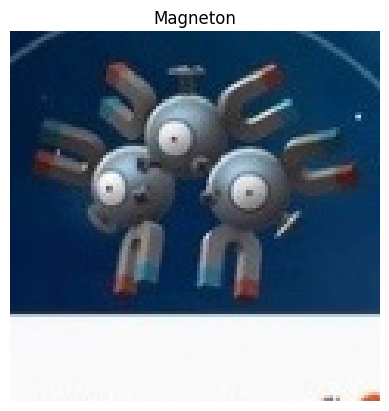


----------
The Pokemon Evolution is:  ['Magnemite, Magneton']
The Pokemon Type is:  ['Electric, Stell']
Predicted class: Magneton


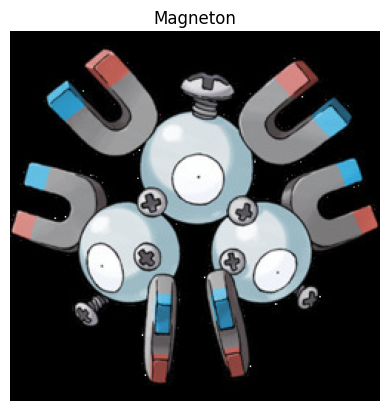


----------
The Pokemon Evolution is:  ['Magnemite, Magneton']
The Pokemon Type is:  ['Electric, Stell']
Predicted class: Magneton


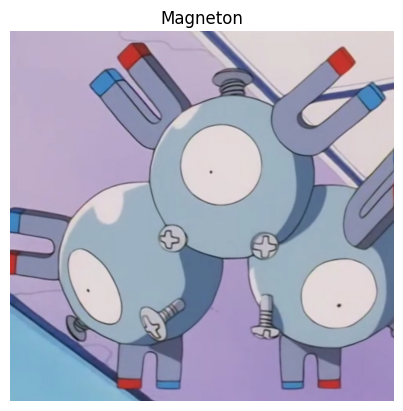


----------
The Pokemon Evolution is:  ['Magnemite, Magneton']
The Pokemon Type is:  ['Electric, Stell']
Predicted class: Magneton


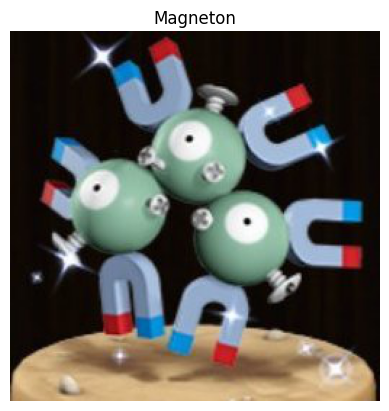


----------
The Pokemon Evolution is:  ['Magnemite, Magneton']
The Pokemon Type is:  ['Electric, Stell']
Predicted class: Magneton


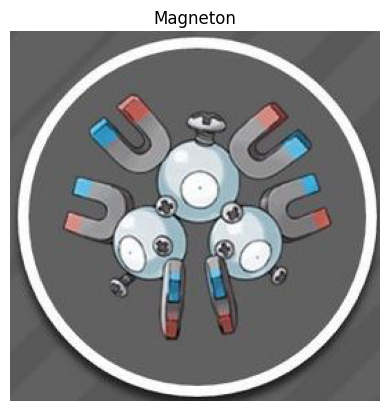


----------
The Pokemon Evolution is:  ['Munchlax, Snorlax']
The Pokemon Type is:  ['Normal']
Predicted class: Snorlax


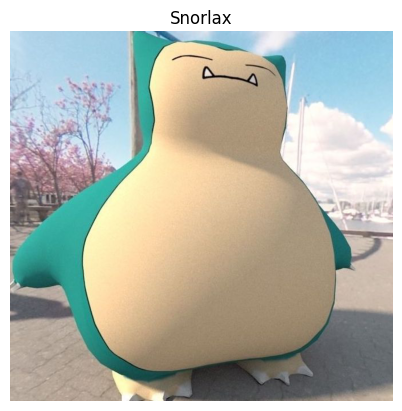


----------
The Pokemon Evolution is:  ['Munchlax, Snorlax']
The Pokemon Type is:  ['Normal']
Predicted class: Snorlax


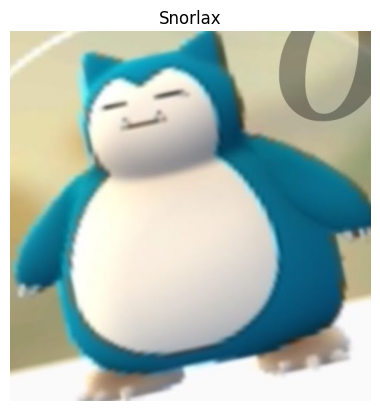


----------
The Pokemon Evolution is:  ['Munchlax, Snorlax']
The Pokemon Type is:  ['Normal']
Predicted class: Snorlax


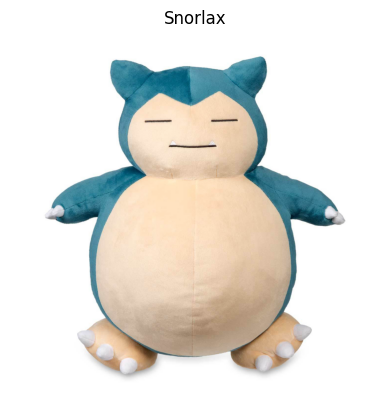


----------
The Pokemon Evolution is:  ['Munchlax, Snorlax']
The Pokemon Type is:  ['Normal']
Predicted class: Snorlax


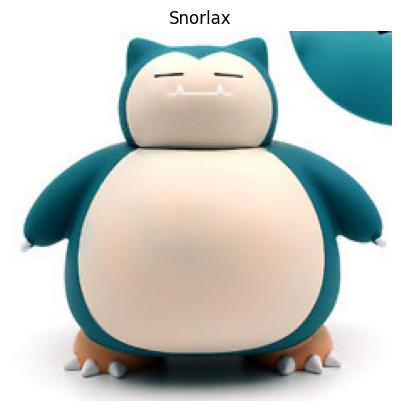


----------
The Pokemon Evolution is:  ['Munchlax, Snorlax']
The Pokemon Type is:  ['Normal']
Predicted class: Snorlax


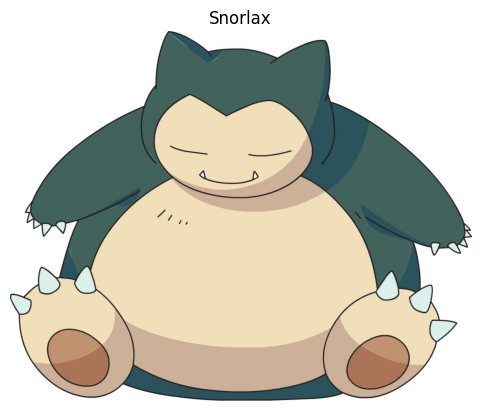


----------
The Pokemon Evolution is:  ['Munchlax, Snorlax']
The Pokemon Type is:  ['Normal']
Predicted class: Snorlax


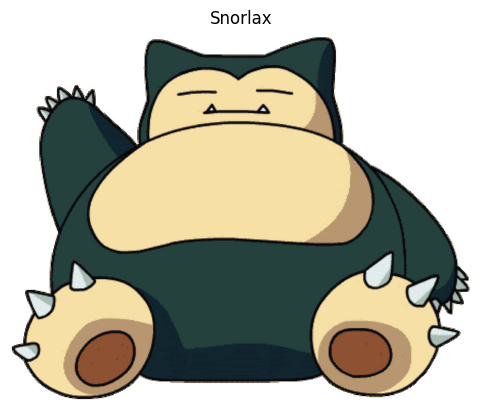


----------
The Pokemon Evolution is:  ['Spearow, Fearow']
The Pokemon Type is:  ['Normal, Flying']
Predicted class: Fearow


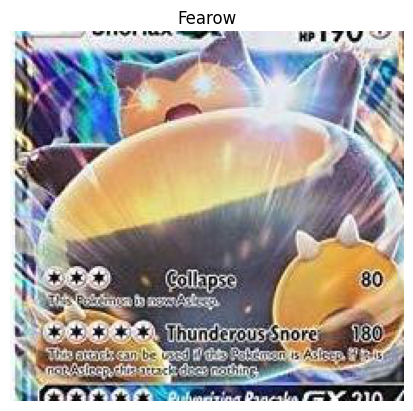


----------
The Pokemon Evolution is:  ['Slowpoke, Slowbro']
The Pokemon Type is:  ['Water, Psychic']
Predicted class: Slowpoke


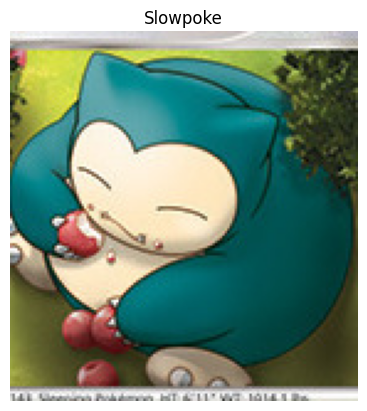


----------
The Pokemon Evolution is:  ['Vulpix, Ninetales']
The Pokemon Type is:  ['Fire']
Predicted class: Vulpix


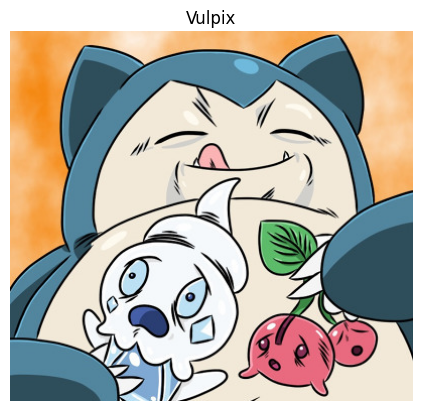


----------
The Pokemon Evolution is:  ['Voltorb, Venomoth']
The Pokemon Type is:  ['Bug, Poison']
Predicted class: Venomoth


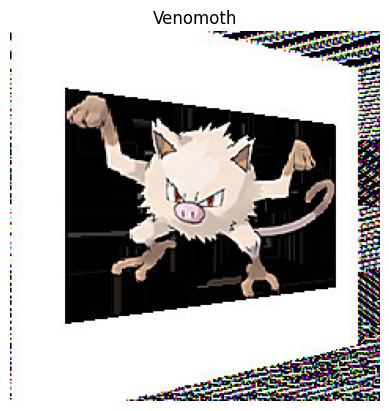


----------
The Pokemon Evolution is:  ['Mankey, Primeape']
The Pokemon Type is:  ['Fighting']
Predicted class: Mankey


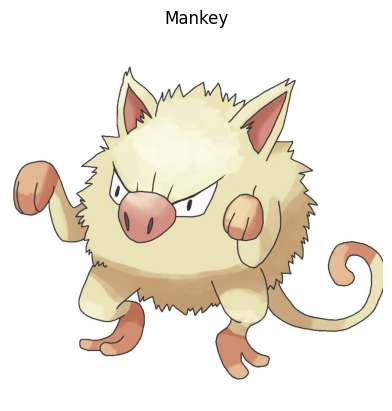


----------
The Pokemon Evolution is:  ['Cubone, Marowak']
The Pokemon Type is:  ['Ground']
Predicted class: Cubone


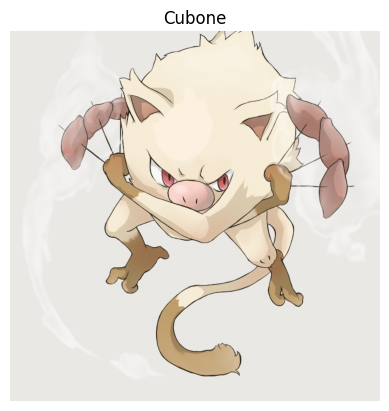


----------
The Pokemon Evolution is:  ['Mankey, Primeape']
The Pokemon Type is:  ['Fighting']
Predicted class: Mankey


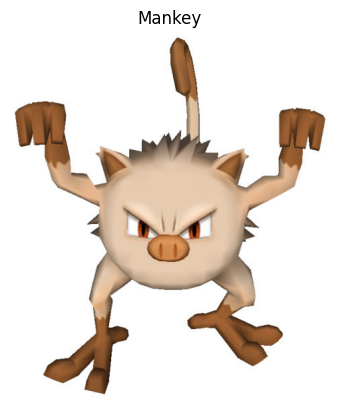


----------
The Pokemon Evolution is:  ['Hitmonchan, Hitmonlee']
The Pokemon Type is:  ['Fighting']
Predicted class: Hitmonlee


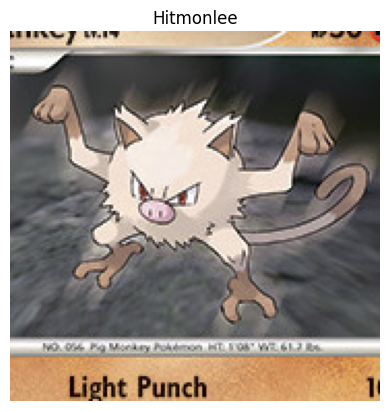


----------
The Pokemon Evolution is:  ['Exeggcute, Exeggutor']
The Pokemon Type is:  ['Grass, Psychic']
Predicted class: Exeggutor


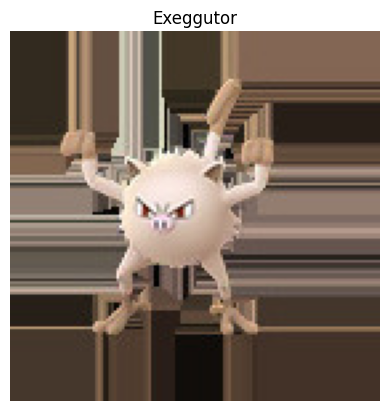


----------
The Pokemon Evolution is:  ['Koffing, Weezing']
The Pokemon Type is:  ['Poison']
Predicted class: Koffing


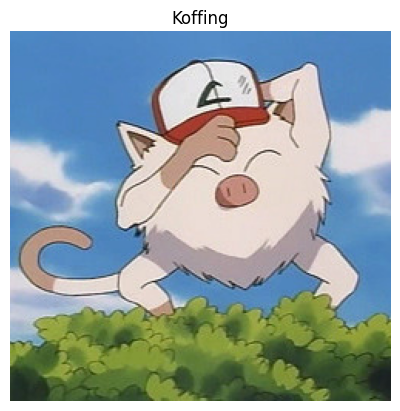


----------
The Pokemon Evolution is:  ['Kingler, Krabby']
The Pokemon Type is:  ['Water']
Predicted class: Krabby


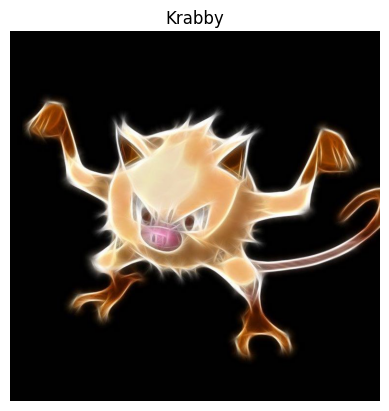


----------
The Pokemon Evolution is:  ['Clefable, Clefairy']
The Pokemon Type is:  ['Fairy']
Predicted class: Clefable


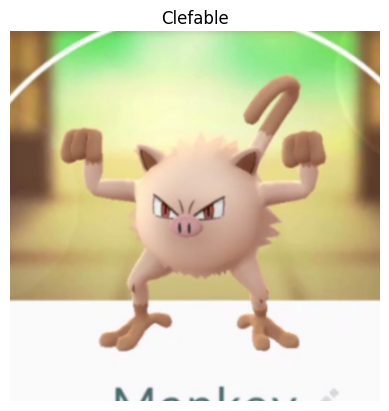


----------
The Pokemon Evolution is:  ['Cubone, Marowak']
The Pokemon Type is:  ['Ground']
Predicted class: Marowak


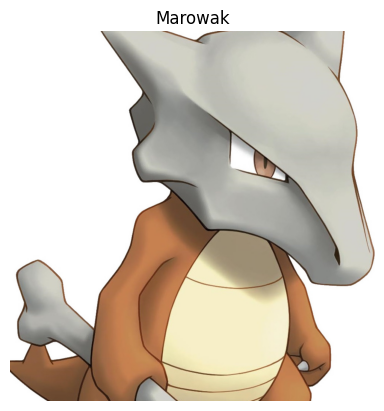


----------
The Pokemon Evolution is:  ['Cubone, Marowak']
The Pokemon Type is:  ['Ground']
Predicted class: Marowak


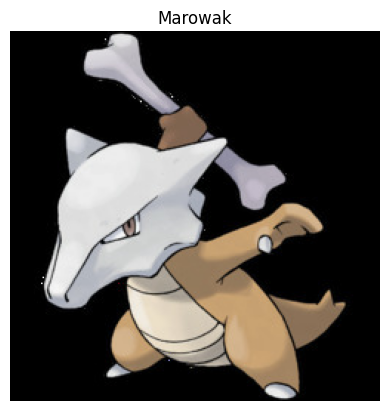


----------
The Pokemon Evolution is:  ['Cubone, Marowak']
The Pokemon Type is:  ['Ground']
Predicted class: Cubone


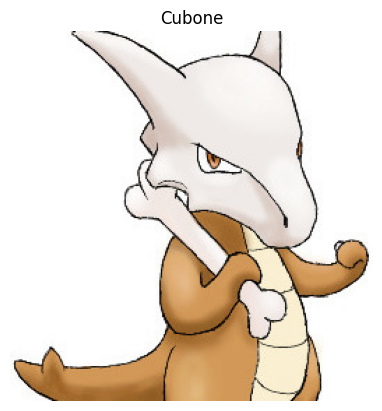


----------
The Pokemon Evolution is:  ['Cubone, Marowak']
The Pokemon Type is:  ['Ground']
Predicted class: Cubone


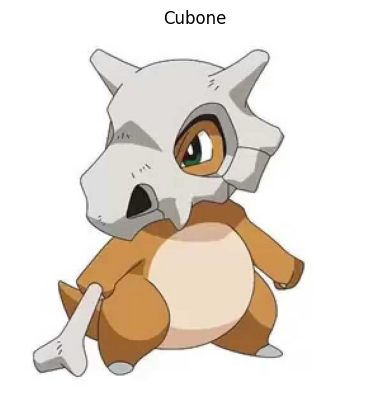


----------
The Pokemon Evolution is:  ['Cubone, Marowak']
The Pokemon Type is:  ['Ground']
Predicted class: Cubone


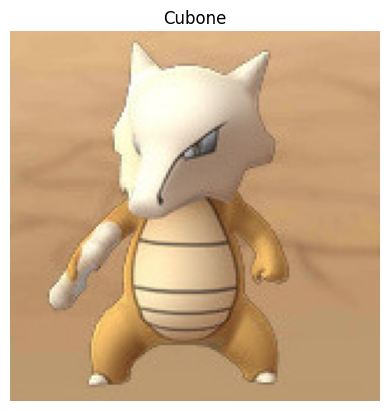


----------
The Pokemon Evolution is:  ['Butterfree, Caterpie, Metapod']
The Pokemon Type is:  ['Bug, Flying']
Predicted class: Metapod


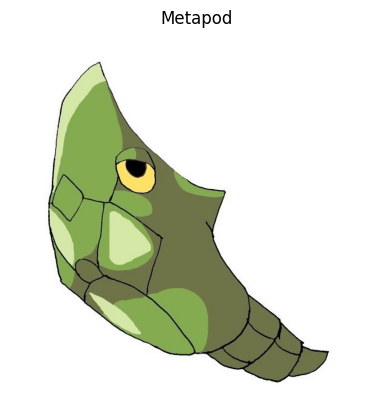


----------
The Pokemon Evolution is:  ['Butterfree, Caterpie, Metapod']
The Pokemon Type is:  ['Bug, Flying']
Predicted class: Metapod


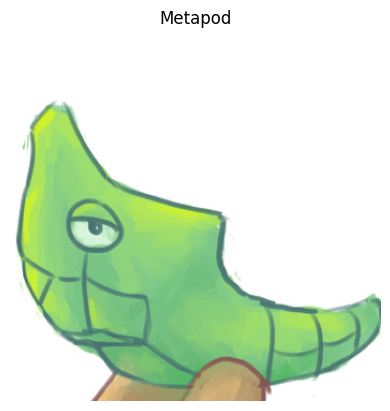


----------
The Pokemon Evolution is:  ['Butterfree, Caterpie, Metapod']
The Pokemon Type is:  ['Bug, Flying']
Predicted class: Metapod


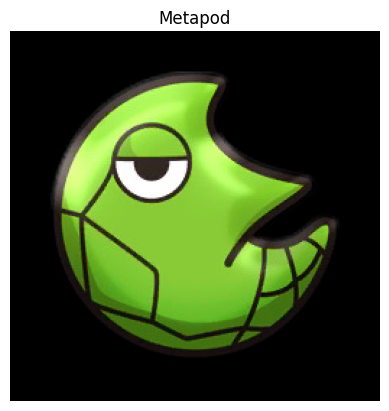


----------
The Pokemon Evolution is:  ['Butterfree, Caterpie, Metapod']
The Pokemon Type is:  ['Bug, Flying']
Predicted class: Metapod


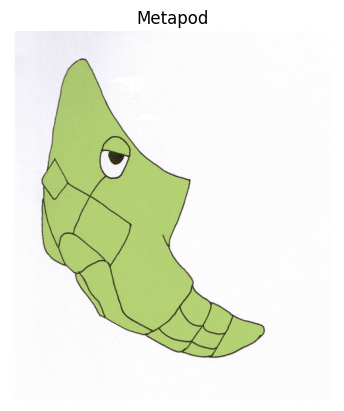


----------
The Pokemon Evolution is:  ['Butterfree, Caterpie, Metapod']
The Pokemon Type is:  ['Bug, Flying']
Predicted class: Metapod


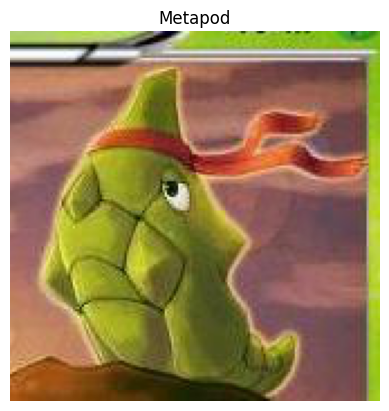


----------
The Pokemon Evolution is:  ['Butterfree, Caterpie, Metapod']
The Pokemon Type is:  ['Bug, Flying']
Predicted class: Metapod


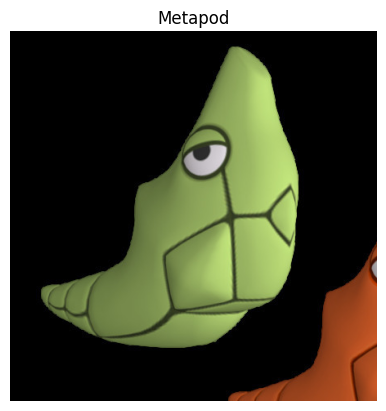


----------
The Pokemon Evolution is:  ['Butterfree, Caterpie, Metapod']
The Pokemon Type is:  ['Bug, Flying']
Predicted class: Metapod


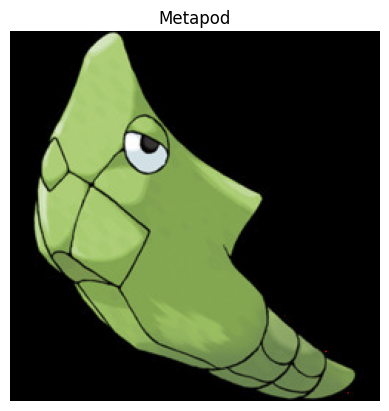


----------
The Pokemon Evolution is:  ['Butterfree, Caterpie, Metapod']
The Pokemon Type is:  ['Bug, Flying']
Predicted class: Metapod


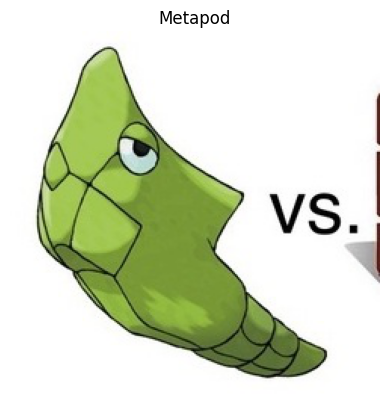


----------
The Pokemon Evolution is:  ['Charizard, Charmander, Charmeleon']
The Pokemon Type is:  ['Fire, Dragon']
Predicted class: Charmander


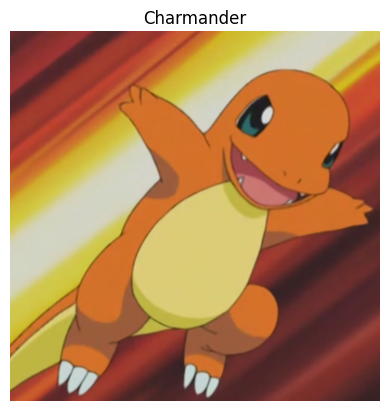


----------
The Pokemon Evolution is:  ['Charizard, Charmander, Charmeleon']
The Pokemon Type is:  ['Fire, Dragon']
Predicted class: Charmander


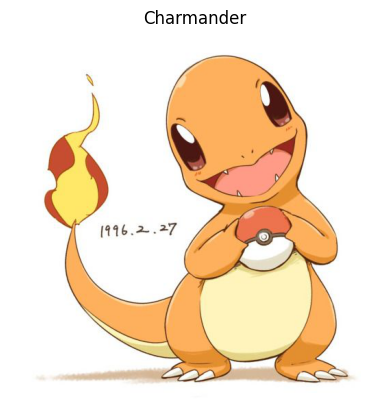


----------
The Pokemon Evolution is:  ['Charizard, Charmander, Charmeleon']
The Pokemon Type is:  ['Fire, Dragon']
Predicted class: Charmander


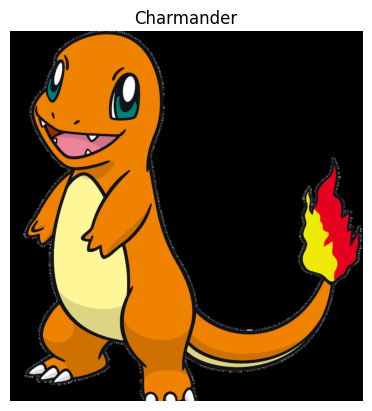


----------
The Pokemon Evolution is:  ['Charizard, Charmander, Charmeleon']
The Pokemon Type is:  ['Fire, Dragon']
Predicted class: Charmander


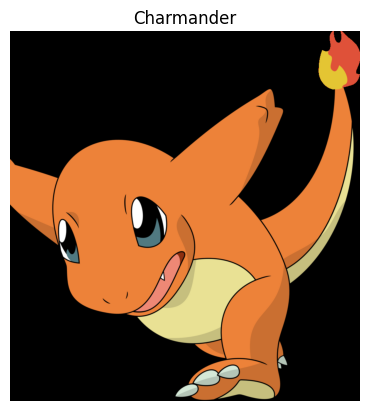


----------
The Pokemon Evolution is:  ['Bellsprout, Weepinbell, Victreebel']
The Pokemon Type is:  ['Grass, Poison']
Predicted class: Bellsprout


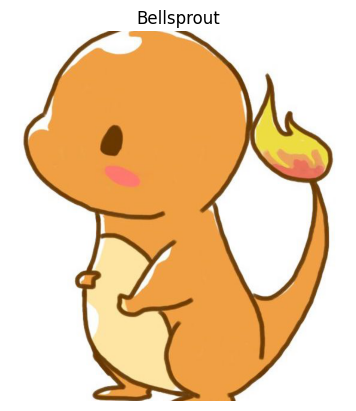


----------
The Pokemon Evolution is:  ['Diglett, Dugtrio']
The Pokemon Type is:  ['Ground, Steel']
Predicted class: Diglett


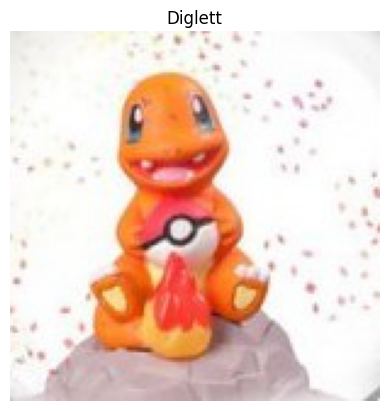


----------
The Pokemon Evolution is:  ['Squirtle, Blastoise, Wartortle']
The Pokemon Type is:  ['Water']
Predicted class: Squirtle


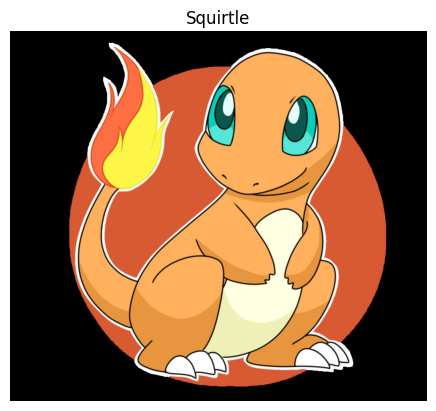


----------
The Pokemon Evolution is:  ['Weedle, Kakuna, Beedrill']
The Pokemon Type is:  ['Bug, Poison']
Predicted class: Weedle


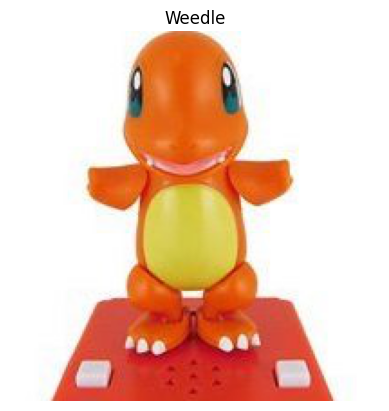


----------
The Pokemon Evolution is:  ['Dodrio, Doduo']
The Pokemon Type is:  ['Normal, Flying']
Predicted class: Dodrio


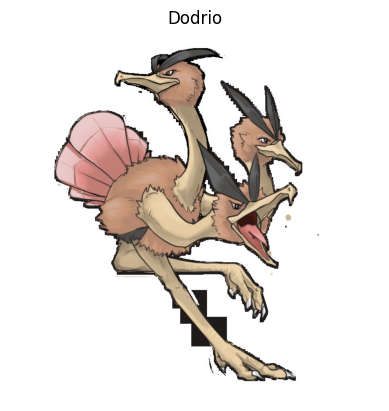


----------
The Pokemon Evolution is:  ['Mankey, Primeape']
The Pokemon Type is:  ['Fighting']
Predicted class: Primeape


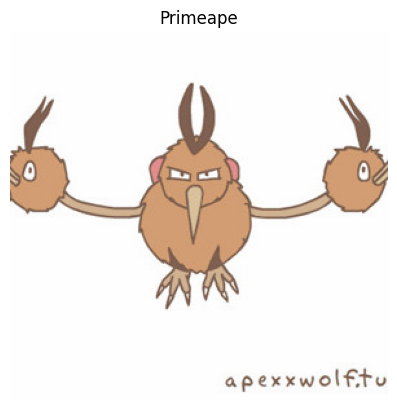


----------
The Pokemon Evolution is:  ['Dodrio, Doduo']
The Pokemon Type is:  ['Normal, Flying']
Predicted class: Dodrio


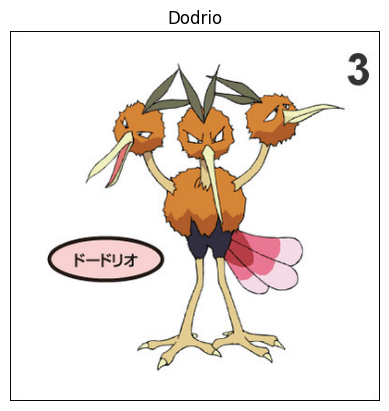


----------
The Pokemon Evolution is:  ['Bulbasaur, Ivysaur, Venusaur']
The Pokemon Type is:  ['Grass, Poison']
Predicted class: Venusaur


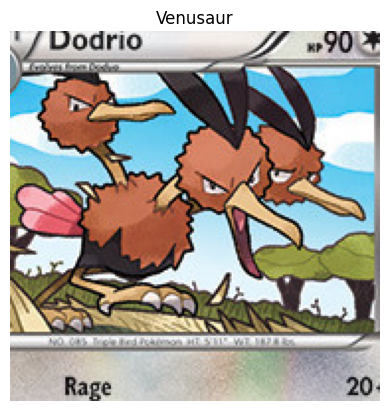


----------
The Pokemon Evolution is:  ['Dodrio, Doduo']
The Pokemon Type is:  ['Normal, Flying']
Predicted class: Dodrio


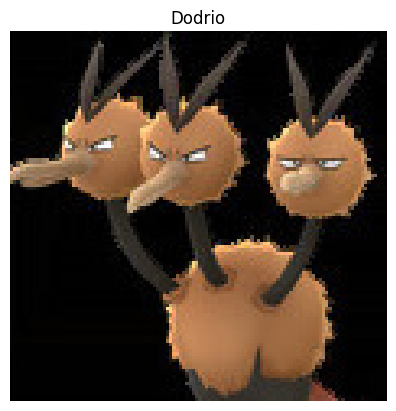


----------
The Pokemon Evolution is:  ['Dodrio, Doduo']
The Pokemon Type is:  ['Normal, Flying']
Predicted class: Dodrio


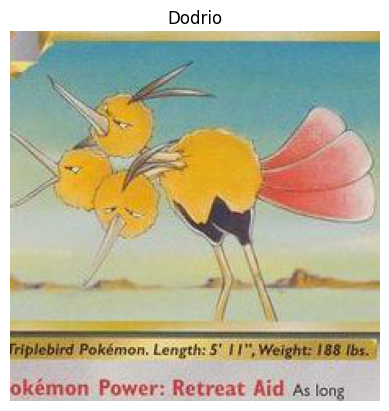


----------
The Pokemon Evolution is:  ['Bulbasaur, Ivysaur, Venusaur']
The Pokemon Type is:  ['Grass, Poison']
Predicted class: Venusaur


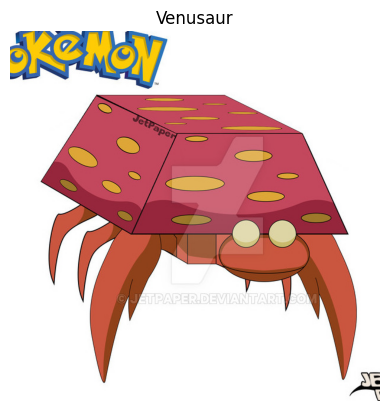


----------
The Pokemon Evolution is:  ['Paras, Parasect']
The Pokemon Type is:  ['Bug, Grass']
Predicted class: Parasect


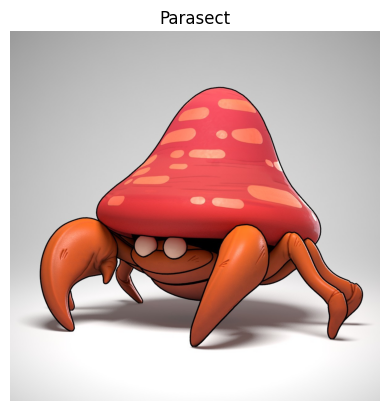


----------
The Pokemon Evolution is:  ['Paras, Parasect']
The Pokemon Type is:  ['Bug, Grass']
Predicted class: Parasect


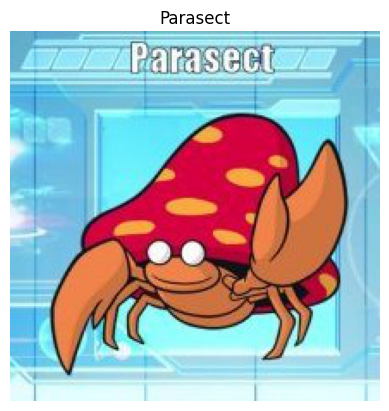


----------
The Pokemon Evolution is:  ['Bellsprout, Weepinbell, Victreebel']
The Pokemon Type is:  ['Grass, Poison']
Predicted class: Victreebel


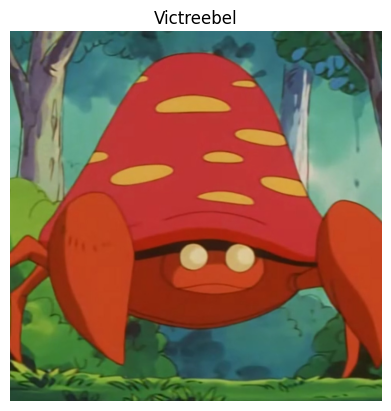


----------
The Pokemon Evolution is:  ['Golduck, Psyduck']
The Pokemon Type is:  ['Water']
Predicted class: Golduck


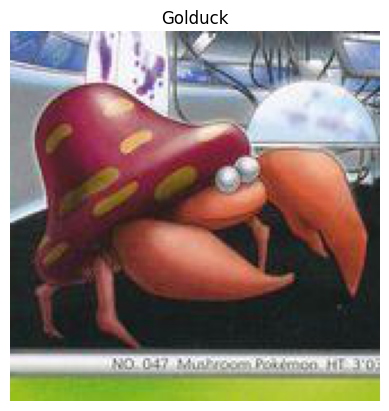


----------
The Pokemon Evolution is:  ['Paras, Parasect']
The Pokemon Type is:  ['Bug, Grass']
Predicted class: Parasect


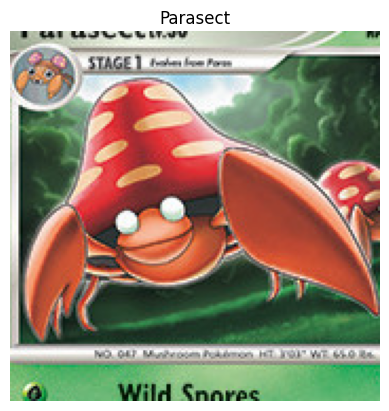


----------
The Pokemon Evolution is:  ['Paras, Parasect']
The Pokemon Type is:  ['Bug, Grass']
Predicted class: Parasect


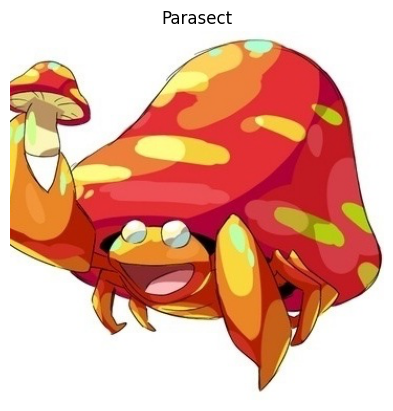


----------
The Pokemon Evolution is:  ['Lickitung']
The Pokemon Type is:  ['Normal']
Predicted class: Lickitung


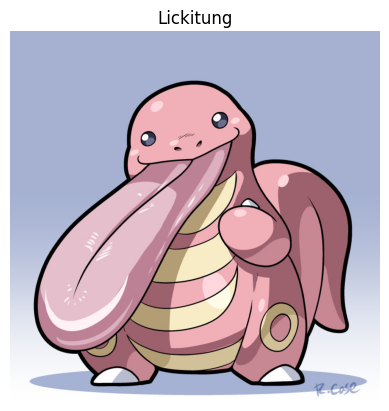


----------
The Pokemon Evolution is:  ['Paras, Parasect']
The Pokemon Type is:  ['Bug, Grass']
Predicted class: Paras


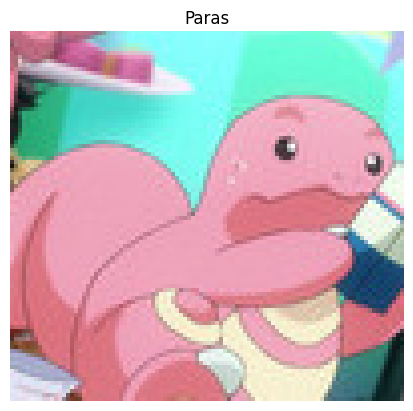


----------
The Pokemon Evolution is:  ['Lickitung']
The Pokemon Type is:  ['Normal']
Predicted class: Lickitung


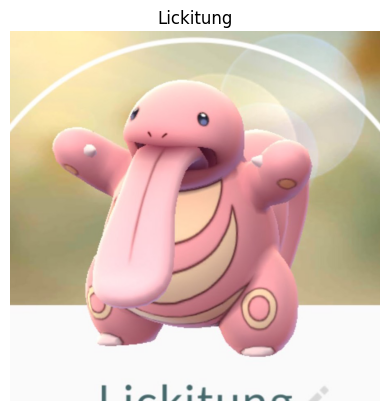


----------
The Pokemon Evolution is:  ['Lickitung']
The Pokemon Type is:  ['Normal']
Predicted class: Lickitung


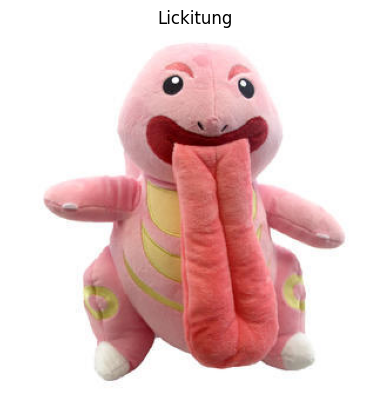


----------
The Pokemon Evolution is:  ['Sandshrew, Sandslash']
The Pokemon Type is:  ['Ground']
Predicted class: Sandslash


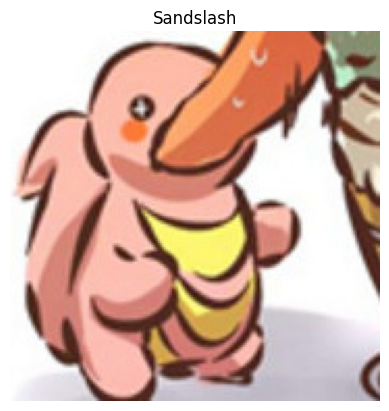


----------
The Pokemon Evolution is:  ['Weedle, Kakuna, Beedrill']
The Pokemon Type is:  ['Bug, Poison']
Predicted class: Weedle


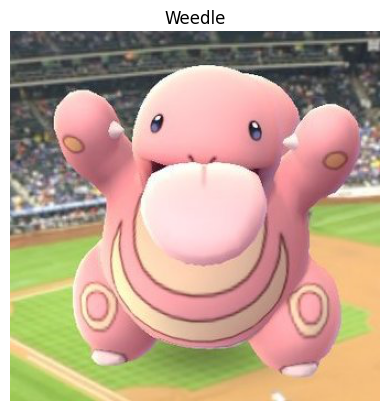


----------
The Pokemon Evolution is:  ['Nidorina, Nidoqueen']
The Pokemon Type is:  ['Psychic, Fairy']
Predicted class: MrMime


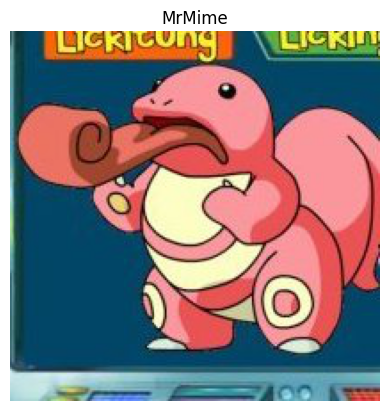


----------
The Pokemon Evolution is:  ['Lickitung']
The Pokemon Type is:  ['Normal']
Predicted class: Lickitung


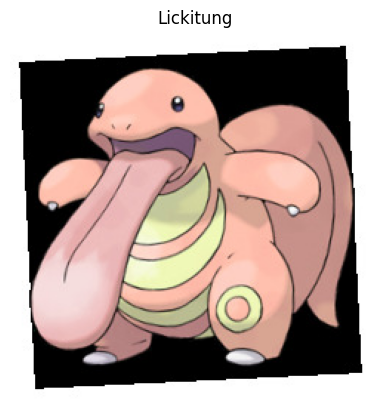


----------
The Pokemon Evolution is:  ['Goldeen, Seaking']
The Pokemon Type is:  ['Water']
Predicted class: Goldeen


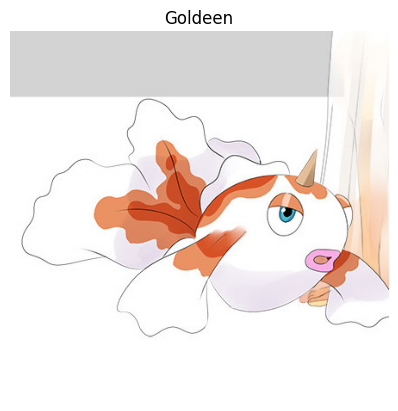


----------
The Pokemon Evolution is:  ['Goldeen, Seaking']
The Pokemon Type is:  ['Water']
Predicted class: Goldeen


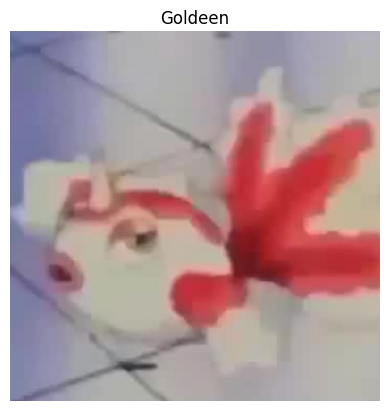


----------
The Pokemon Evolution is:  ['Nidoran, Nidorino, Nidoking']
The Pokemon Type is:  ['Poison']
Predicted class: Nidoking


In [ ]:
from PIL import Image

test_dir = "./PokemonData/test"  # Directory containing test images

transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Set the model to evaluation mode
model_ft.eval()


subdirectories = sorted([d for d in os.listdir(test_dir) if os.path.isdir(os.path.join(test_dir, d))])

# Create the dictionary with numeric order as keys and directory names as values
directory_dict = {i: directory_name for i, directory_name in enumerate(subdirectories)}
tp = 0
htp = 0
total_acc = 0
total_images = 0
# Iterate through the images in the test directory
for class_folder in os.listdir(test_dir):
    class_folder_path = os.path.join(test_dir, class_folder)
    if os.path.isdir(class_folder_path):
        images = os.listdir(class_folder_path)
        for filename in images:
          image_path = os.path.join(class_folder_path, filename)
          image = Image.open(image_path).convert("RGB")
          input_tensor = transform(image).unsqueeze(0).to(device)

          # Forward pass through the model
          with torch.no_grad():
            output = model_ft(input_tensor)

          # Get the predicted class label
          _, predicted_class = torch.max(output, 1)
          predicted_class = predicted_class.item()
          predicted_class = directory_dict[predicted_class]
          if(predicted_class == class_folder):
            tp += 1
          elif(Pokemon_dict[class_folder] in Pokemon_dict[predicted_class][0]):
            htp +=1
          total_images += 1


          if(predicted_class in Pokemon_dict ):
            print("The Pokemon Evolution is: ",Pokemon_dict[predicted_class][0])
            print("The Pokemon Type is: ",Pokemon_dict[predicted_class][1])
          else:
            print('Oops, seems this pokemon is not part of our data')

          # Print the predicted class label
          print("Predicted class:", predicted_class)
          imshow(image, title=predicted_class)
          print()
          print('-' * 10)
total_acc = tp/total_images
total_acc_2 = (tp+htp)/total_images
print('The test accuracy is: {:.4f}' .format(total_acc))
print('The test accuracy considering all pokemos evaluation as same is: {:.4f}' .format(total_acc_2))